In [18]:
%reset

Once deleted, variables cannot be recovered. Proceed (y/[n])?  y


In [20]:
# 2021/11/08 da thicknessCal2 mostra settaggi delle statistiche.

# 2021/07/30 SPIE daunctions are copied or moved to MIRO_analysis_functions
# Funzionante ripulita.
# Per campioni di oro e altri esperimenti vedere precedente versione.
#2021/06/08 versione aggiornata del lavoro originale per ICSO2020
# work for ICSO2020 with updated output and labels.
# ICSO_review last version

# 2021/07/01 some f

In [21]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [22]:
import numpy as np
import os
from matplotlib import pyplot as plt

import codecs

from pySurf.data2D_class import Data2D
from pySurf.data2D import plot_data
from dataIO.fn_add_subfix import fn_add_subfix
from pyProfile.psd import plot_psd, psd_units

import pdb

In [23]:
import os 
import numpy as np
from matplotlib import pyplot as plt
from scipy import ndimage

from pySurf.data2D_class import Data2D
from pySurf.data2D import plot_data
from dataIO.fn_add_subfix import fn_add_subfix
from pySurf.fit_cylinder import fit_cylinder, fit_cone
from pySurf.points import resample_grid, subtract_points, plot_points, points_autoresample

from pySurf.scripts.dlist import Dlist,load_dlist

from plotting.backends import maximize
from dataIO.span import span

import inspect
import warnings
import pickle
warnings.filterwarnings('once')

In [24]:
from pyProfile.profile import save_profile,crop_profile
from scipy.stats import binned_statistic
from pySurf.readers.instrumentReader import matrixdat_reader,matrixZygo_reader, matrix_reader, matrix4D_reader

In [25]:
from pySurf.readers.nid_reader import read_nid

In [26]:
pwd

'G:\\My Drive\\progetti\\pySurf\\tutorials'

In [27]:
## Le voglio spostare almeno in scripts se ancora utili.

# trucco per importare da directory superiore file di sviluppo
#import sys
#sys.path.append("..")
#from MIRO_analysis_functions import *

`outdir` is the main output folder. Results go in their subfolders according to the type (`'surface'` o `'psds'`). Data instrument is identified in output filename subfix (`'_AFM'`, `'_MFT'`,`'_CCI'`). 

`datafolder` is the data location and is defined in each cell when needed.

`outfolder` is the local filename used in each cell for output folder (typically derived by assembling `outdir` and filename).

In [28]:
%matplotlib inline

In [29]:
%matplotlib qt

In [30]:
datadic={}

In [31]:
infolder = r'G:\My Drive\progetti\c_overcoating\esperimenti\20201127_batch05_IrCr\20210423_thicknessTest'
outfolder = 'test_output'
outdir = '.' # per ora qui #r'G:\My Drive\progetti\c_overcoating\esperimenti\results\SPIE2021'  #os.path.join(datafolder,'results')

In [32]:
fl = [f for f in os.listdir(infolder) if os.path.splitext(f)[-1] == '.nid']

In [39]:
fn = os.path.join(infolder,fl[0])

In [40]:
from pySurf.readers.instrumentReader import nid_reader
d = Data2D(fn,units=['um','um','nm'],scale=[1000000.,1000000.,1000000000.],
           name=os.path.basename(fl[0]),reader=nid_reader) 
data,x,y=d()

first argument is string, use it as filename


In [45]:
from pySurf.data2D import test_get_stats,get_stats

In [55]:
test_get_stats(help=0);

load test surface, shape:  (240, 320)
no options:
 ['mean: -0.6938', 'StdDev: 0.37228', 'rms: 0.78737', 'PV: 1.822', 'min: -1.2262', 'max: 0.59577', 'n:  76800'] 
-------------

no options, string:
 ['mean: -0.6938', 'StdDev: 0.37228', 'rms: 0.78737', 'PV: 1.822', 'min: -1.2262', 'max: 0.59577', 'n:  76800'] 
-------------

-- PRESETS --
vars=1 (preset), no data:
 ['StdDev: %.5g', 'PV: %.5g'] 
-------------

vars=1, /string:
 ['rms: 0.372 ', 'PV: 1.82 '] 
-------------

vars=2, /string:
 ['mean: -0.694 ', 'PV: 0.372 ', 'rms: 1.82 ', 'nx:320', 'ny: 240'] 
-------------

vars=1, string:False
 ['rms: 0.372 ', 'PV: 1.82 '] 
-------------

-- FLAG STRING --
vars=[1,2,3]:
 ['StdDev: 0.37228', 'rms: 0.78737', 'PV: 1.822'] 
-------------

vars=[[1,2,3]]:
 ['StdDev: 0.37228', 'rms: 0.78737', 'PV: 1.822', 'StdDev: 0.012979', 'rms: 0.012979', 'PV: 0.04482', 'StdDev: 0.044293', 'rms: 0.044293', 'PV: 0.1528'] 
-------------

vars=[3]:
 ['PV: 1.822'] 
-------------

vars=[[],[2],[3]]:
 ['rms: 0.0129

c:\users\kovor\documents\python\pyxtel\pyxsurf\dataIO\arrays.py:73: UserWarning: `stats` called without data, print and returns default vars.
  warnings.warn ("`stats` called without data, print and returns default vars.")


In [56]:
get_stats(data,x,y,string=True,vars=1) #plot preset

['rms: 383 ', 'PV: 1.74e+03 ']

In [57]:
#print(get_stats(data,x,y,string=True))  #plot preset 1
print(get_stats(data,x,y,string=True,vars=1))  #plot preset
print(get_stats(data,x,y,string=True,vars=[2,6]))

print(get_stats(string=True,vars=[2,6]))
print(get_stats(data,x,y,string=True,vars=[2,6],units=['mm','m','um']))
print(get_stats(string=True,vars=[2,6],units=['mm','m','um']))
print(get_stats(string=True,vars=[[2,6],[],[1]],units='km'))
print(get_stats(string=True,vars=[[2,6],[],[1]],units=['km']))

['rms: 383 ', 'PV: 1.74e+03 ']
['rms: 2898', 'n:  65536']
['rms: %.5g', 'n:  %i']
['rms: 2898 um', 'n:  65536']
['rms: %.5g um', 'n:  %i']
['rms: %.5g km', 'n:  %i', 'StdDev: %.5g km']
['rms: %.5g km', 'n:  %i', 'StdDev: %.5g']


In [58]:
from dataIO.arrays import stats, test_stats
test_stats()

len(data):  1000
no options: all stats as float:

[0.5025027038496355, 0.2879809117071043, 0.5791735257104296, 0.9977896005736049, 0.0007599460027469807, 0.9985495465763519, 1000] 
----------


with empty vars, return empty: [] 
----------


select two stats (vars=[0,1]) [0.5025027038496355, 0.2879809117071043] 
----------


return as string (string=True), include units:
 ['rms: 0.57917 km', 'n:  1000'] 
----------


return as string (single string), that is appended to format according to default meaning: ['rms: 0.579174 A', 'size: 1000 pts'] 
----------


for finer control (e.g. more that one unit), it needs to be included in fmt) ['rms: 0.579174 A', 'N: 1000 points'] 
----------


if called without data, return a format string (units can be added, fmt is irrelevant) ['rms: %.5g um', 'n:  %i'] 
----------


without data and vars return full format string ['mean: %.5g', 'StdDev: %.5g', 'rms: %.5g', 'PV: %.5g', 'min: %.5g', 'max: %.5g', 'n:  %i'] 
----------




[0.5025027038496355,
 0.2879809117071043,
 0.5791735257104296,
 0.9977896005736049,
 0.0007599460027469807,
 0.9985495465763519,
 1000]

In [59]:
from pySurf.readers.instrumentReader import nid_reader
d = Data2D(data,x,y,units=['um','um','nm'],scale=[1000000.,1000000.,1000000000.],
           name=os.path.basename(fn),reader=nid_reader) 

In [60]:
d = Data2D(data,x,y,units=['um','um','nm'],scale=[1000000.,1000000.,1000000000.],
           name=os.path.basename(fn)) # .nid format is unambiguous, can guess reader

In [61]:
plt.figure()
d.level(axis=1).plot()

In [ ]:
from pySurf.data2D import test_get_stats

In [88]:
#print(get_stats(data,x,y,string=True))  #plot preset 1
print(get_stats(data,x,y,string=True,vars=1))  #plot preset
print(get_stats(data,x,y,string=True,vars=[2,6]))

print(get_stats(string=True,vars=[2,6]))
print(get_stats(data,x,y,string=True,vars=[2,6],units=['mm','m','um']))
print(get_stats(string=True,vars=[2,6],units=['mm','m','um']))
print(get_stats(string=True,vars=[[2,6],[],[1]],units='km'))
print(get_stats(string=True,vars=[[2,6],[],[1]],units=['km']))

['rms: 383 ', 'PV: 1.74e+03 ']
['rms: 2898', 'n:  65536']
['rms: %.5g', 'n:  %i']
['rms: 2898 um', 'n:  65536']
['rms: %.5g um', 'n:  %i']
['rms: %.5g km', 'n:  %i', 'StdDev: %.5g km']
['rms: %.5g km', 'n:  %i', 'StdDev: %.5g']


In [89]:
print(get_stats(data,x,y,string=False,vars=[[2,6],[],[1]],units='km',fmt=''))

[2897.9685488613145, 65536, 0.2898049828843099]


In [90]:
test_get_stats(help=0);

load test surface, shape:  (240, 320)
no options:
 [-0.6937998887775654, 0.3722780252351366, 0.7873685374338596, 1.8219939575195314, -1.2262238037109376, 0.5957701538085938, 76800] 
-------------

no options, string:
 ['mean: -0.6938', 'StdDev: 0.37228', 'rms: 0.78737', 'PV: 1.822', 'min: -1.2262', 'max: 0.59577', 'n:  76800'] 
-------------

-- PRESETS --
vars=1 (preset), no data:
 ['StdDev: %.5g', 'PV: %.5g'] 
-------------

vars=1, /string:
 ['rms: 0.372 ', 'PV: 1.82 '] 
-------------

vars=2, /string:
 ['mean: -0.694 ', 'PV: 0.372 ', 'rms: 1.82 ', 'nx:320', 'ny: 240'] 
-------------

vars=1, string:False
 [0.3722780252351366, 1.8219939575195314] 
-------------

-- FLAG STRING --
vars=[1,2,3]:
 ['StdDev: 0.37228', 'rms: 0.78737', 'PV: 1.822'] 
-------------

vars=[[1,2,3]]:
 ['StdDev: 0.37228', 'rms: 0.78737', 'PV: 1.822', 'StdDev: 0.012979', 'rms: 0.012979', 'PV: 0.04482', 'StdDev: 0.044293', 'rms: 0.044293', 'PV: 0.1528'] 
-------------

vars=[3]:
 ['PV: 1.822'] 
-------------

va

In [589]:
from dataIO.arrays import stats, test_stats
test_stats()

len(data):  1000
no options: all stats as float:

[0.4926839723404413, 0.2869852833353782, 0.5701737011229507, 0.9987978971489284, 0.0005195438649163719, 0.9993174410138448, 1000] 
----------


with empty vars, return empty: [] 
----------


select two stats (vars=[0,1]) [0.4926839723404413, 0.2869852833353782] 
----------


return as string (string=True), include units:
 ['rms: 0.57017 km', 'n:  1000'] 
----------


return as string (single string), that is appended to format according to default meaning: ['rms: 0.570174 A', 'size: 1000 pts'] 
----------


for finer control (e.g. more that one unit), it needs to be included in fmt) ['rms: 0.570174 A', 'N: 1000 points'] 
----------


if called without data, return a format string (units can be added, fmt is irrelevant) ['rms: %.5g um', 'n:  %i'] 
----------


without data and vars return full format string ['mean: %.5g', 'StdDev: %.5g', 'rms: %.5g', 'PV: %.5g', 'min: %.5g', 'max: %.5g', 'n:  %i'] 
----------




[0.4926839723404413,
 0.2869852833353782,
 0.5701737011229507,
 0.9987978971489284,
 0.0005195438649163719,
 0.9993174410138448,
 1000]

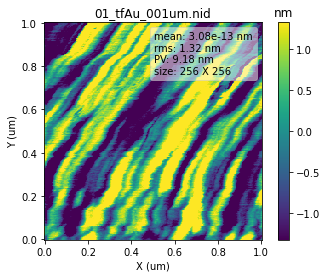

In [105]:
d.level(axis=1).plot(nsigma = 1)

In [92]:
print(d.stats(string=True,vars=[[2,6],[],[1]],units=['km']))
print(d.stats(string=False,vars=[[2,6],[],[1]],units=['km']))

['rms: 2.898e+12 km', 'n:  65536', 'StdDev: 2.898e+05']
[2897968548861.3145, 65536, 289804.9828843099]


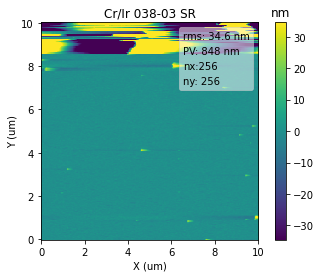

<Figure size 432x288 with 0 Axes>

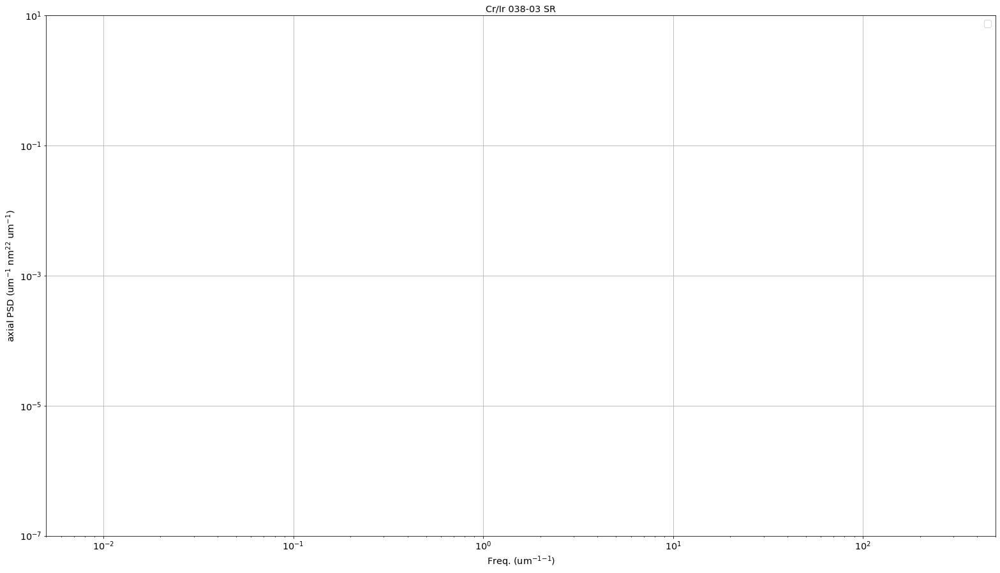

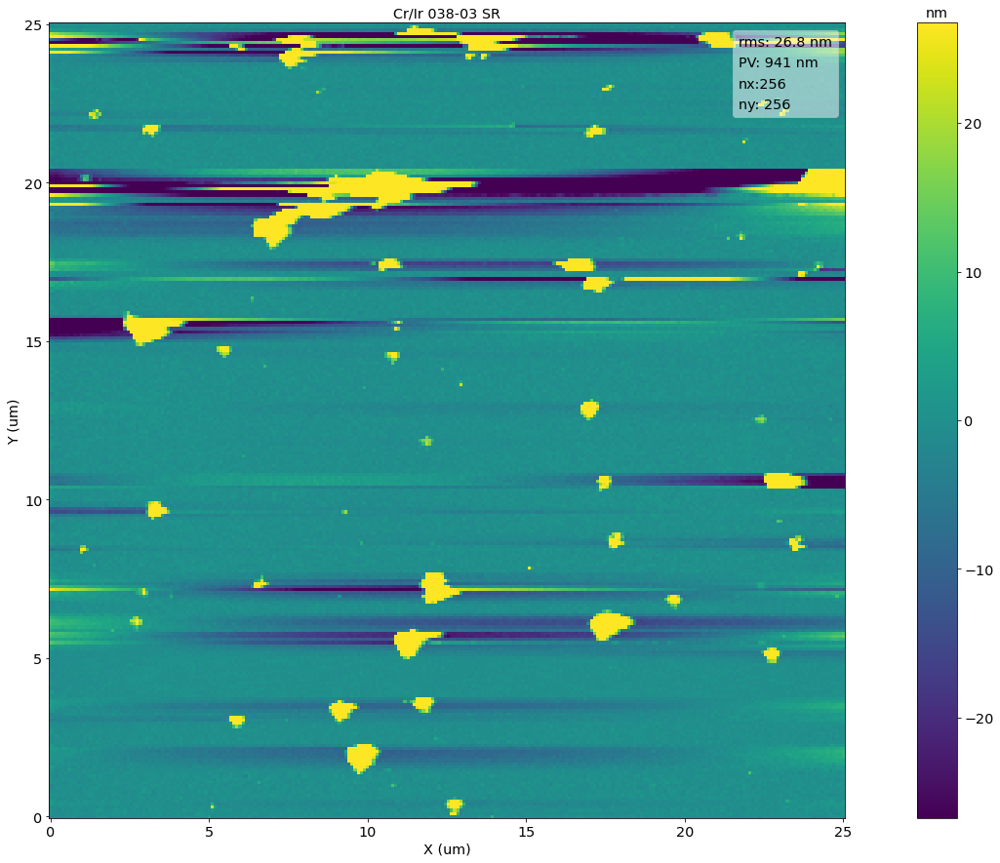

<Figure size 1920x1080 with 0 Axes>

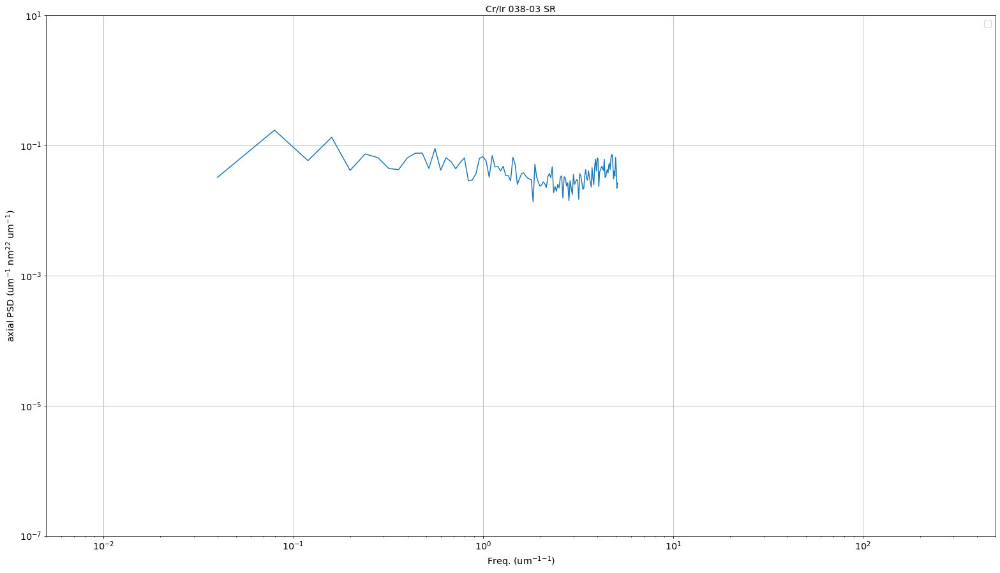

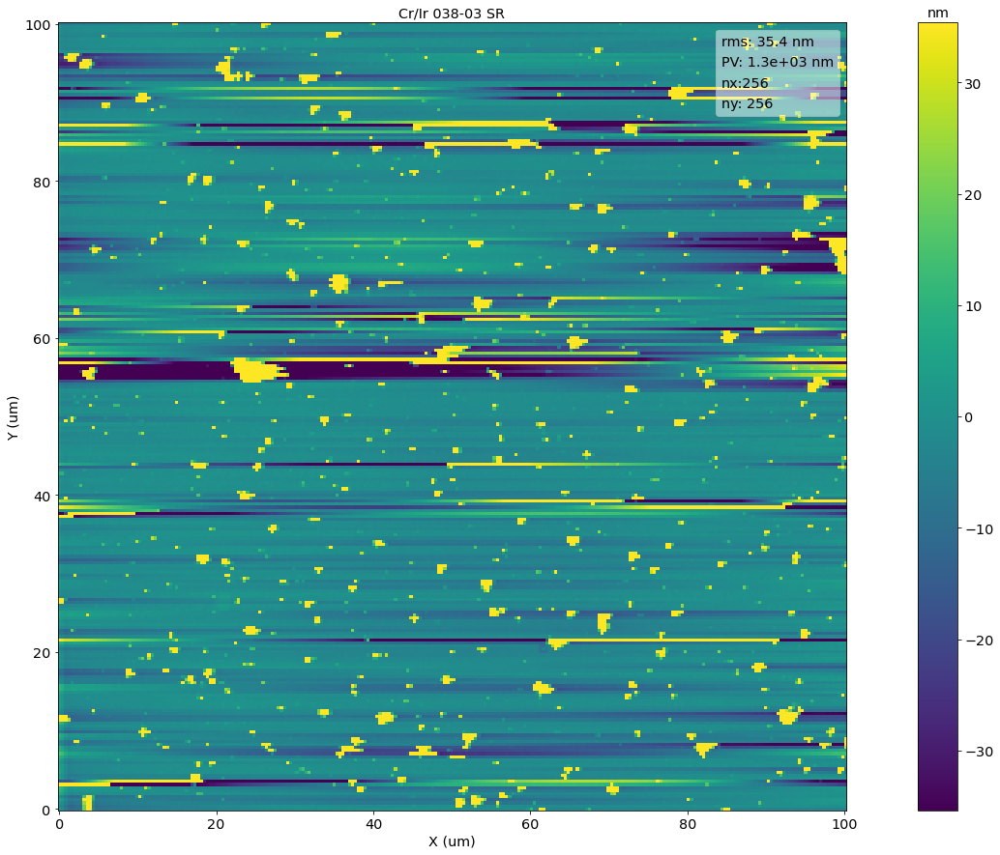

<Figure size 1920x1080 with 0 Axes>

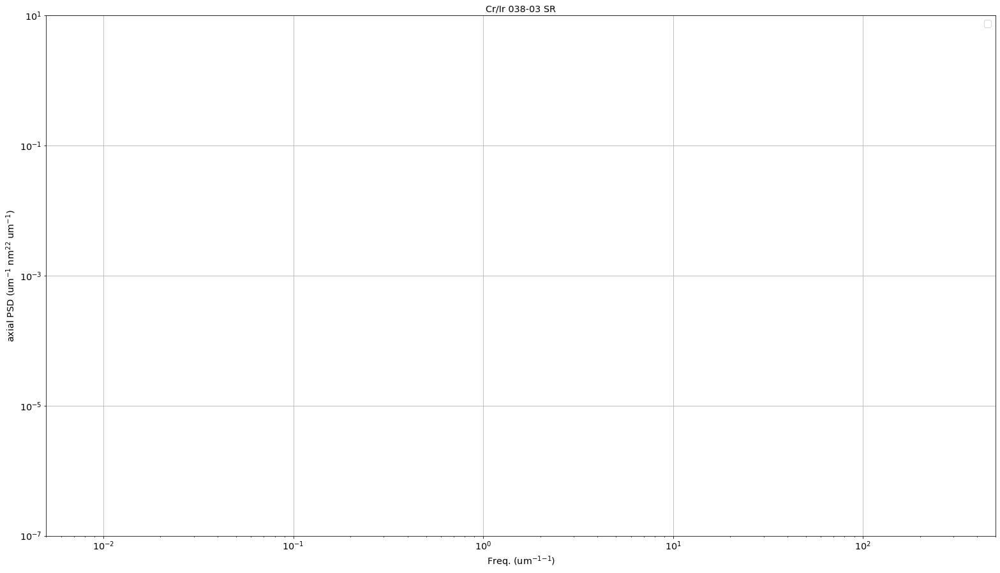

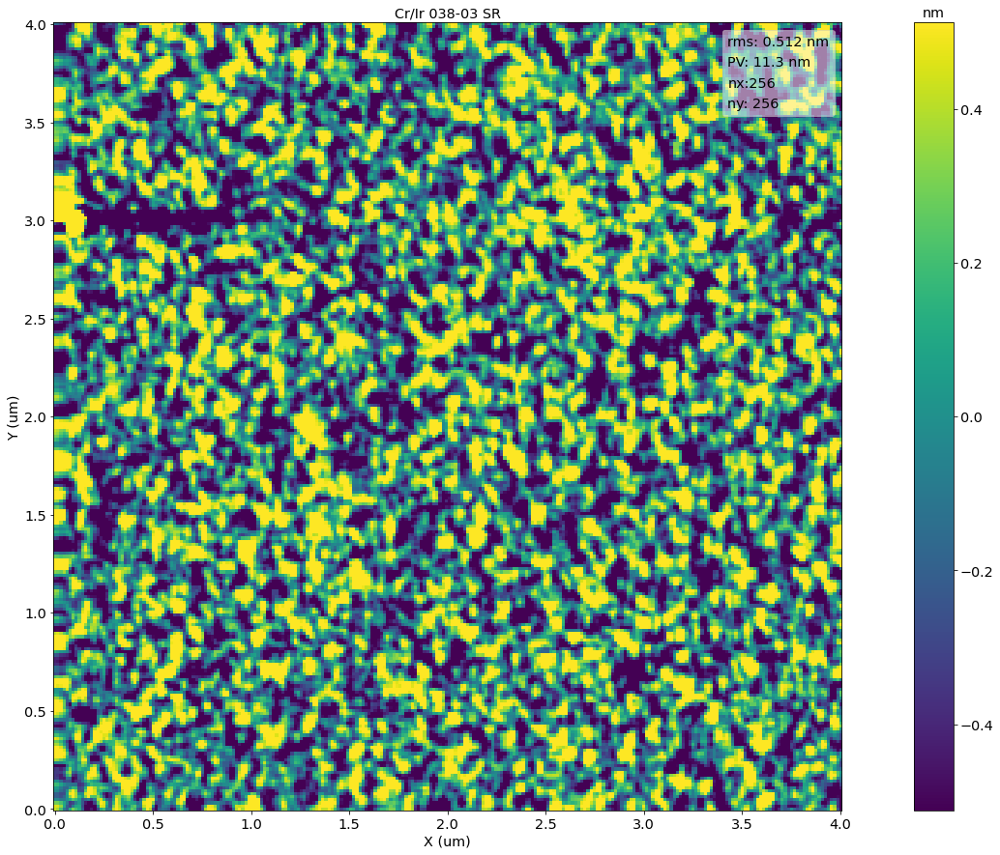

<Figure size 1920x1080 with 0 Axes>

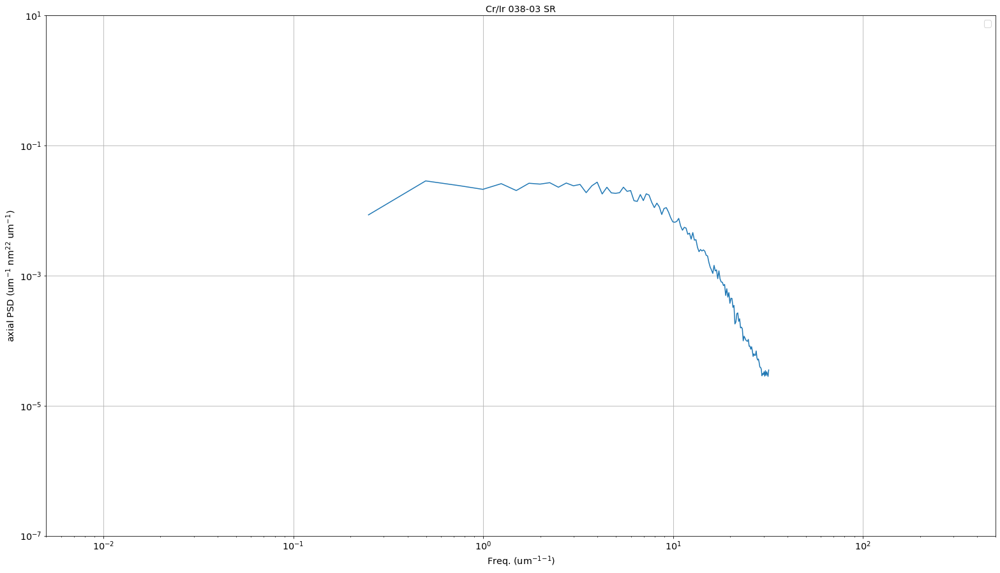

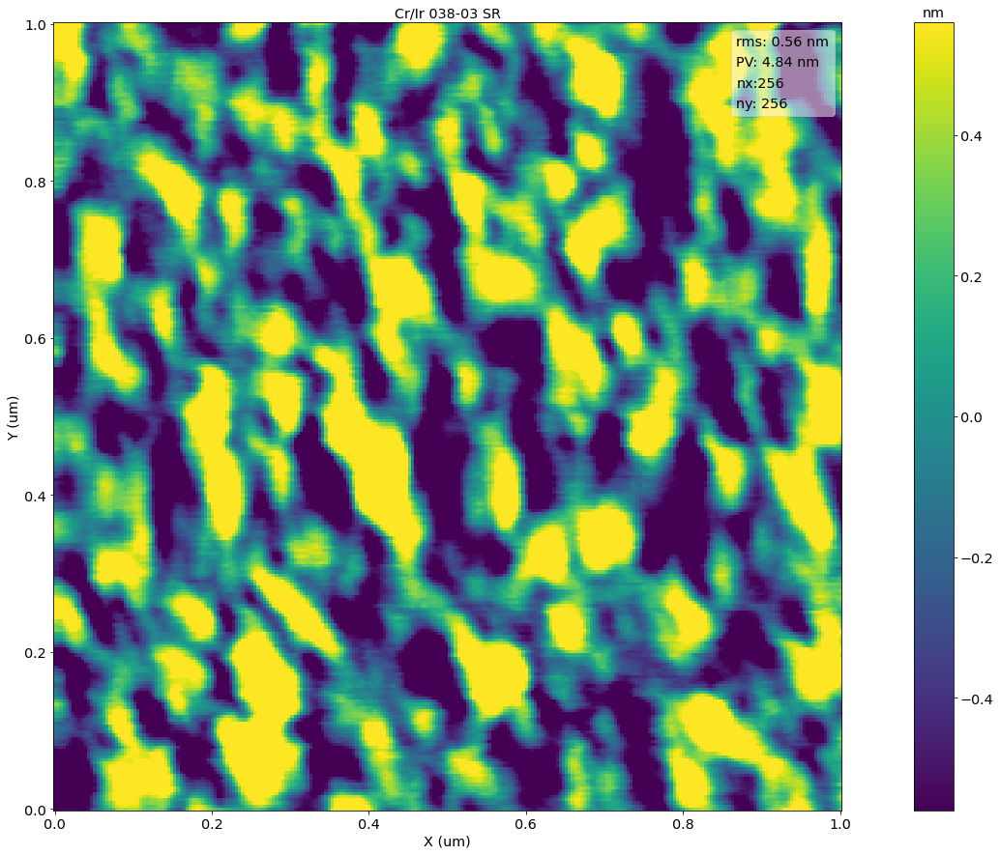

<Figure size 1920x1080 with 0 Axes>

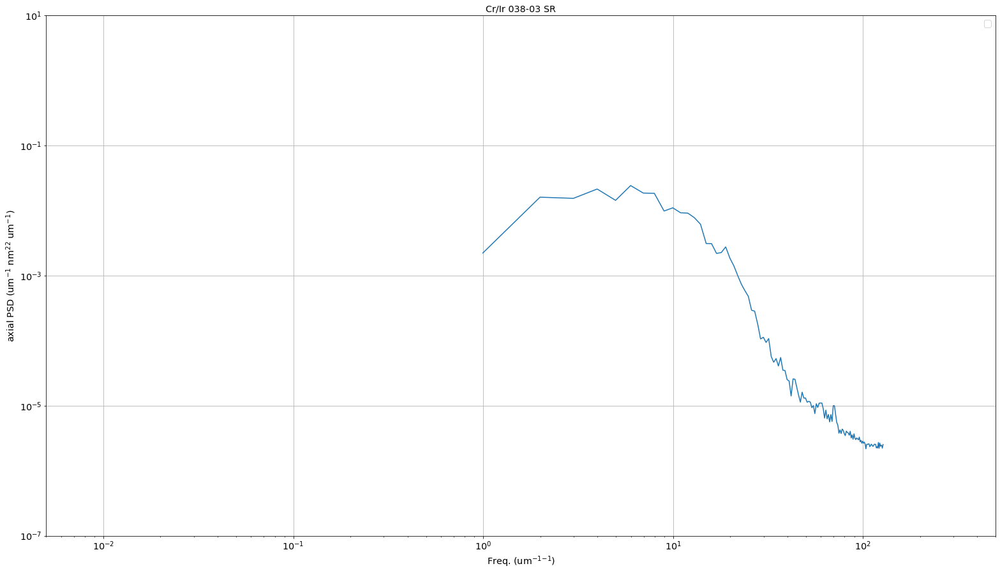

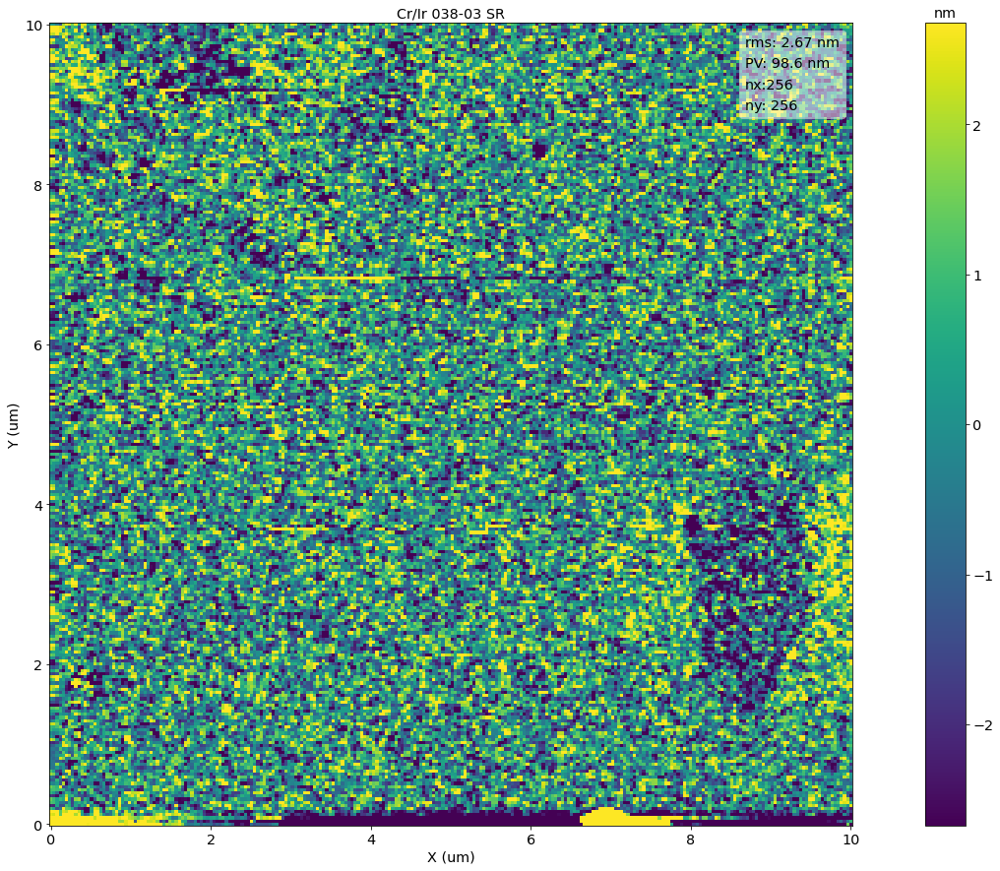

<Figure size 1920x1080 with 0 Axes>

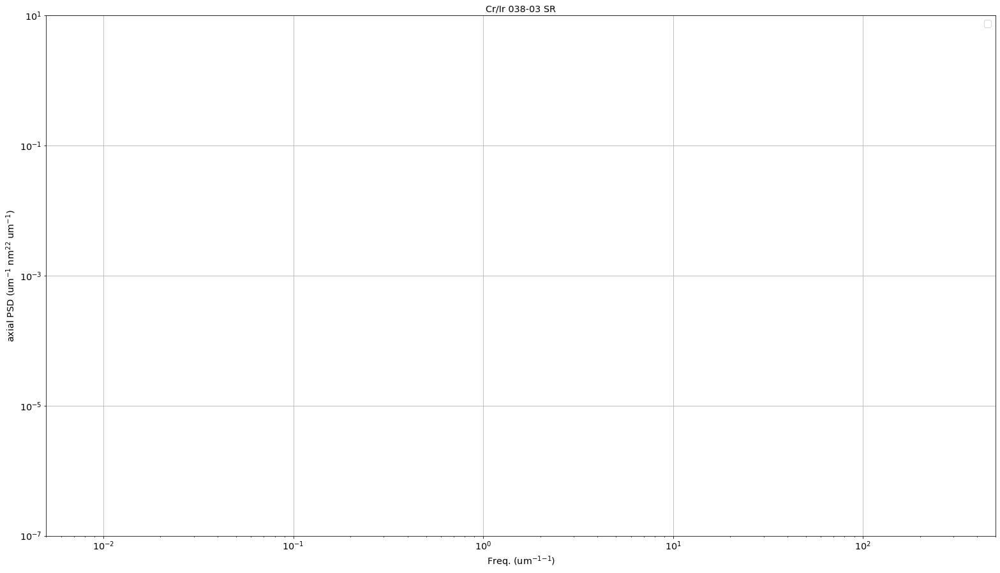

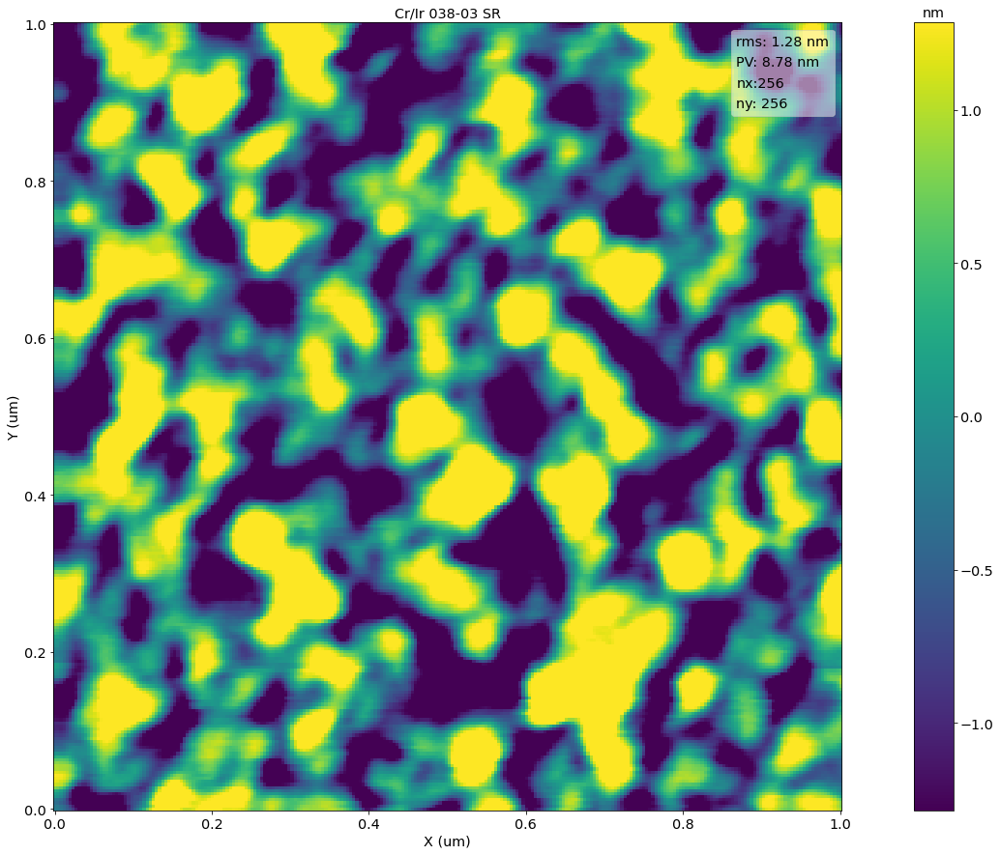

<Figure size 1920x1080 with 0 Axes>

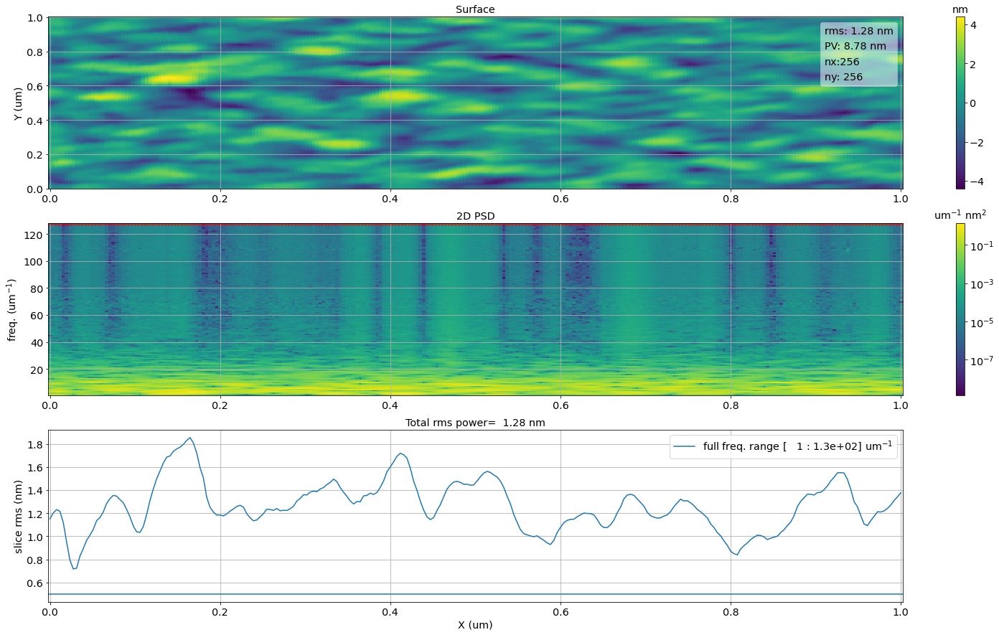

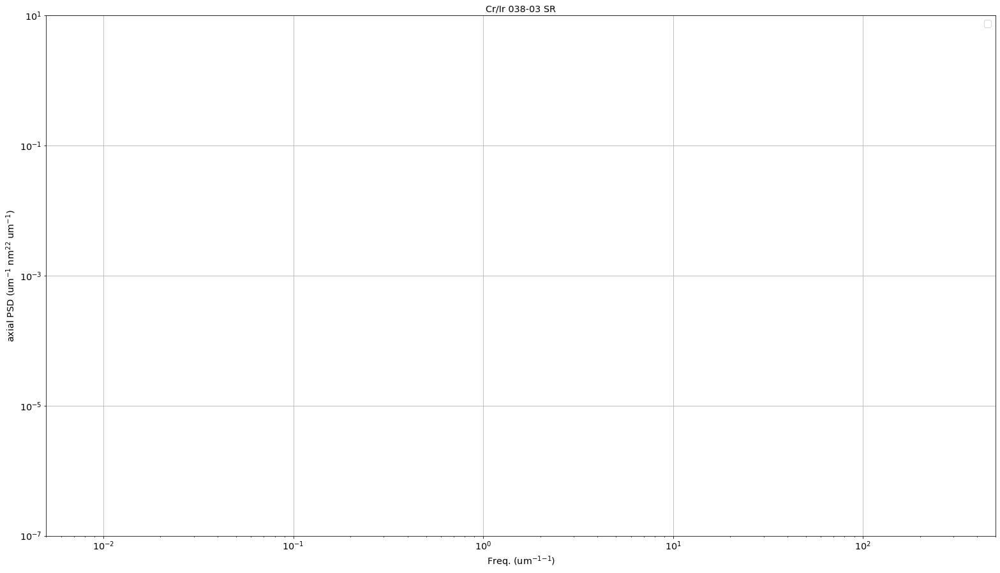

In [32]:
datafolder = infolder #r'G:\My Drive\progetti\c_overcoating\esperimenti\20210129_dopamine\20210224_dopamine_clean'
df=['06_IrCrPh8_C2_010um.nid',
'07_IrCrPh8_C_001um.nid',
'08_IrCrPh8_C_004um.nid',
'09_IrCrPh8_C_025um.nid',
'10_IrCrPh8_C_100um.nid',
'11_IrCrPh8_C_004um.nid',
'12_IrCrPh8_C_001um.nid',
'13_IrCrPh7_C_010um.nid',
'16_IrCrPh7_C_001um.nid' ]

files = [os.path.join(datafolder,f) for f in df]
outfolder = os.path.join(outdir,r'surface\038-03')
name = 'Cr/Ir 038-03 SR'

dopsd(files,name,outfolder,rmsthr= 0.5, psdrange=[1e-7,10],frange=[5e-3,5e2])

labels =['AFM - 1 um','AFM - 10 um','AFM - 50 um']
datadic[name] = [[os.path.join(outfolder,f) for f in df],labels]

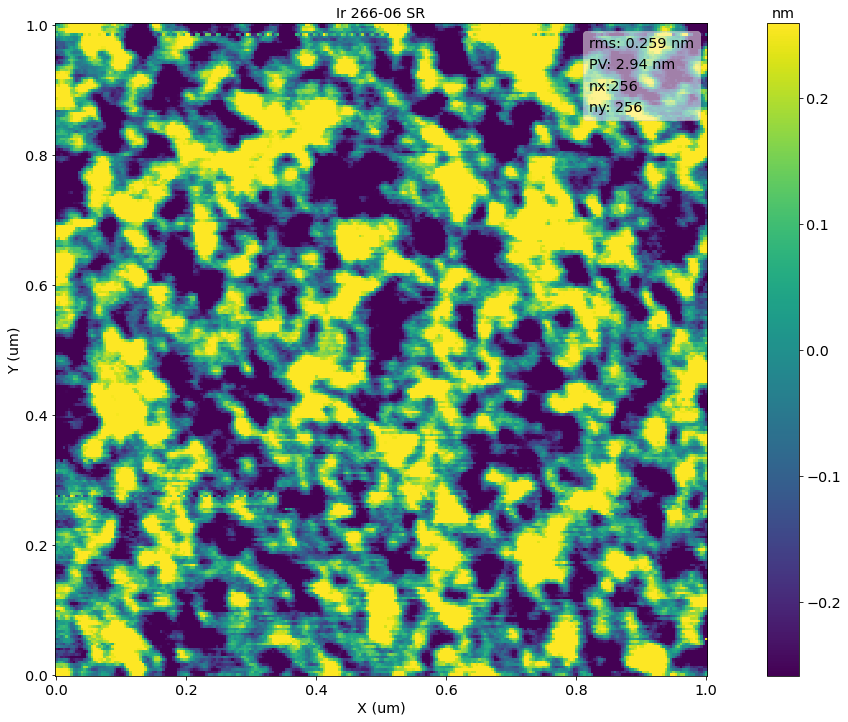

<Figure size 1536x864 with 0 Axes>

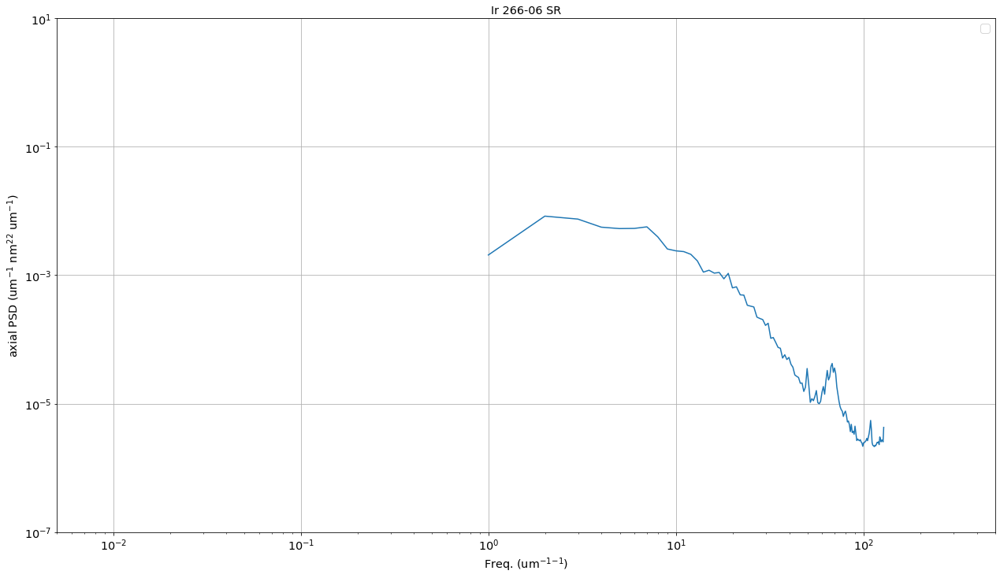

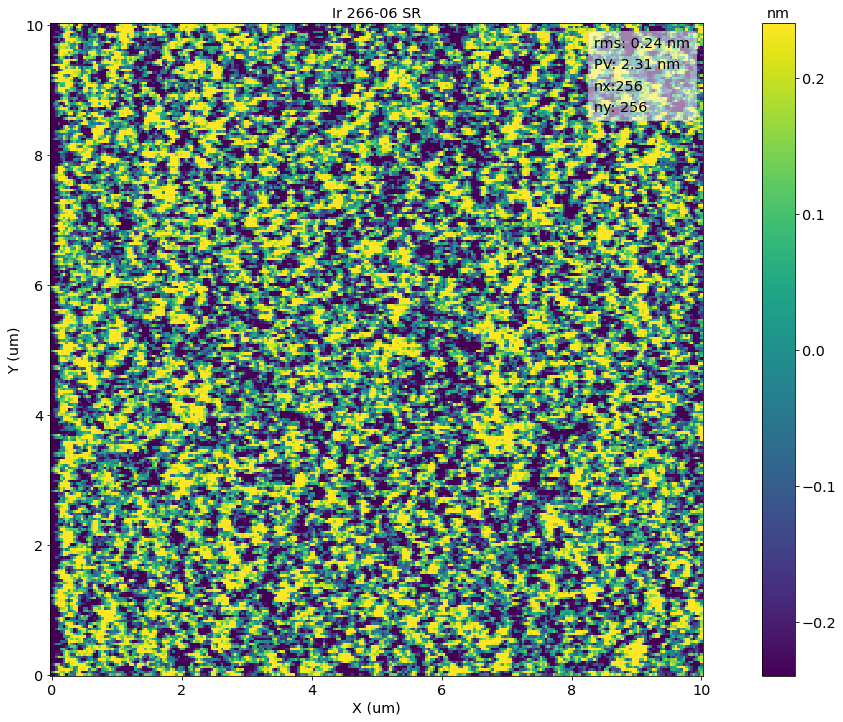

<Figure size 1536x864 with 0 Axes>

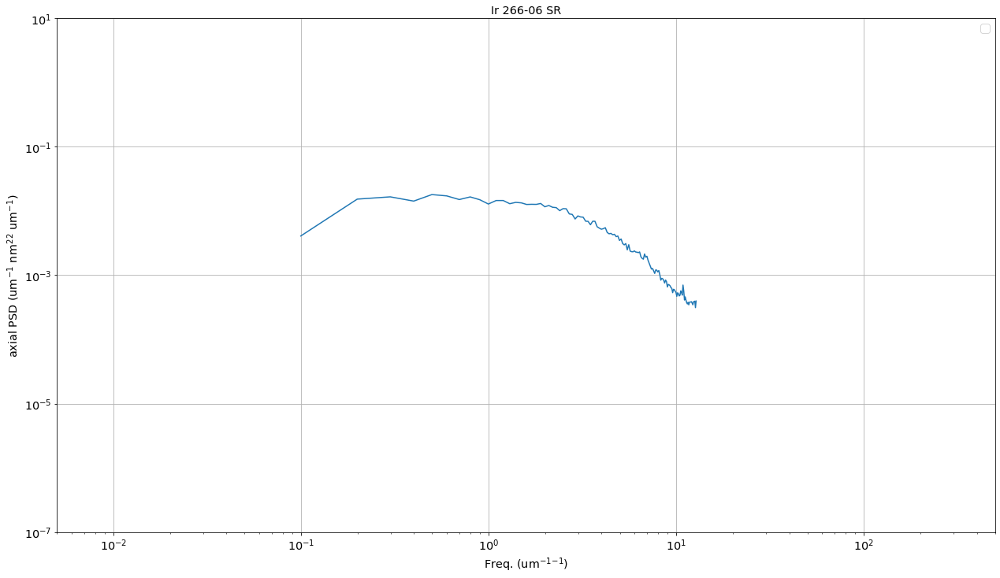

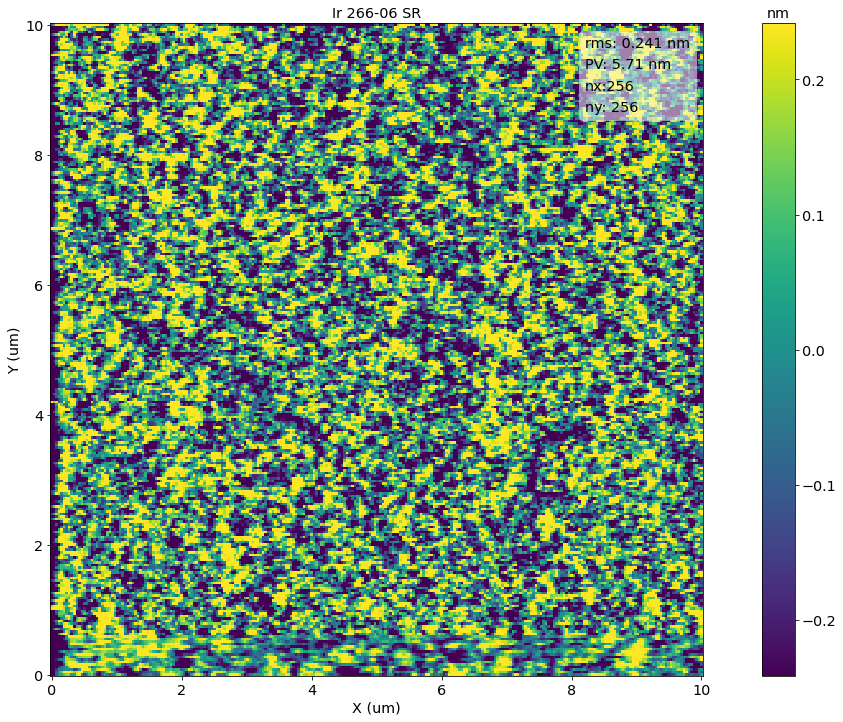

<Figure size 1536x864 with 0 Axes>

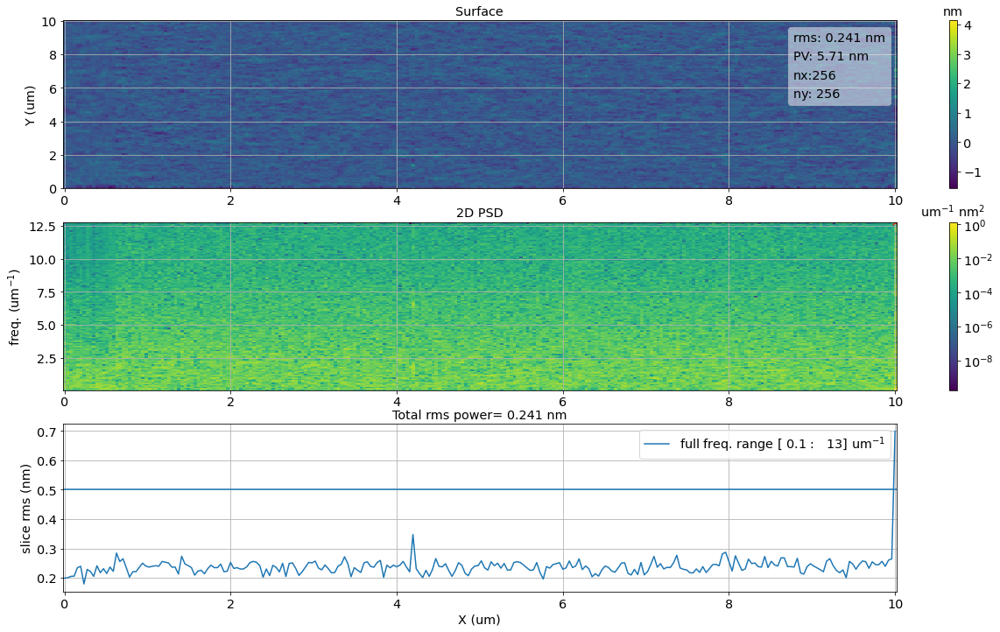

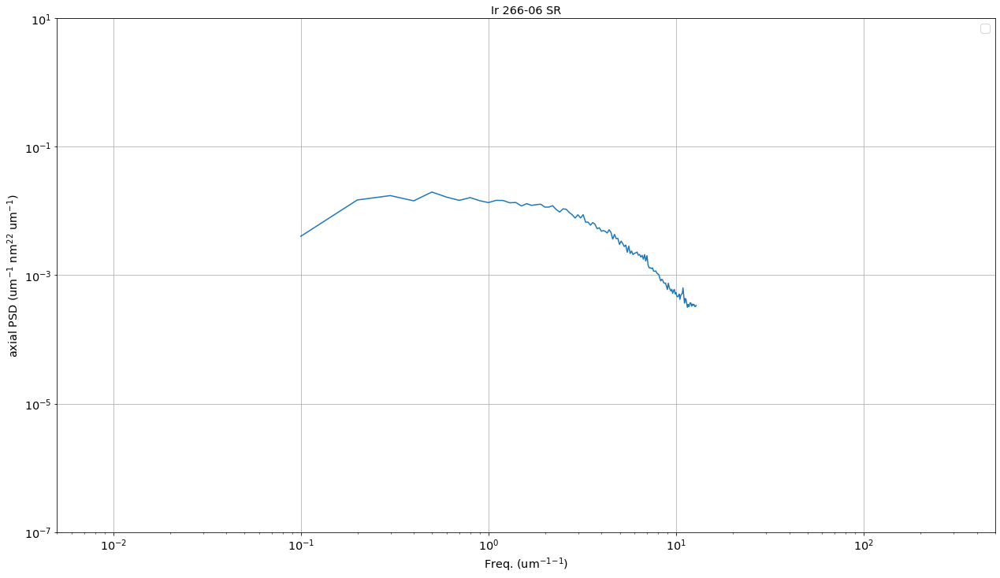

In [35]:
datafolder = r'G:\My Drive\progetti\c_overcoating\esperimenti\20210129_dopamine\20210224_dopamine_clean'
df=['Image00090.nid',    #266-06 1  Ir SR
'Image00091.nid',    #266-06 10
'Image00092.nid']    #266-06 50 parziale

files = [os.path.join(datafolder,f) for f in df]
outfolder = os.path.join(outdir,r'surface\266-06')
name = 'Ir 266-06 SR'

dopsd(files,name,outfolder,rmsthr= 0.5,psdrange=[1e-7,10],frange=[5e-3,5e2])

labels =['AFM - 1 um','AFM - 10 um','AFM - 50 um']
datadic[name] = [[os.path.join(outfolder,f) for f in df],labels]

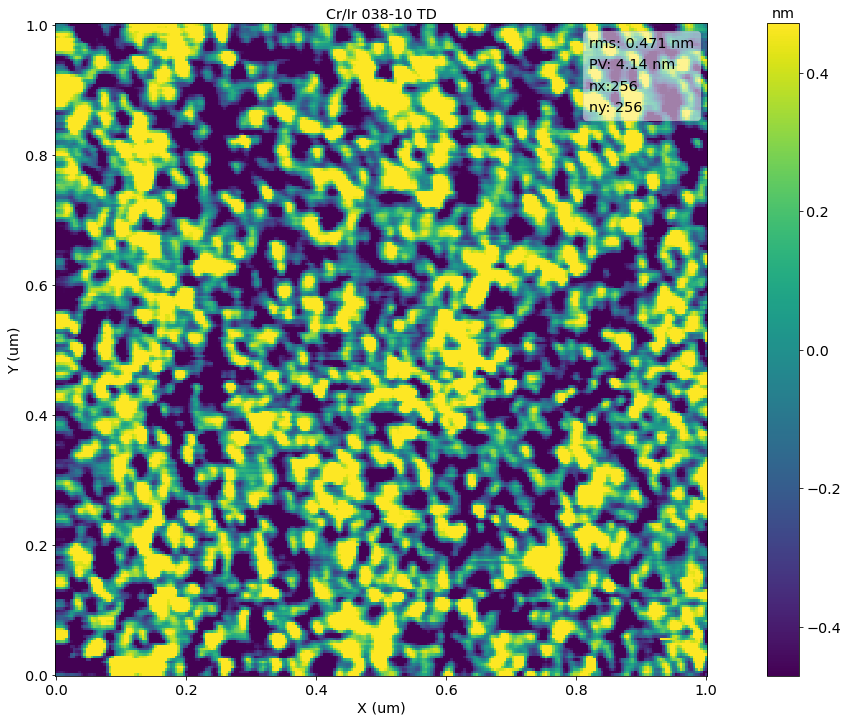

<Figure size 1536x864 with 0 Axes>

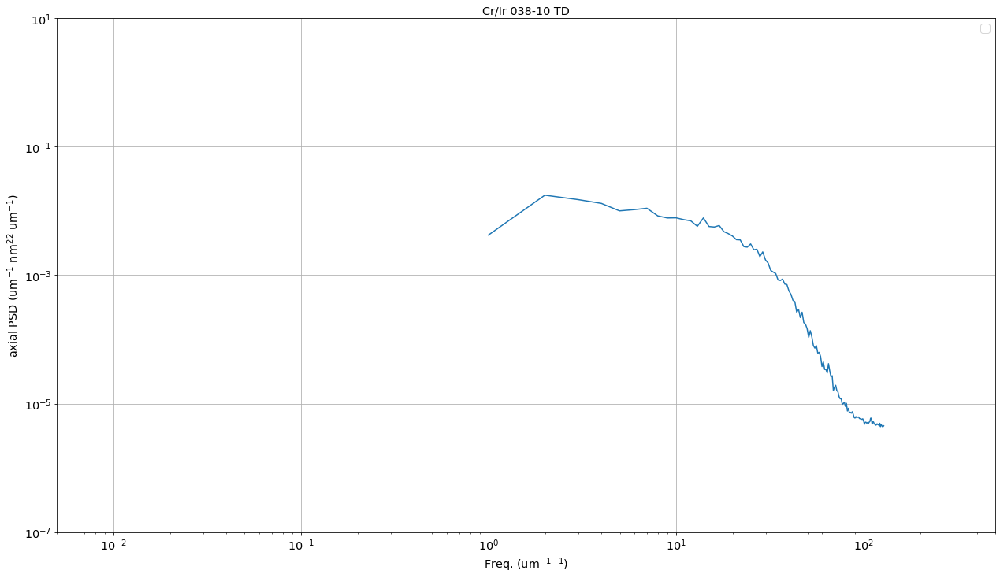

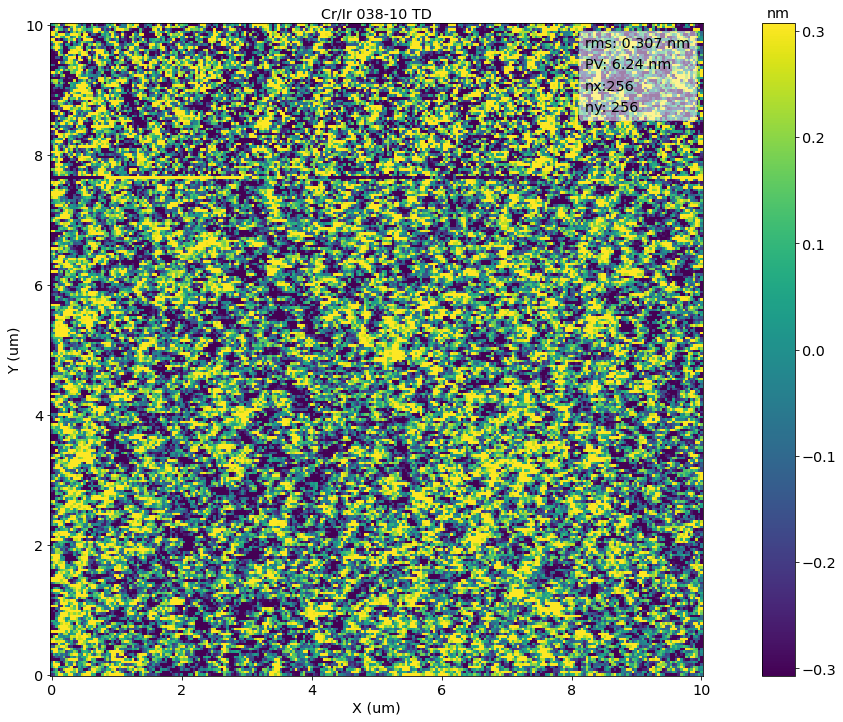

<Figure size 1536x864 with 0 Axes>

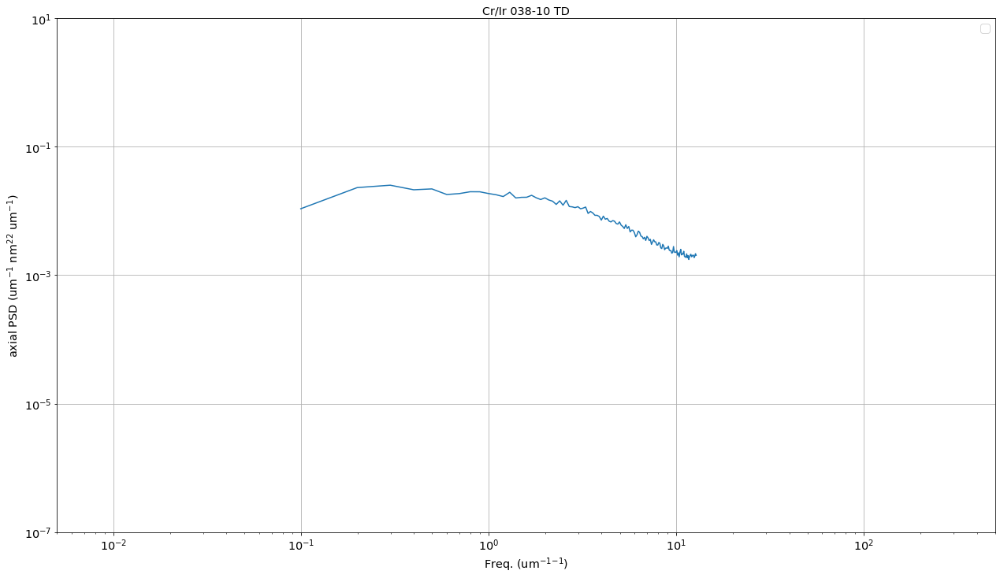

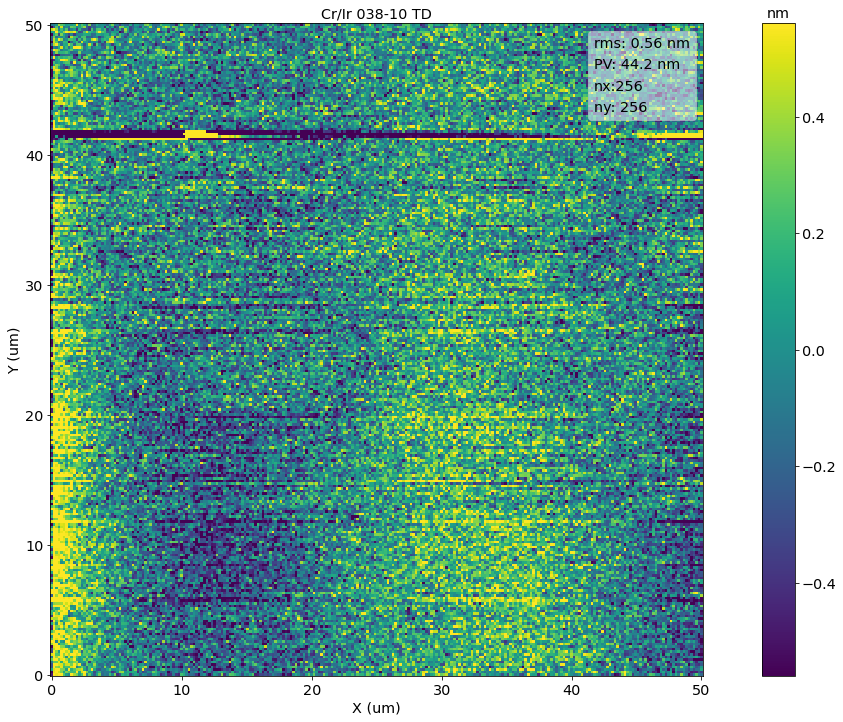

<Figure size 1536x864 with 0 Axes>

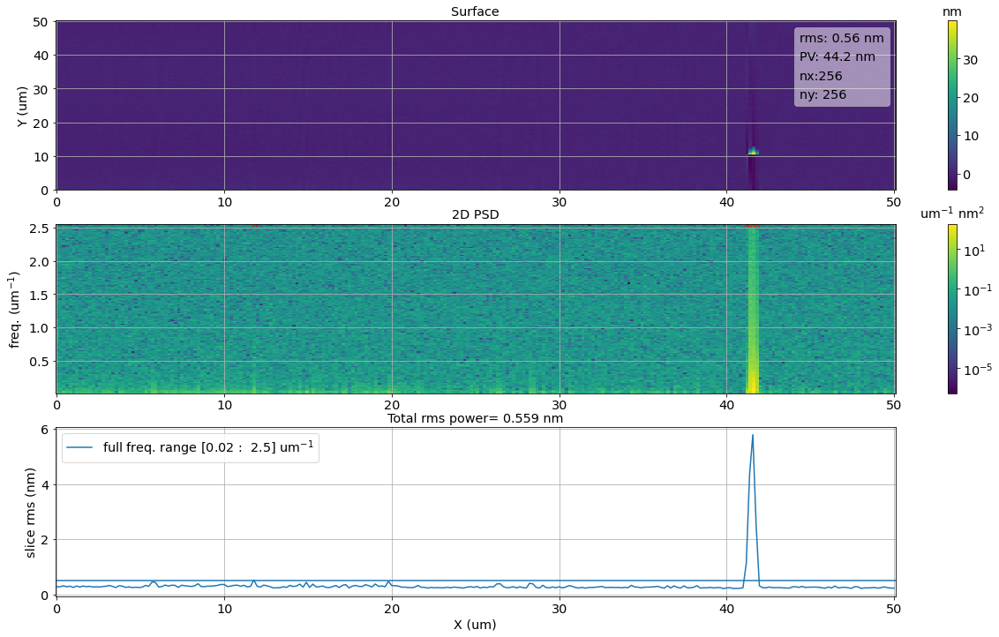

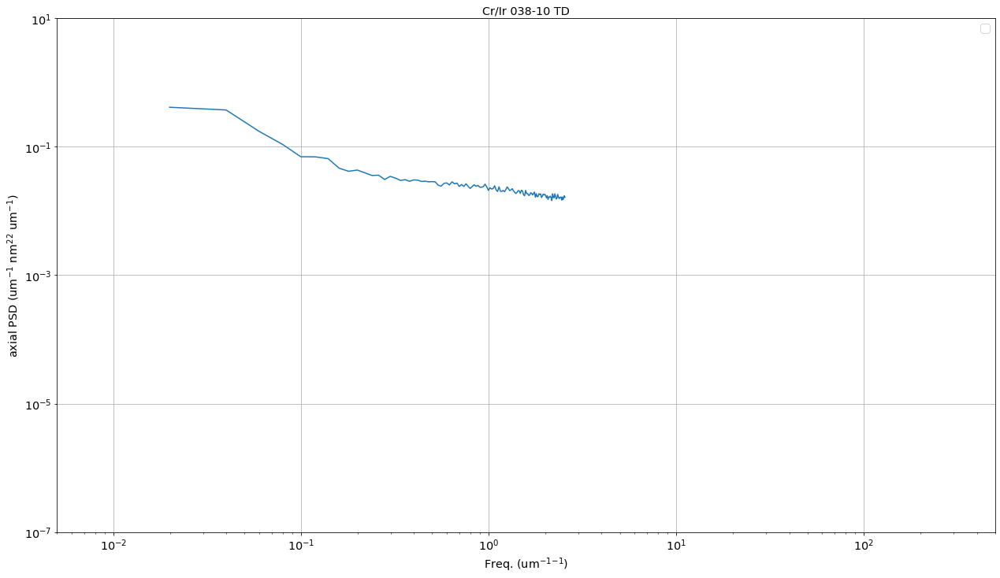

In [36]:
datafolder = r'G:\My Drive\progetti\c_overcoating\esperimenti\20210129_dopamine\20210224_dopamine_clean'
df=['Image00093.nid',    #038-10 1  Ir TD
'Image00094.nid',    #038-10 10
'Image00095.nid']    #038-10 50
files = [os.path.join(datafolder,f) for f in df]

outfolder = os.path.join(outdir,r'surface\038-10')
name = 'Cr/Ir 038-10 TD'

dopsd(files,name,outfolder,rmsthr= 0.5,psdrange=[1e-7,10],frange=[5e-3,5e2])

labels =['AFM - 1 um','AFM - 10 um','AFM - 50 um']
datadic[name] = [[os.path.join(outfolder,f) for f in df],labels]

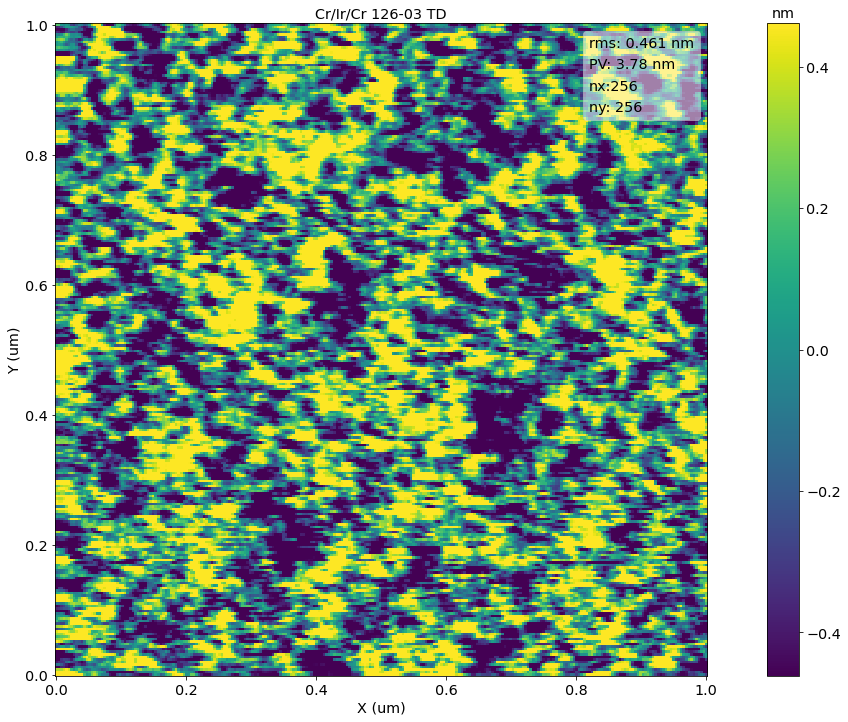

<Figure size 1536x864 with 0 Axes>

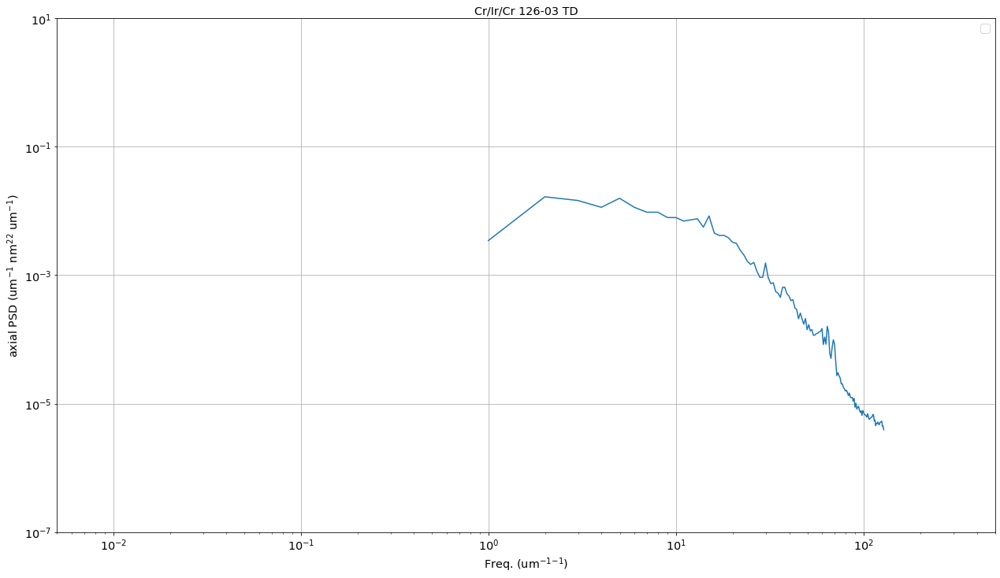

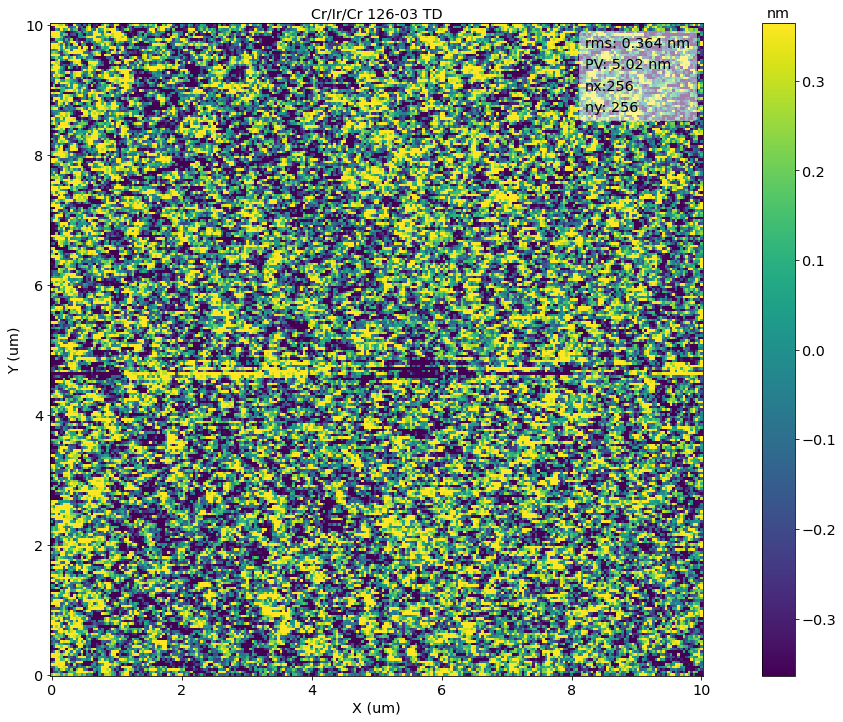

<Figure size 1536x864 with 0 Axes>

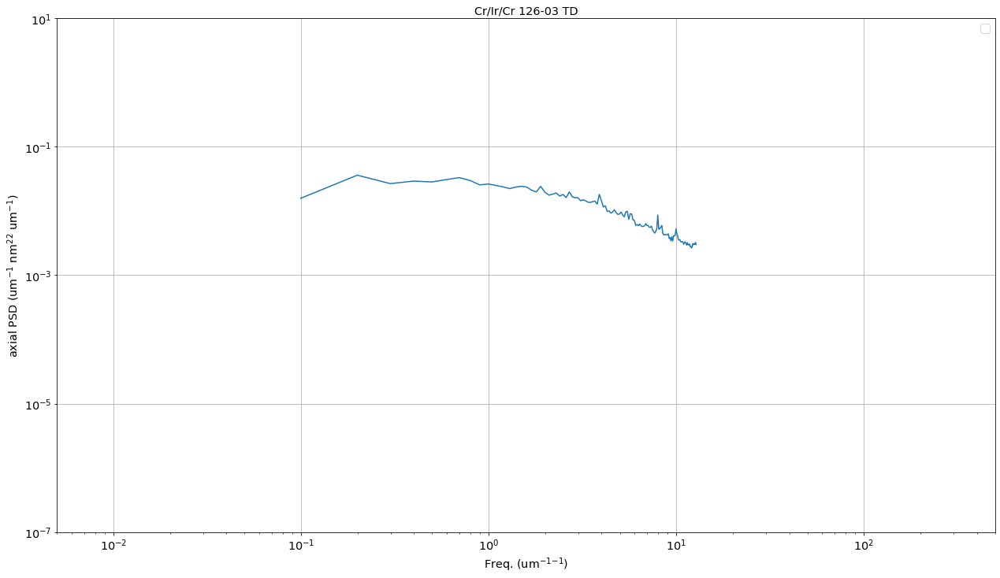

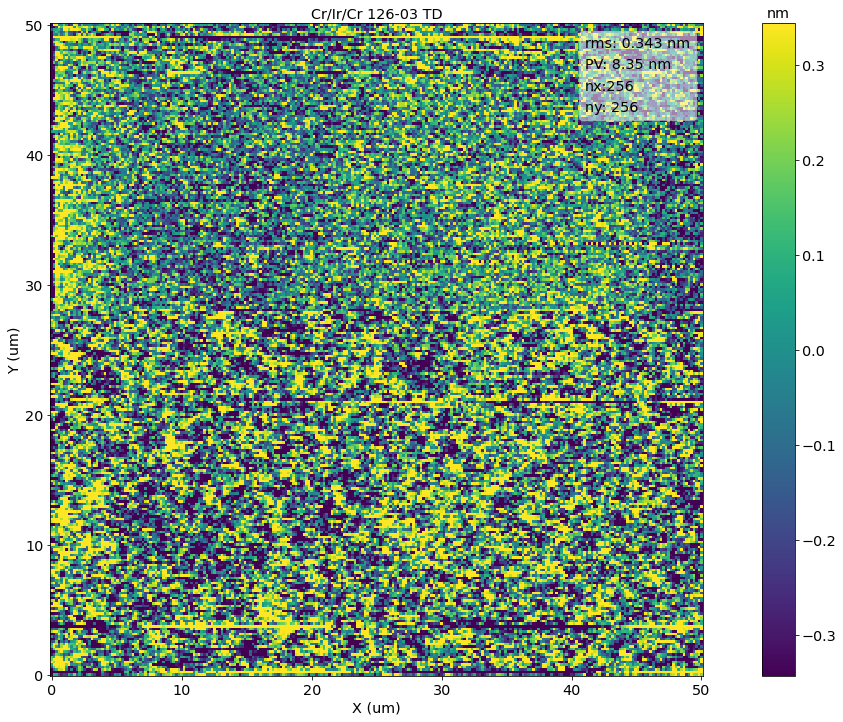

<Figure size 1536x864 with 0 Axes>

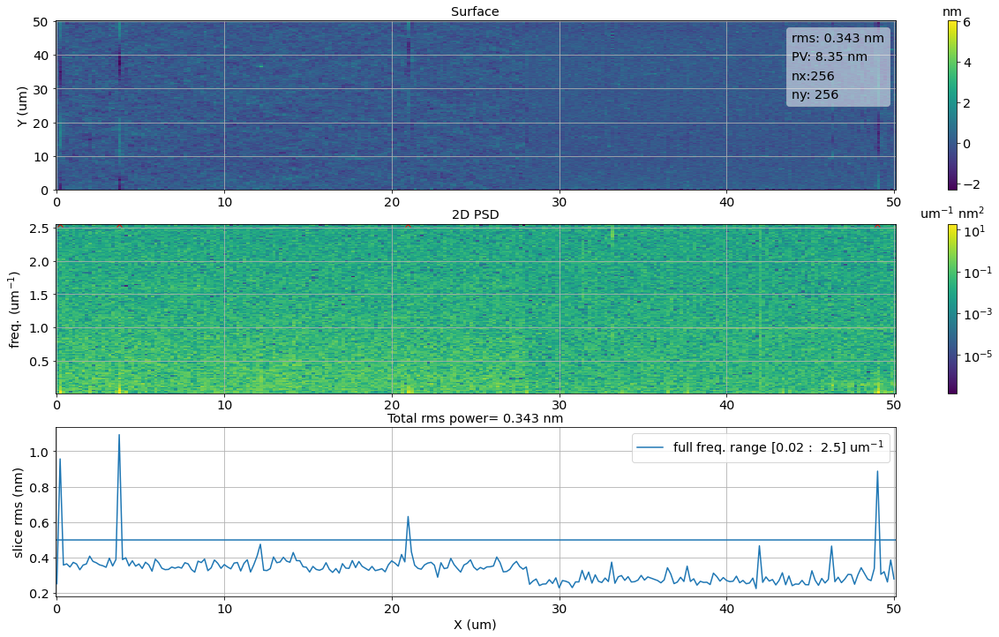

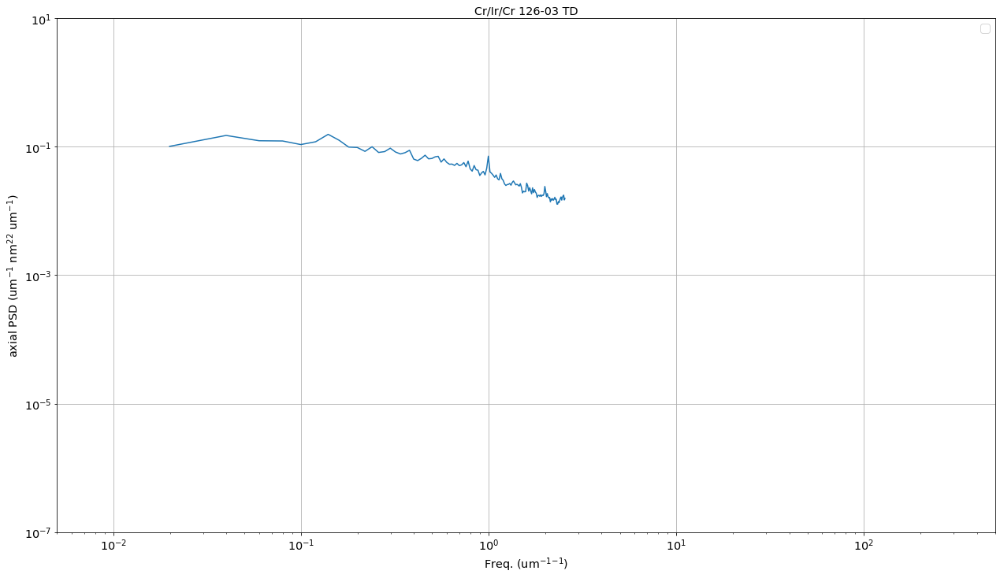

In [37]:
datafolder = r'G:\My Drive\progetti\c_overcoating\esperimenti\20210129_dopamine\20210224_dopamine_clean'
df=['Image00096.nid',    #126-03 1  IrCr TD
'Image00097.nid',    #126-03 10
'Image00098.nid']    #126-03 50 parziale
files = [os.path.join(datafolder,f) for f in df]

outfolder = os.path.join(outdir,r'surface\126-03')
name = 'Cr/Ir/Cr 126-03 TD'

dopsd(files,name,outfolder,rmsthr= 0.5,psdrange=[1e-7,10],frange=[5e-3,5e2])

labels =['AFM - 1 um','AFM - 10 um','AFM - 50 um']
datadic[name] = [[os.path.join(outfolder,f) for f in df],labels]

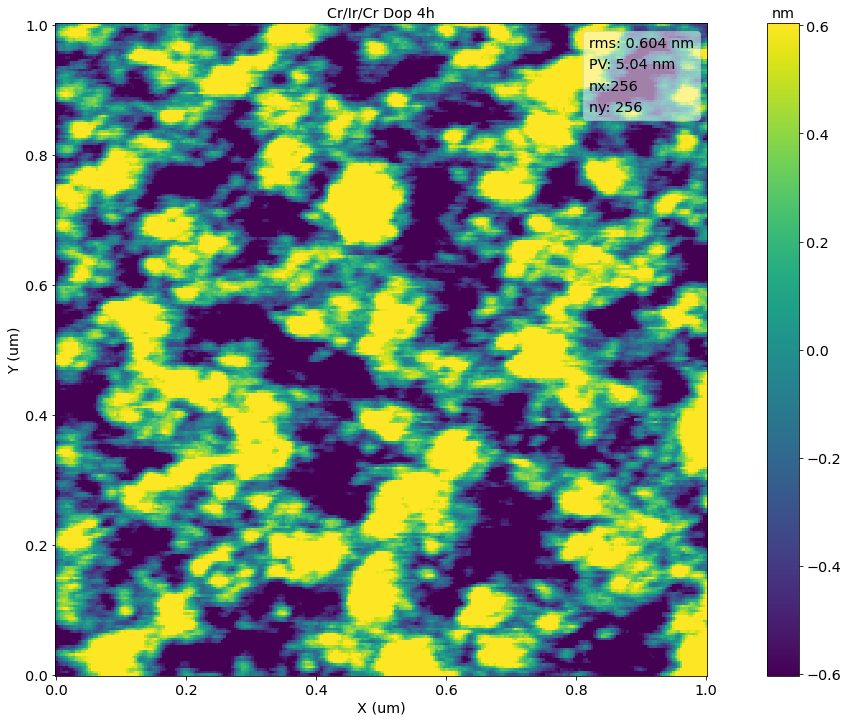

<Figure size 1536x864 with 0 Axes>

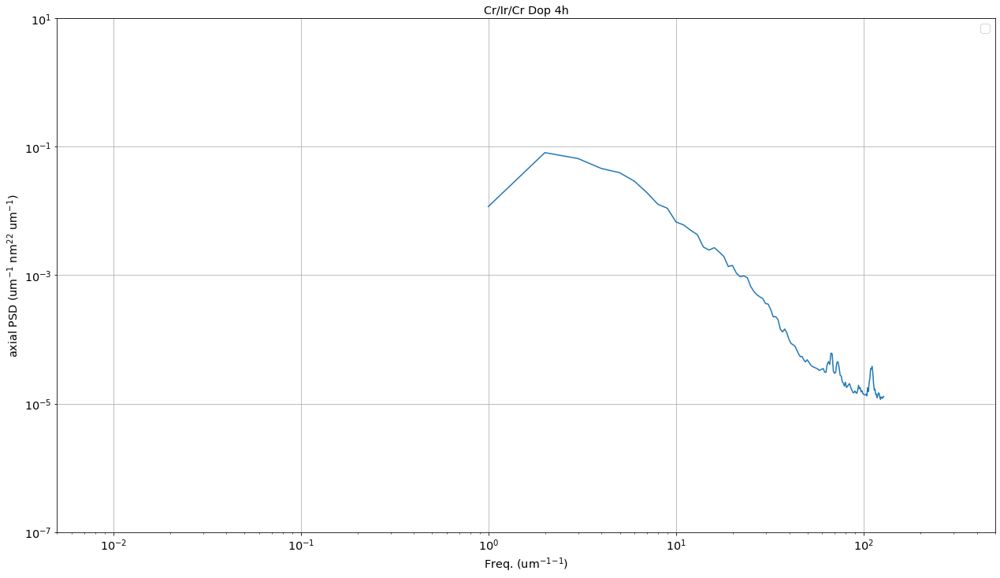

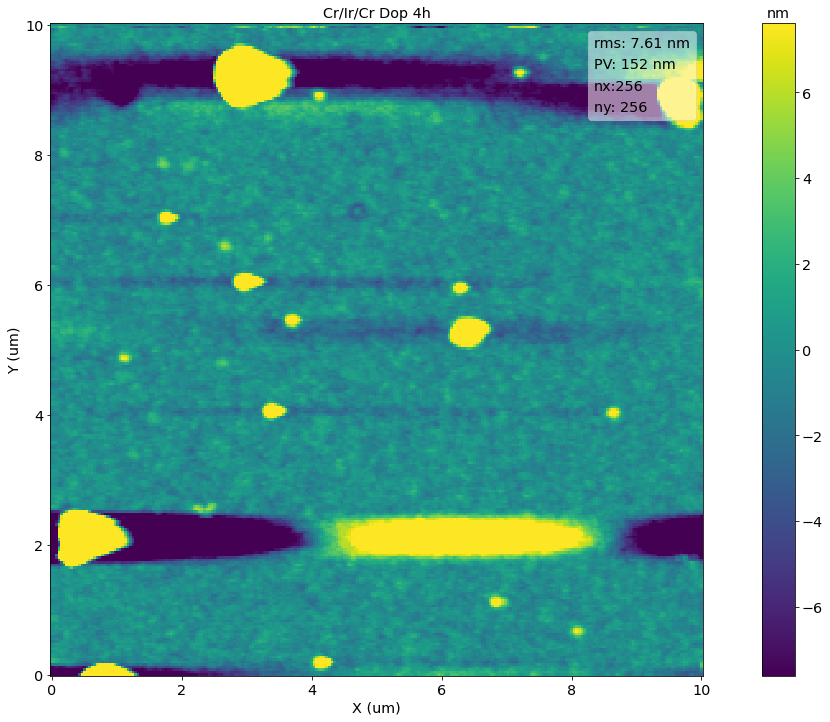

<Figure size 1536x864 with 0 Axes>

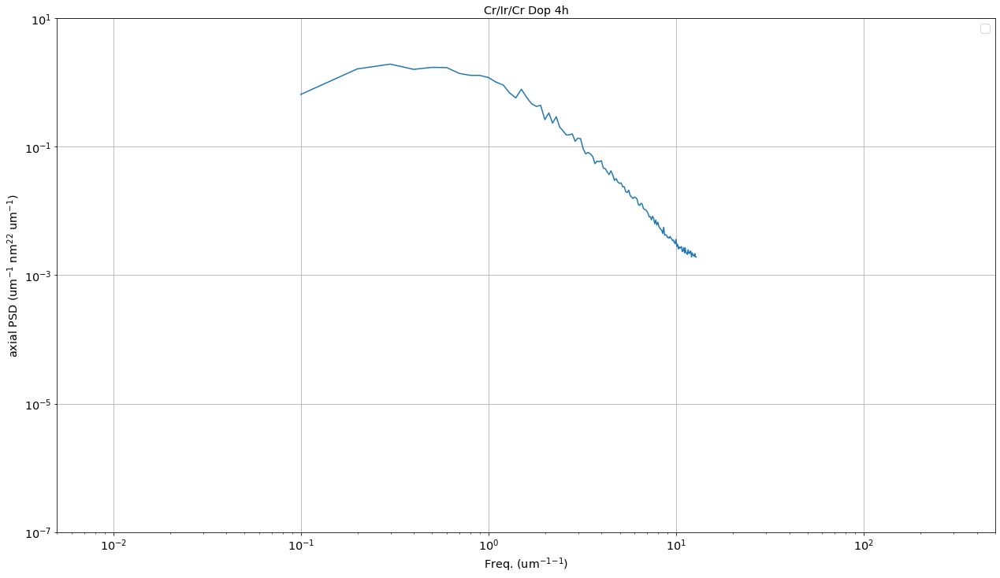

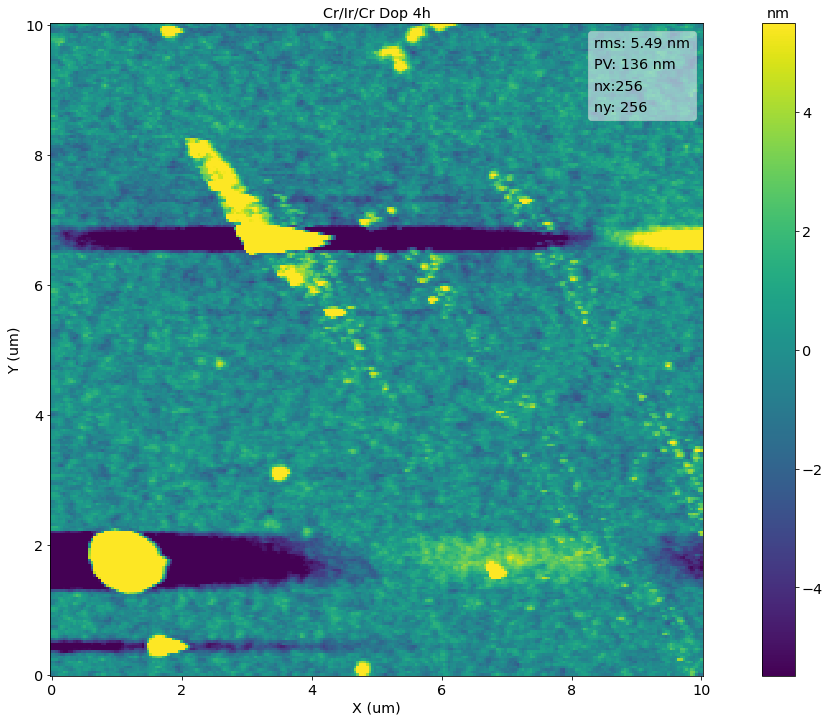

<Figure size 1536x864 with 0 Axes>

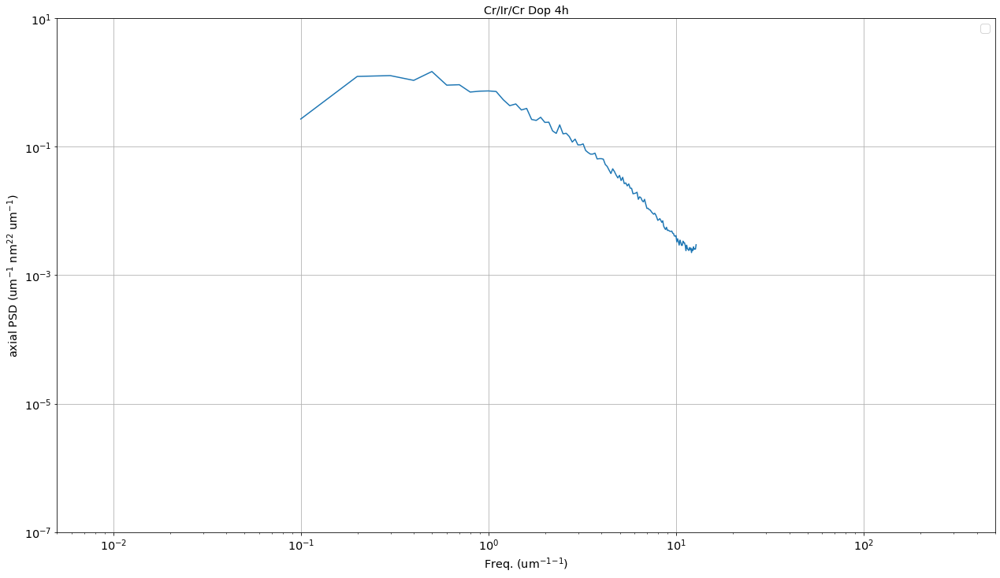

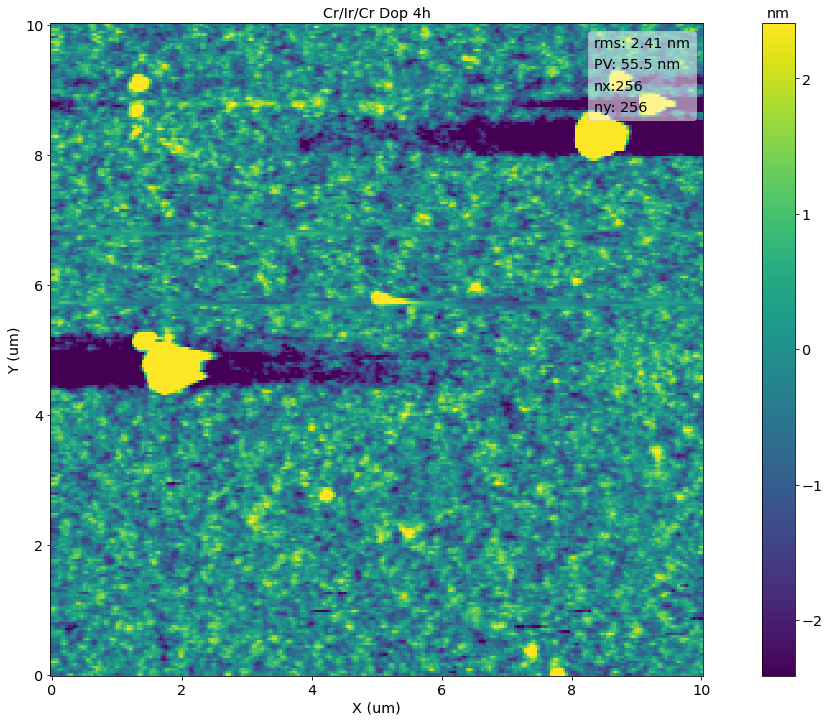

<Figure size 1536x864 with 0 Axes>

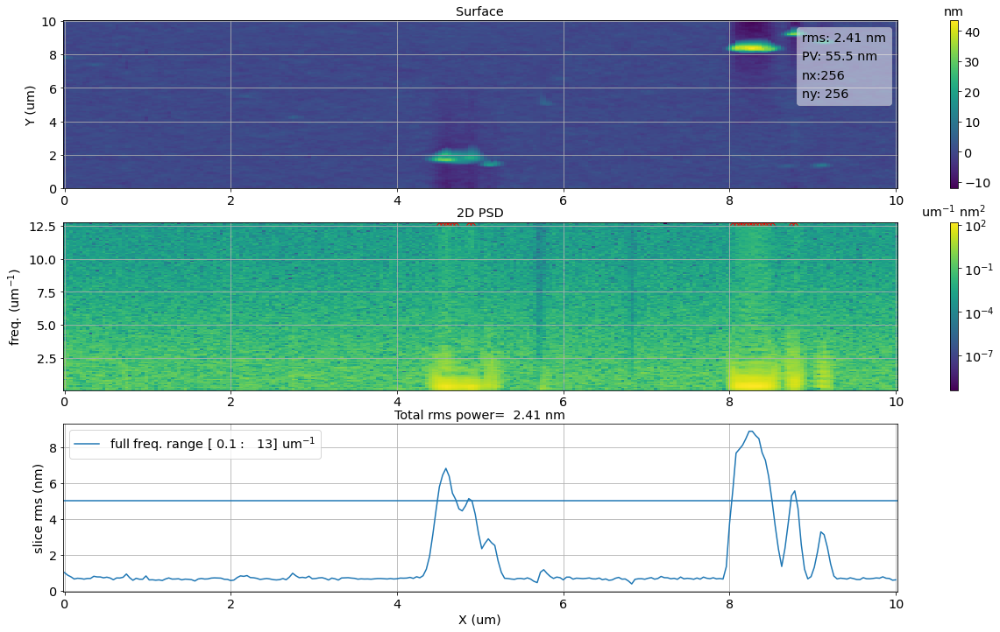

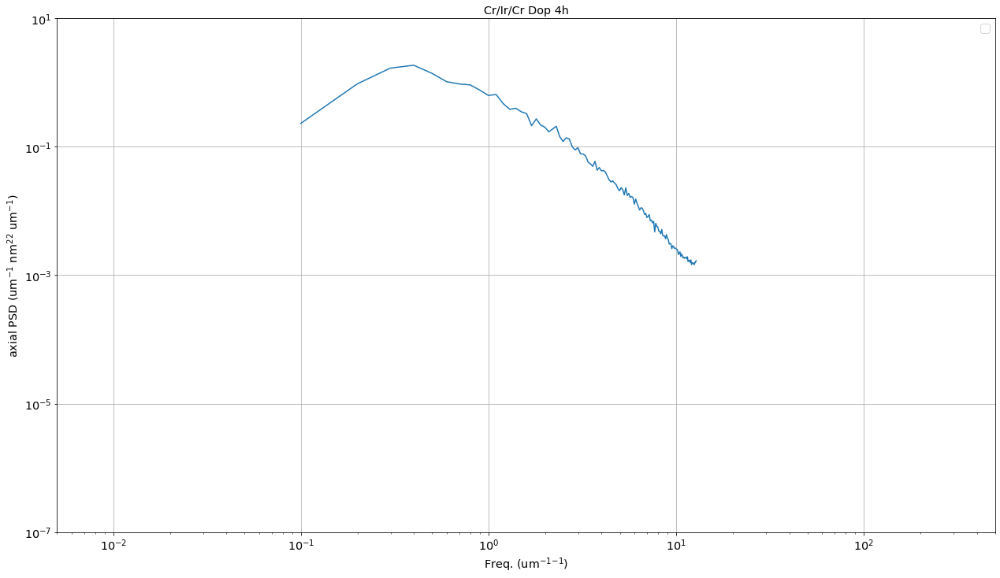

In [38]:
datafolder = r'G:\My Drive\progetti\c_overcoating\esperimenti\20210129_dopamine\20210224_dopamine_clean'
df=['01_dop4h02_001um.nid',    #1  IrCrdop 4 h
'02_dop4h02_010um.nid',    #10
'03_dop4h02_010um.nid',    #10
'04_dop4h02_010um.nid']    #10
files = [os.path.join(datafolder,f) for f in df]

outfolder = os.path.join(outdir,r'surface\dop4h')
name = 'Cr/Ir/Cr Dop 4h'

dopsd(files,name,outfolder,rmsthr= 5,psdrange=[1e-7,10],frange=[5e-3,5e2])

labels =['AFM - 1 um','AFM - 10 um','AFM - 10 um','AFM - 10 um']
datadic[name] = [[os.path.join(outfolder,f) for f in df],labels]

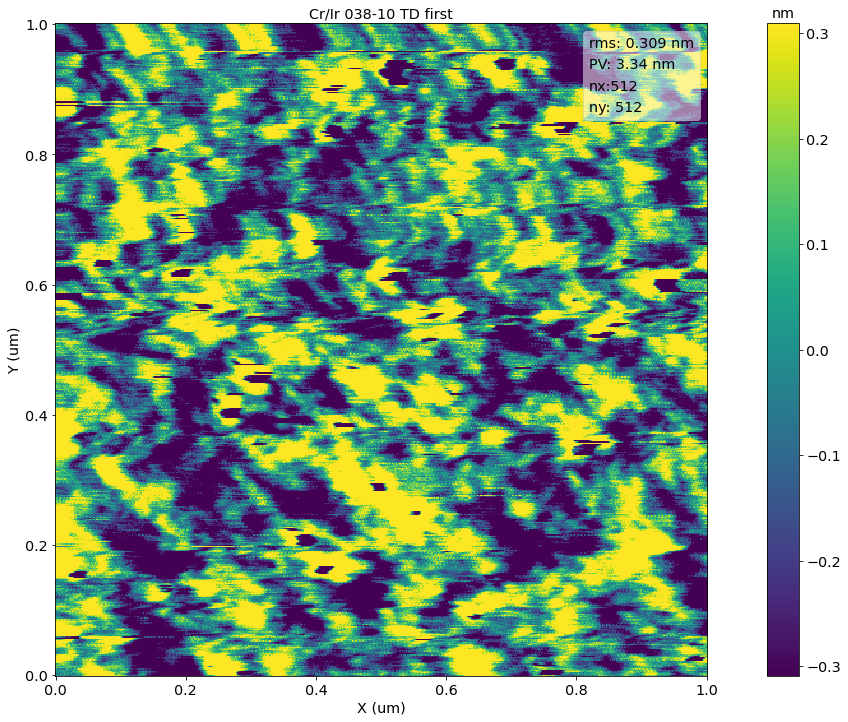

<Figure size 1536x864 with 0 Axes>

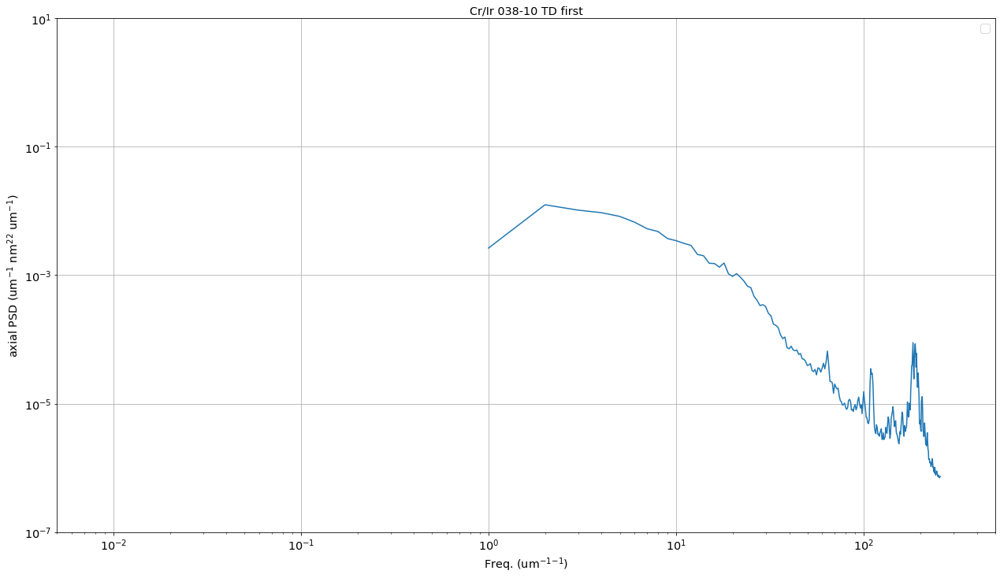

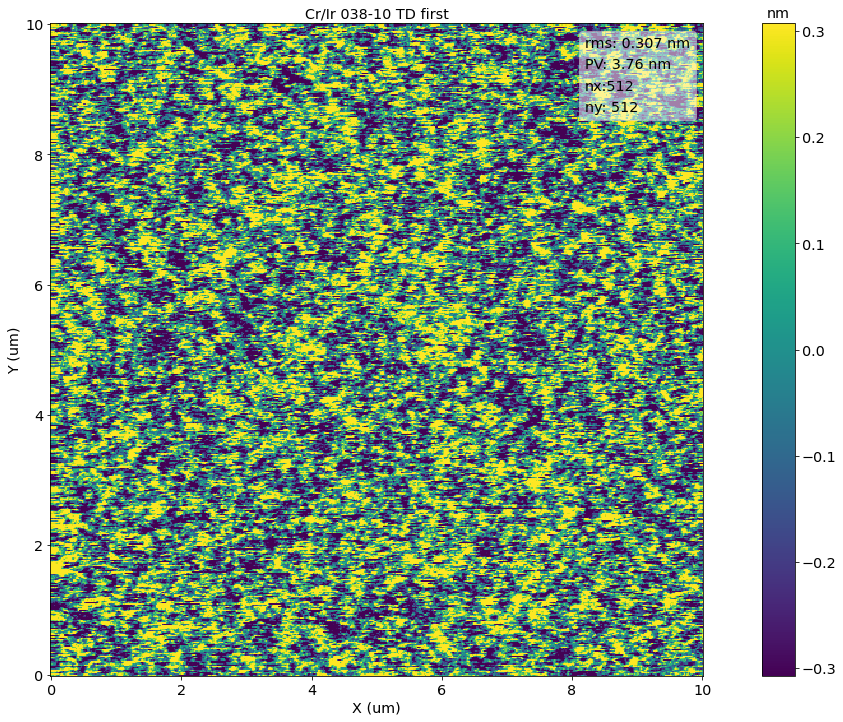

<Figure size 1536x864 with 0 Axes>

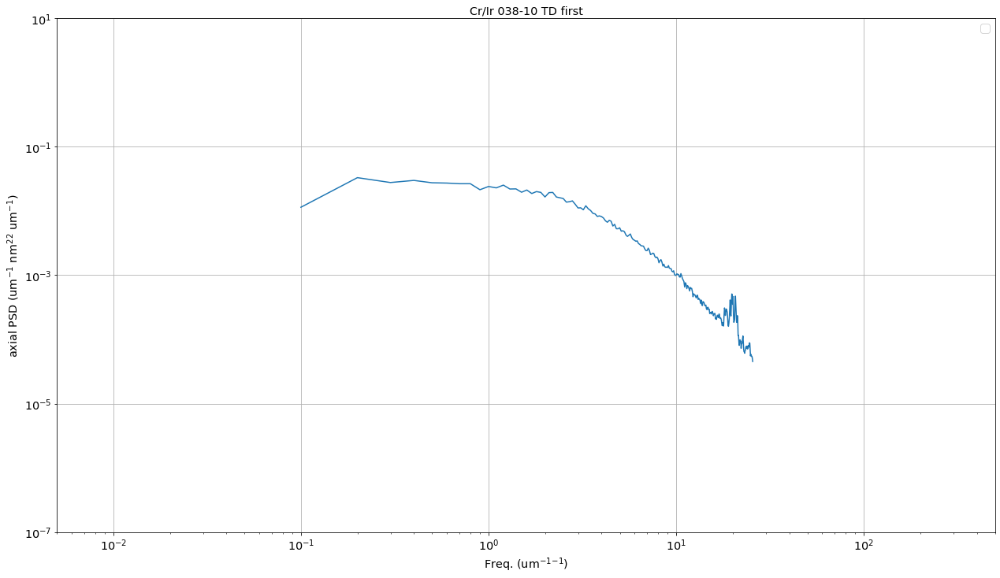

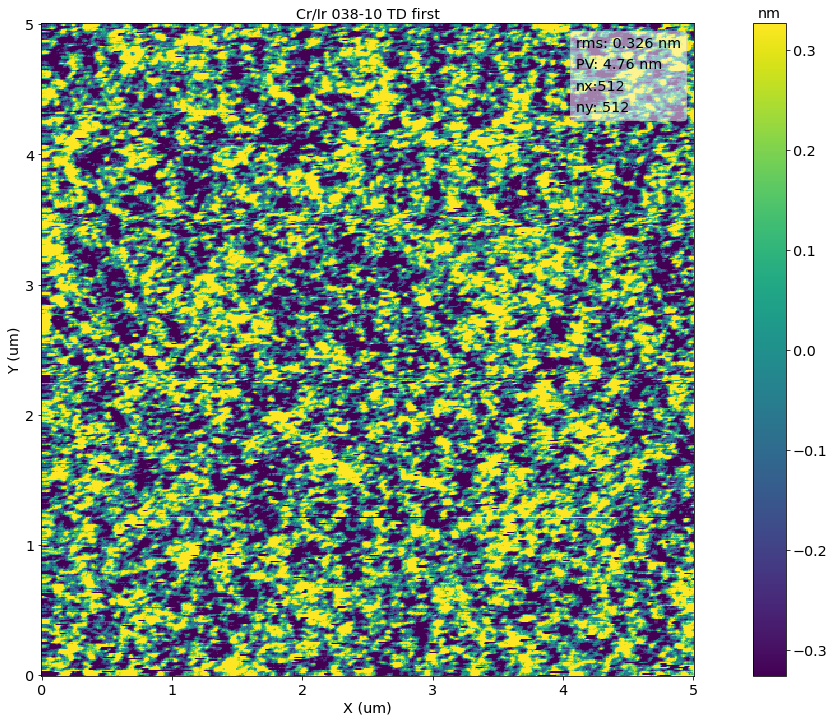

<Figure size 1536x864 with 0 Axes>

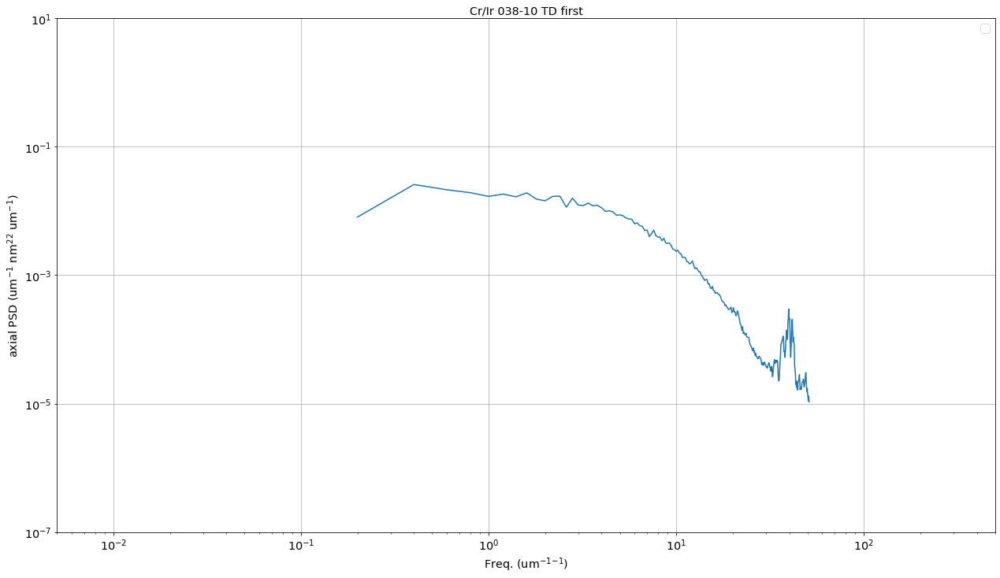

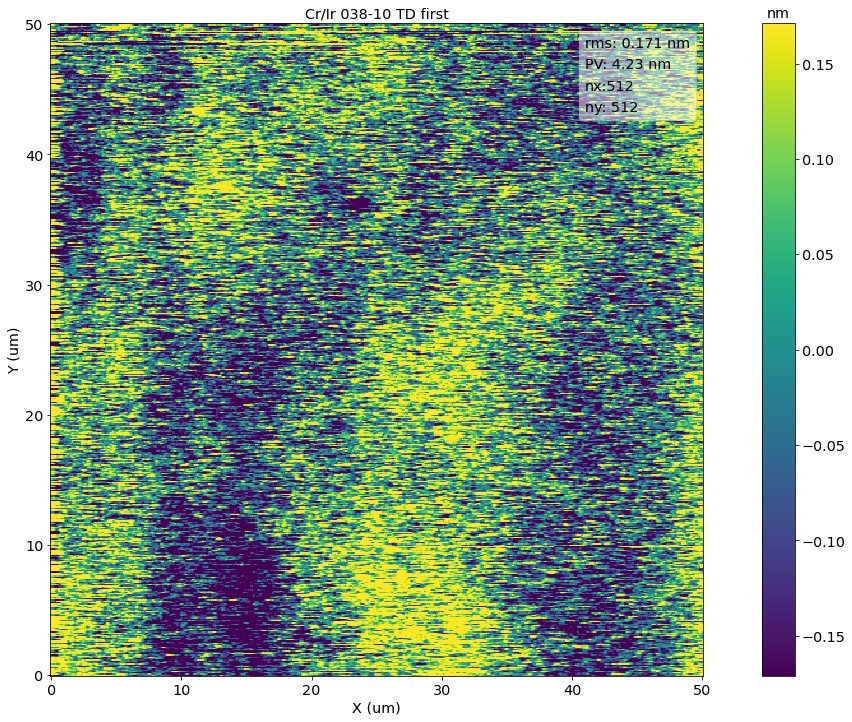

<Figure size 1536x864 with 0 Axes>

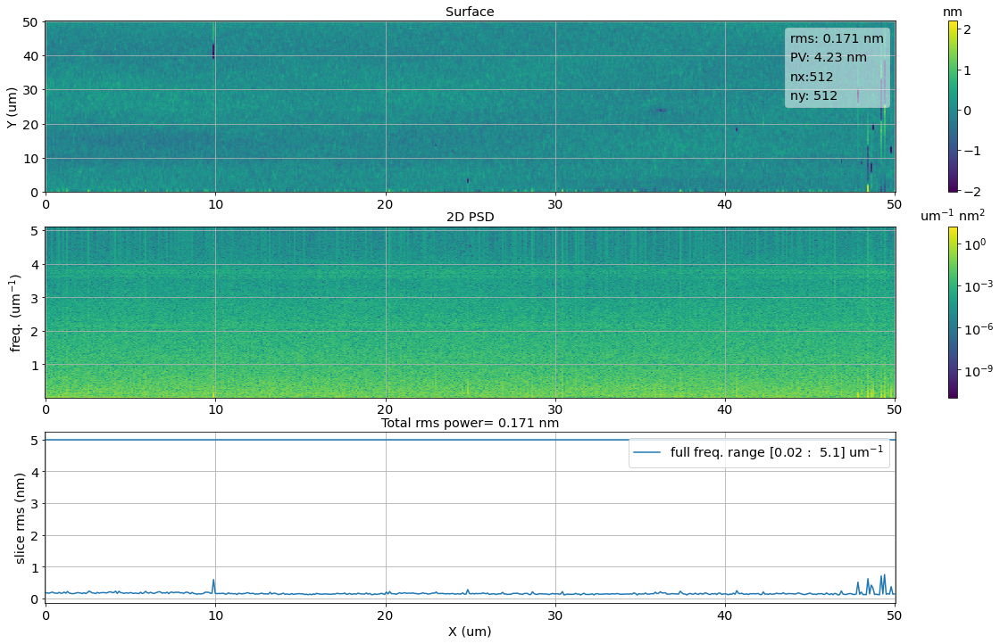

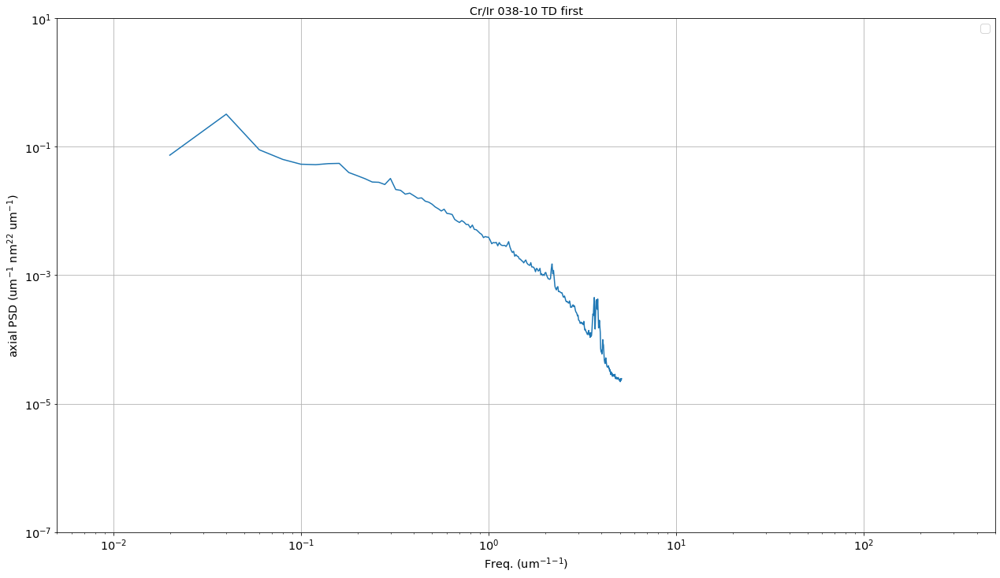

In [39]:
datafolder = r'G:\My Drive\progetti\c_overcoating\esperimenti\20210129_dopamine\20210224_dopamine_clean'
df=['04_03810_001um.nid',    #1 
'05_03810_010um.nid',    
'06_03810_005um.nid',    
'07_03810_050um.nid']    
files = [os.path.join(r'G:\My Drive\progetti\c_overcoating\esperimenti\20210129_dopamine\20210215_M01_AFM',
                      f) for f in df]

outfolder = os.path.join(outdir,r'surface\038-10_first')
name = 'Cr/Ir 038-10 TD first'

dopsd(files,name,outfolder,rmsthr= 5,psdrange=[1e-7,10],frange=[5e-3,5e2])
labels =['AFM - 1 um','AFM - 10 um','AFM - 5 um','AFM - 50 um']
datadic[name] = [[os.path.join(outfolder,f) for f in df],labels]

In [28]:
from pySurf.readers.nid_reader import read_nid

a = read_nid(f)
data,x,y = a['Gr0-Ch1']
d = Data2D(data,x,y,units=['um','um','nm'],scale=[1000000.,1000000.,1000000000.],name=name) 

def dopsd(files,name,outfolder=None,rmsthr=None,psdrange=None,frange=None):
    """from review."""
    plt.close('all')
    
    os.makedirs(outfolder,exist_ok=True)
    psds = []
    for f in files:
        try:
            # replace with data,x,y = read_nid
            # units um,um,mm; scae=1e,1e6,1e96
            print (f)

            # custom edit for some files, level all deg 2 along x (individual lines) in dd
            if f == 'Image00098.nid':
                d=d.crop(None,[30.,45])
            rmsthr= 0.0007 if f == 'Image00095.nid' else rmsthr
            dd = d.level(2,axis=1)  

            # plot
            plt.figure(1) #,figsize=(10,8))
            plt.clf()  
            dd.plot(stats=1,nsigma=1)
            if outfolder:
                plt.savefig(os.path.join(outfolder,fn_add_subfix(f,'','.png',strip=True)))
            
            #psd of transposed
            dd=dd.transpose()
            #pdb.set_trace()
            p2 = dd.psd(analysis=True,fignum=2,rmsthr=rmsthr)
            if outfolder:
                plt.savefig(os.path.join(outfolder,fn_add_subfix(f,'_psd2d','.png',strip=True)))
            
            # average psd
            fs,ps = p2.avgpsd()
            plt.figure(3) #,figsize=(10,8))
            plot_psd(fs,ps,units=psd_units(p2.units))
            plt.ylim(psdrange)
            plt.xlim(frange)
            plt.title(name)
            
            # make outputs 
            psds.append([fs,ps])
            if outfolder:
                np.savetxt(os.path.join(outfolder,fn_add_subfix(f,'_psd','.dat',strip=True)),
                    np.vstack([fs,ps]).T,header='# '+','.join(psd_units(p2.units)[1:]))
                plt.savefig(os.path.join(outfolder,fn_add_subfix(f,'_psd','.png',strip=True)))
            #    np.savetxt(os.path.join(outfolder,fn_add_subfix(f,'_psd','.dat',strip=True)),
            #        np.vstack([fs,ps]).T,header='# '+','.join(psd_units(['mm','mm','nm'])[1:]))
        
        except KeyError:
            pass
        
    return psds
        

In [580]:
datafolder = r'G:\My Drive\progetti\c_overcoating\esperimenti\20210129_dopamine\20210224_dopamine_clean'
df=['01_C03609_001um.nid',    #1 
'02_C03609_010um.nid',    
'03_C03609_010um.nid',    
'04_C03609_050um.nid']    
files = [os.path.join(r'G:\My Drive\progetti\c_overcoating\esperimenti\20210129_dopamine\20210212_dopamine01_AFM',
                      f) for f in df]

outfolder = os.path.join(outdir,r'surface\036-09bare')
name = 'bare Si plate'

dopsd(files,name,outfolder,rmsthr= 5,psdrange=[1e-7,10],frange=[5e-3,5e2])
labels =['AFM - 1 um','AFM - 10 um','AFM - 10 um','AFM - 50 um']
datadic[name] = [[os.path.join(outfolder,f) for f in df],labels]

G:\My Drive\progetti\c_overcoating\esperimenti\20210129_dopamine\20210212_dopamine01_AFM\01_C03609_001um.nid


UnboundLocalError: local variable 'd' referenced before assignment

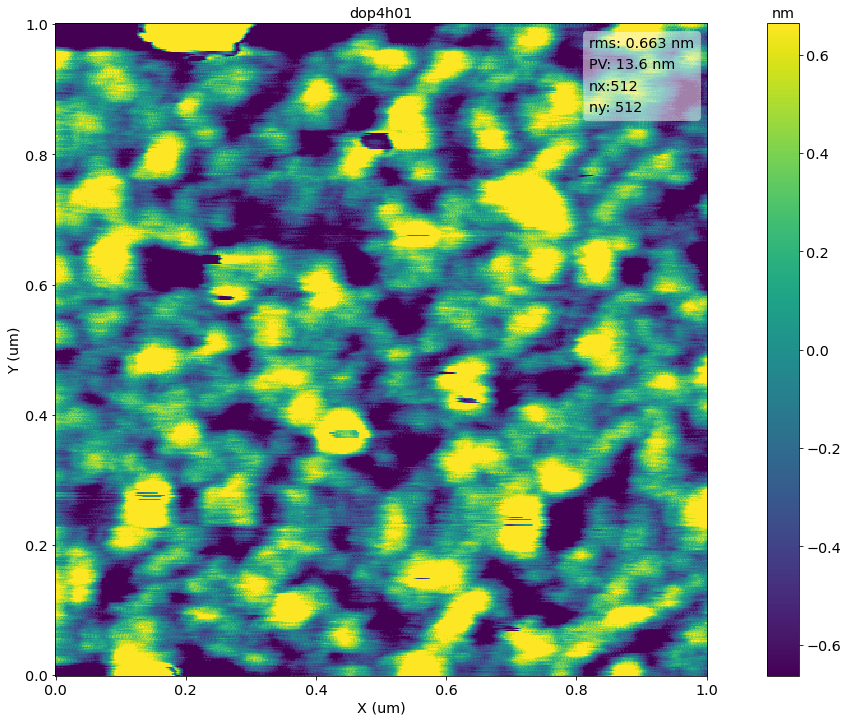

<Figure size 1536x864 with 0 Axes>

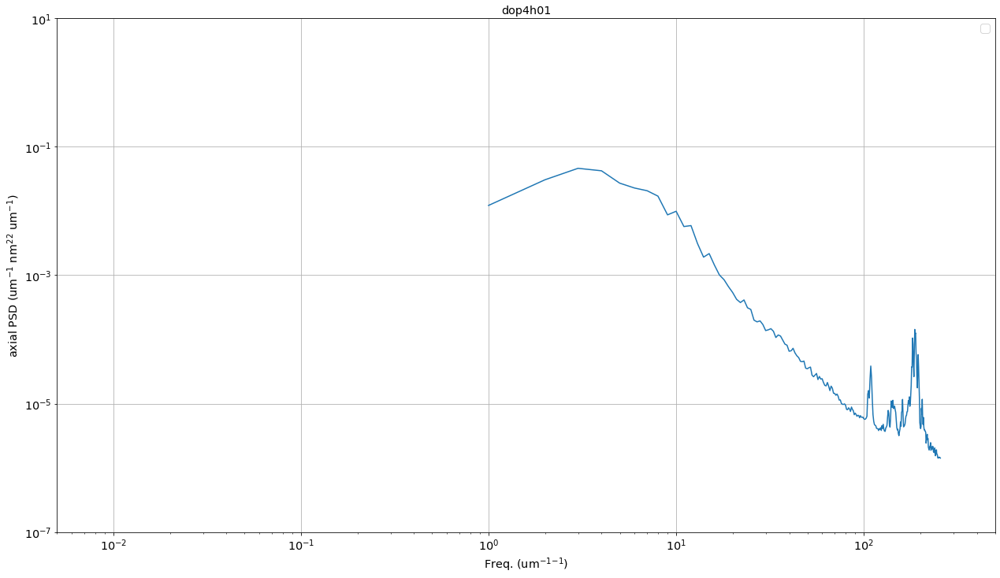

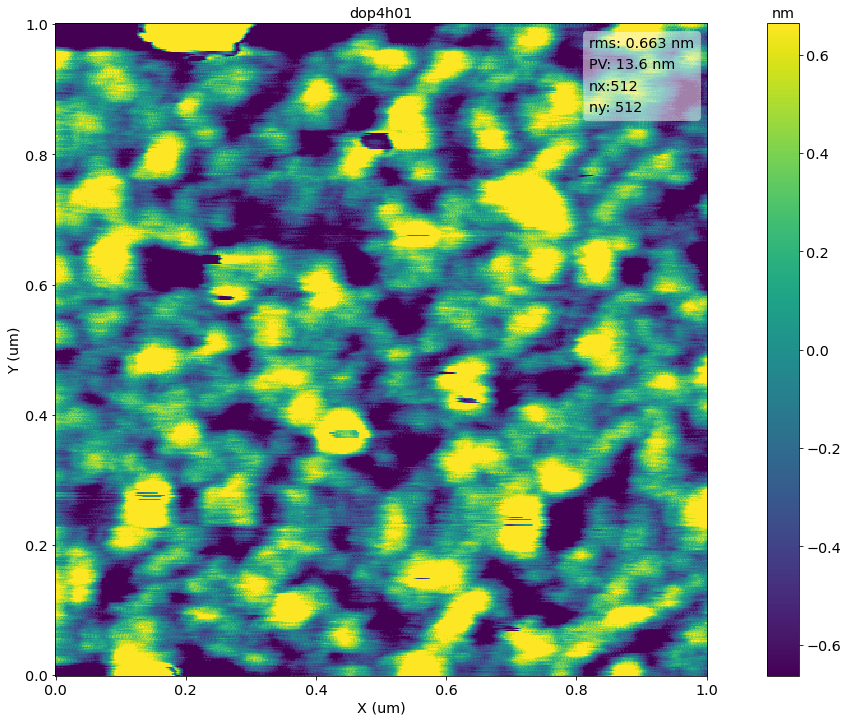

<Figure size 1536x864 with 0 Axes>

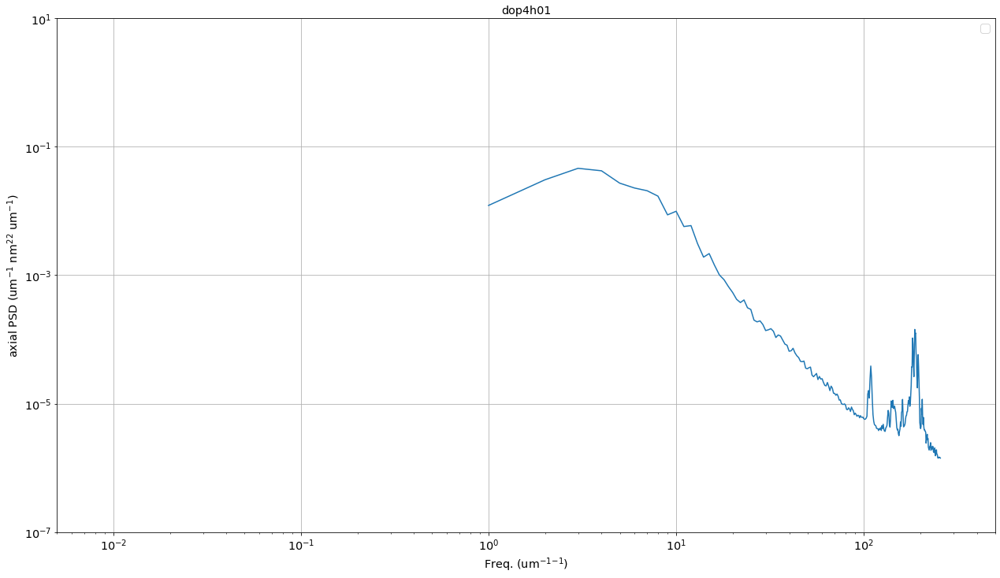

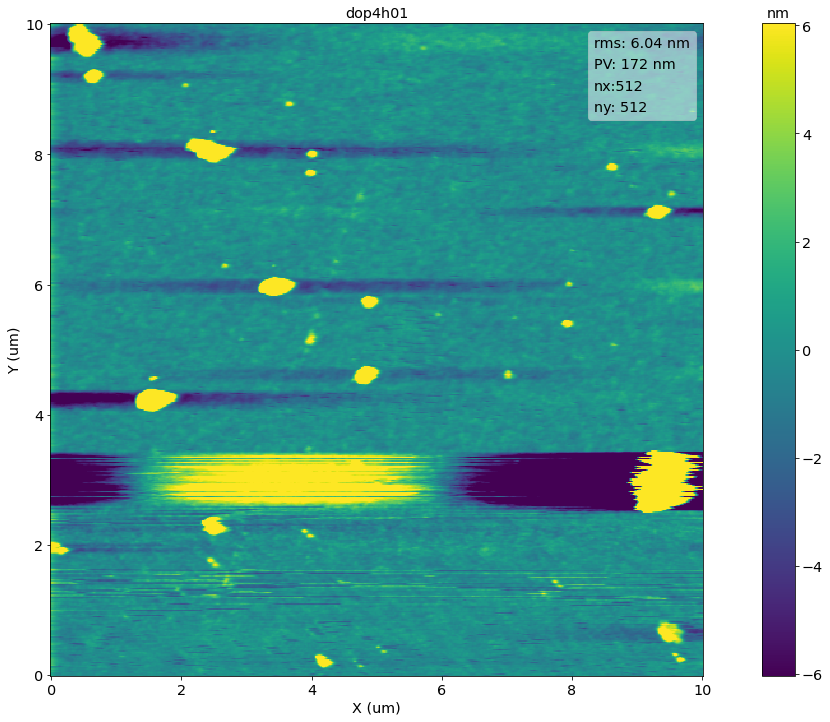

<Figure size 1536x864 with 0 Axes>

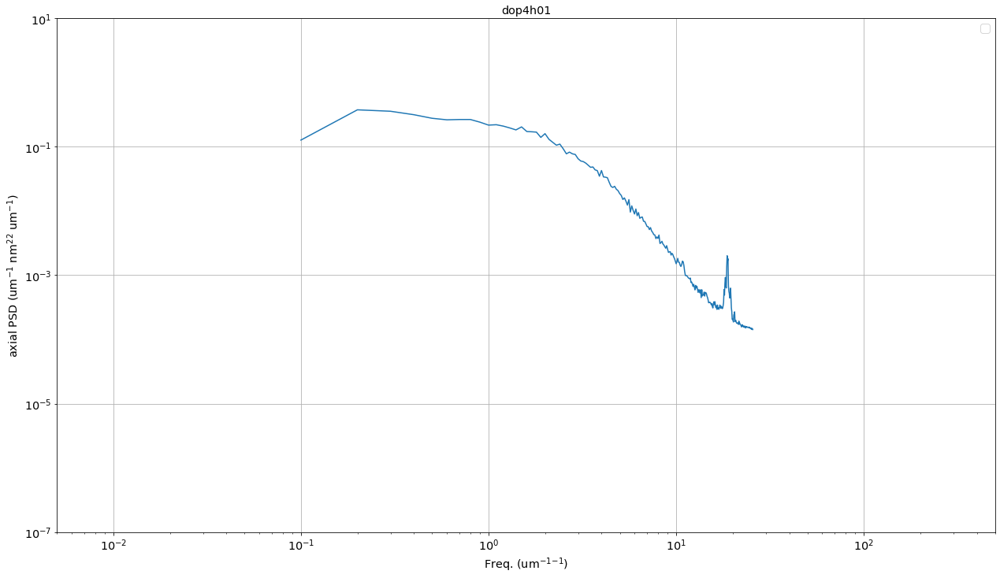

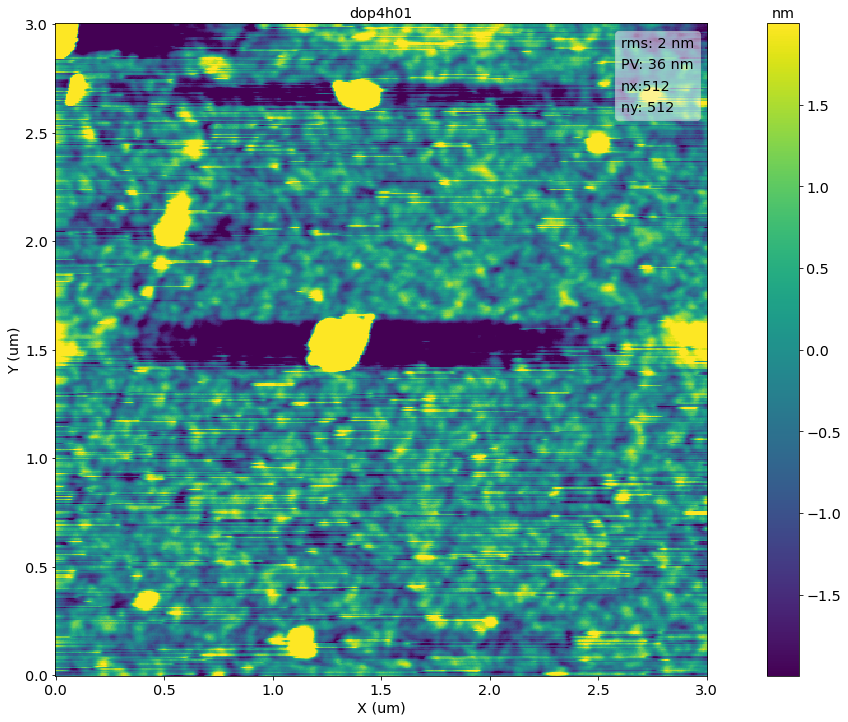

<Figure size 1536x864 with 0 Axes>

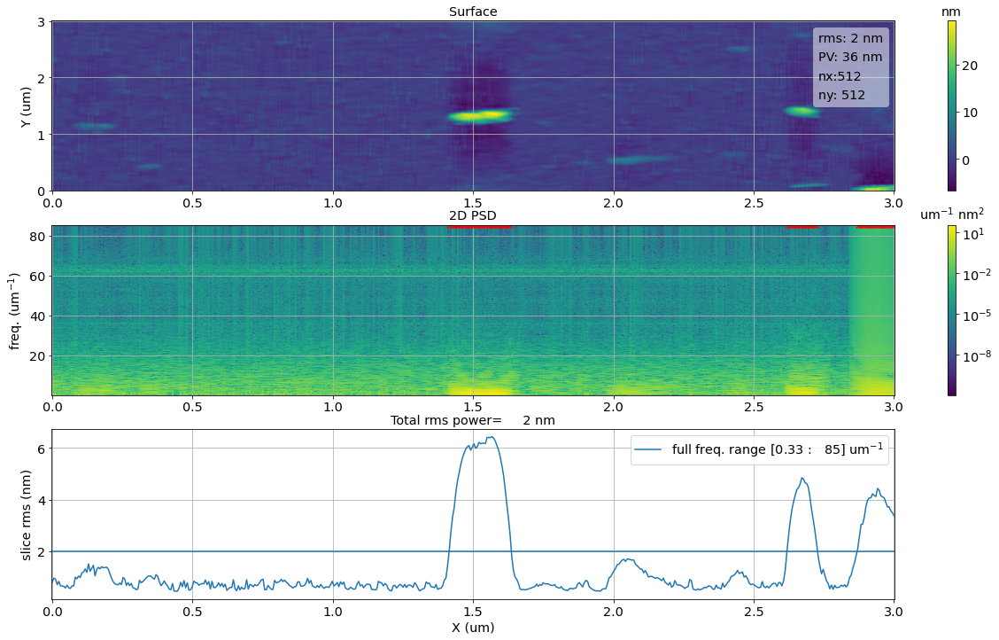

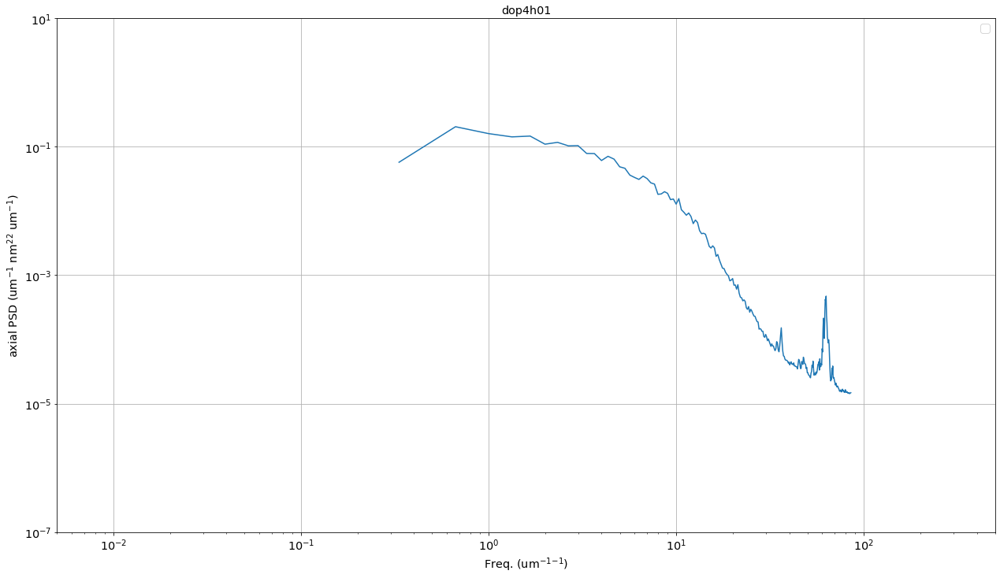

In [41]:
datafolder = r'G:\My Drive\progetti\c_overcoating\esperimenti\20210129_dopamine\20210224_dopamine_clean'
df=['05_dop4h01_001um.nid',    #1 
'06_dop4h01_001um.nid',    
'07_dop4h01_010um.nid',    
'08_dop4h01_003um.nid']    
files = [os.path.join(r'G:\My Drive\progetti\c_overcoating\esperimenti\20210129_dopamine\20210212_dopamine01_AFM',
                      f) for f in df]

outfolder = os.path.join(outdir,r'surface\dop4h01')
name = 'dop4h01'

dopsd(files,name,outfolder,rmsthr= 2,psdrange=[1e-7,10],frange=[5e-3,5e2])
labels =['AFM - 1 um','AFM - 1 um','AFM - 10 um','AFM - 3 um']
datadic[name] = [[os.path.join(outfolder,f) for f in df],labels]

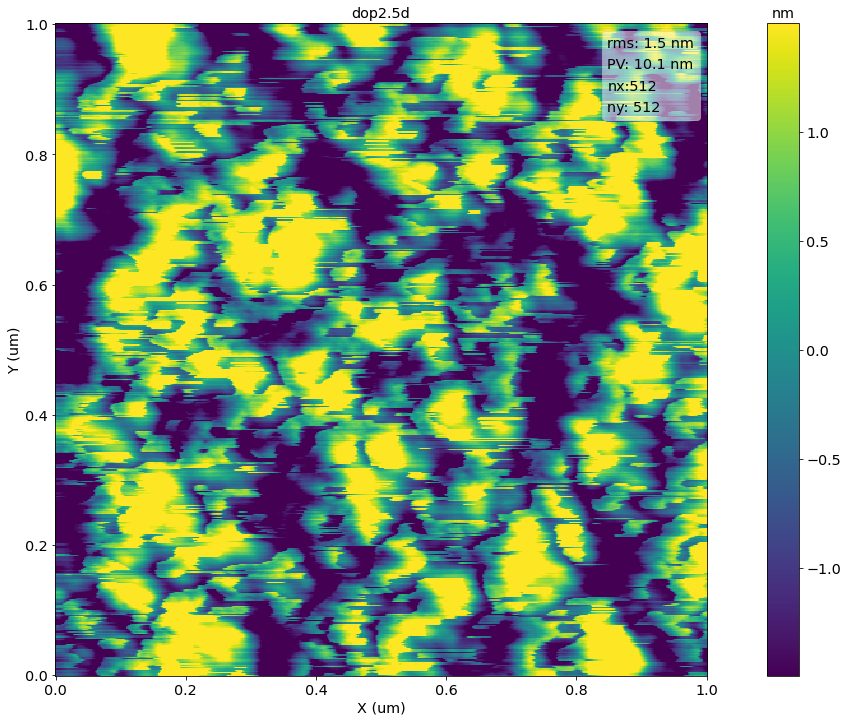

<Figure size 1536x864 with 0 Axes>

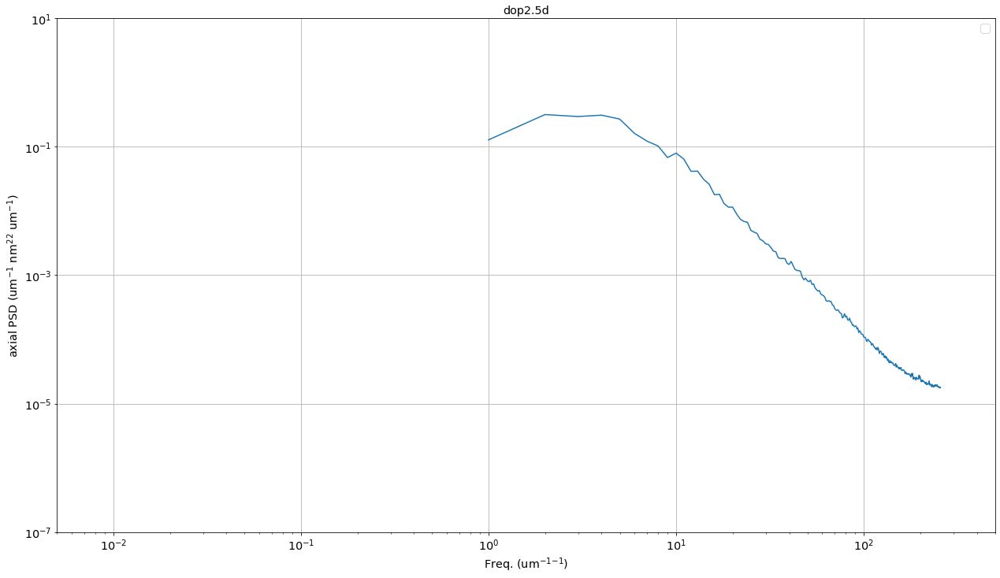

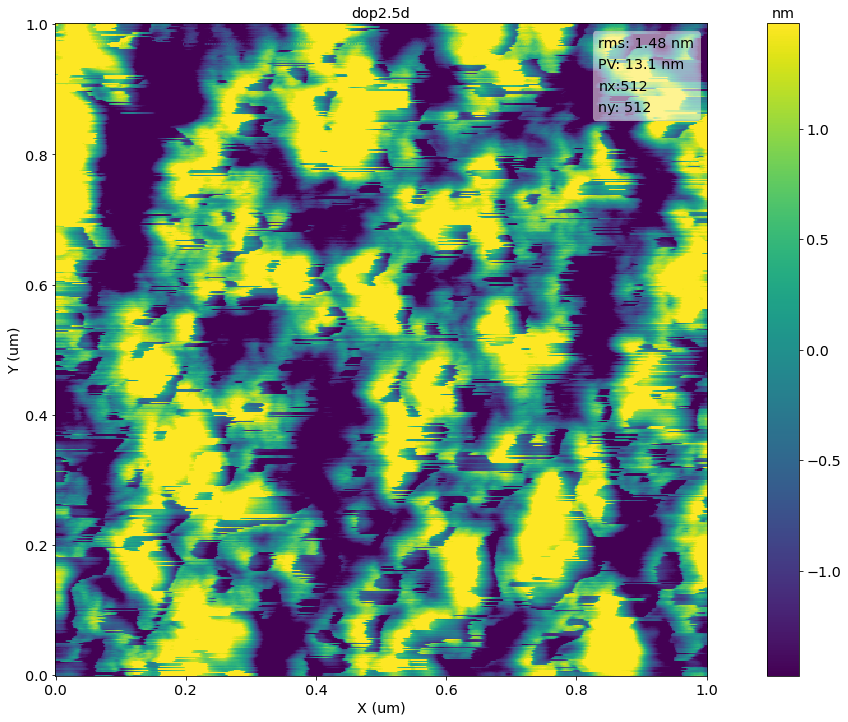

<Figure size 1536x864 with 0 Axes>

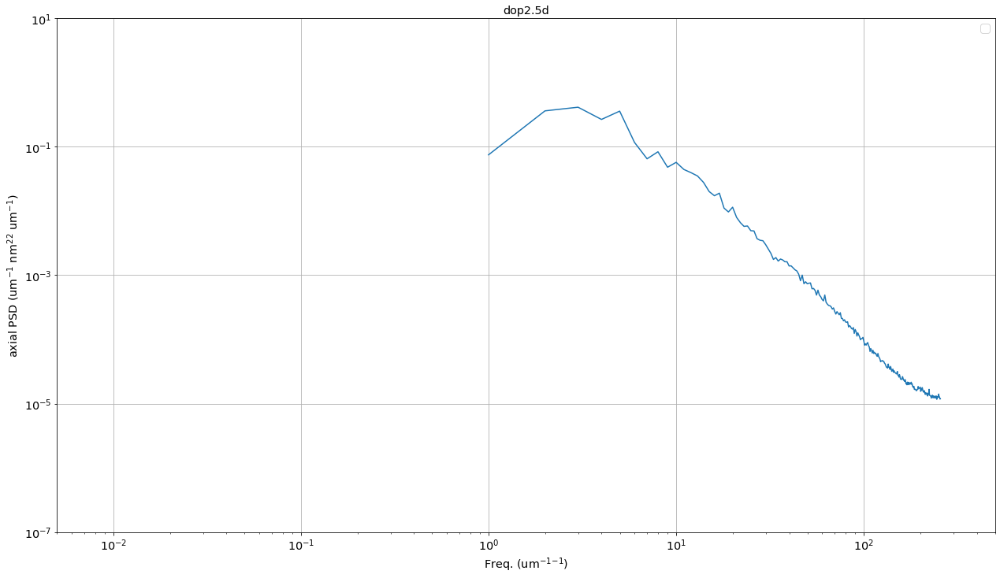

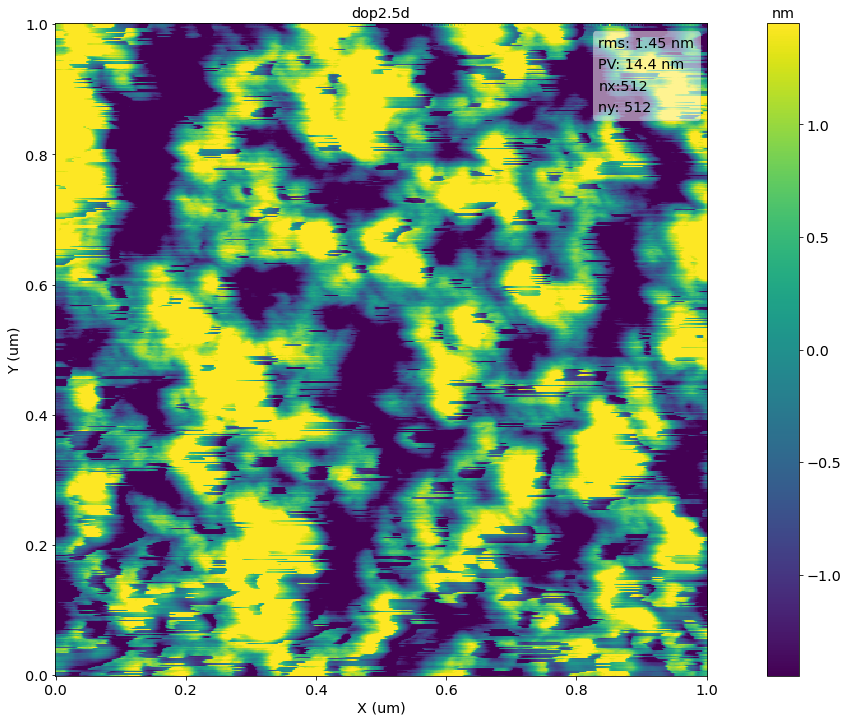

<Figure size 1536x864 with 0 Axes>

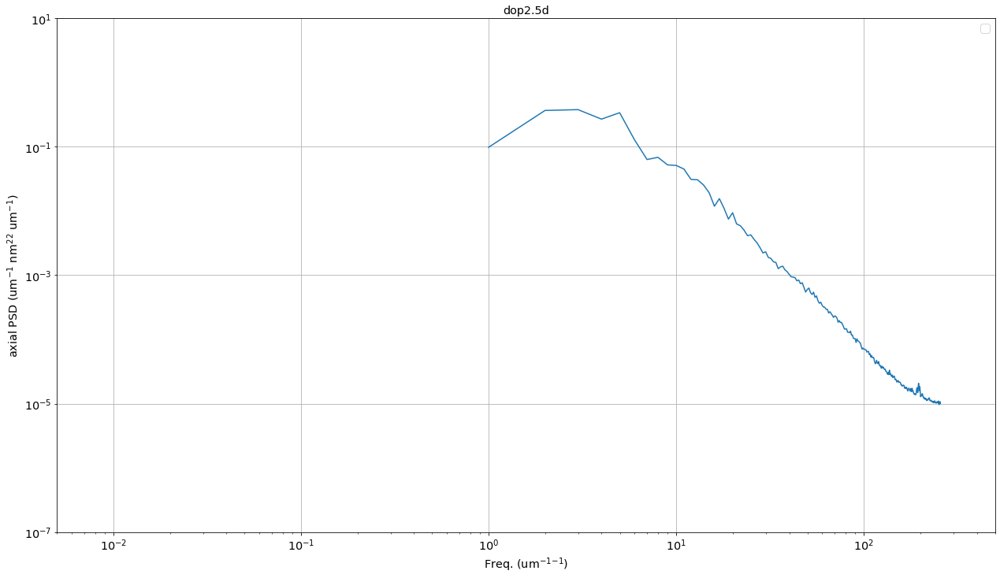

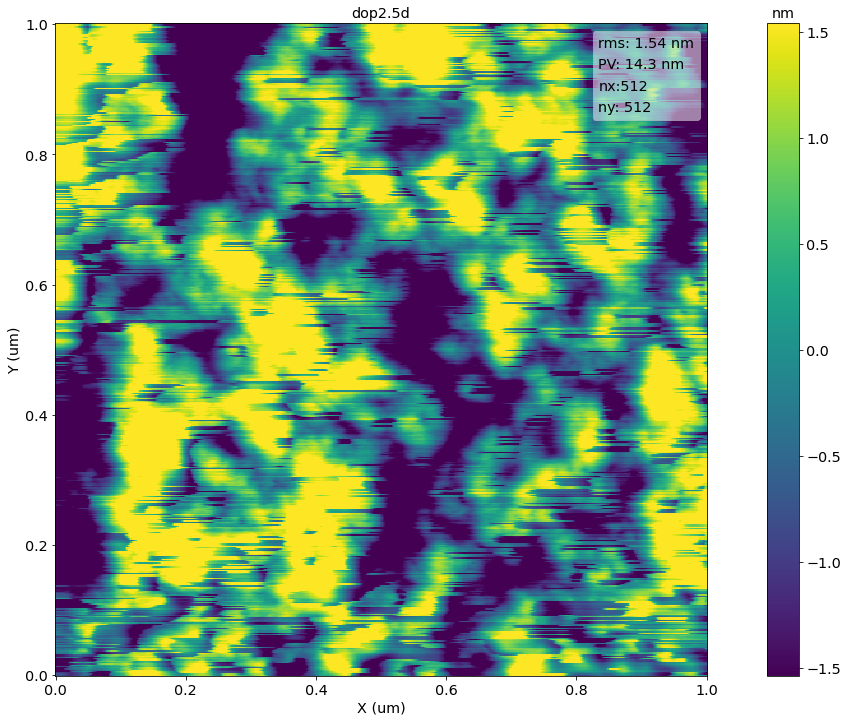

<Figure size 1536x864 with 0 Axes>

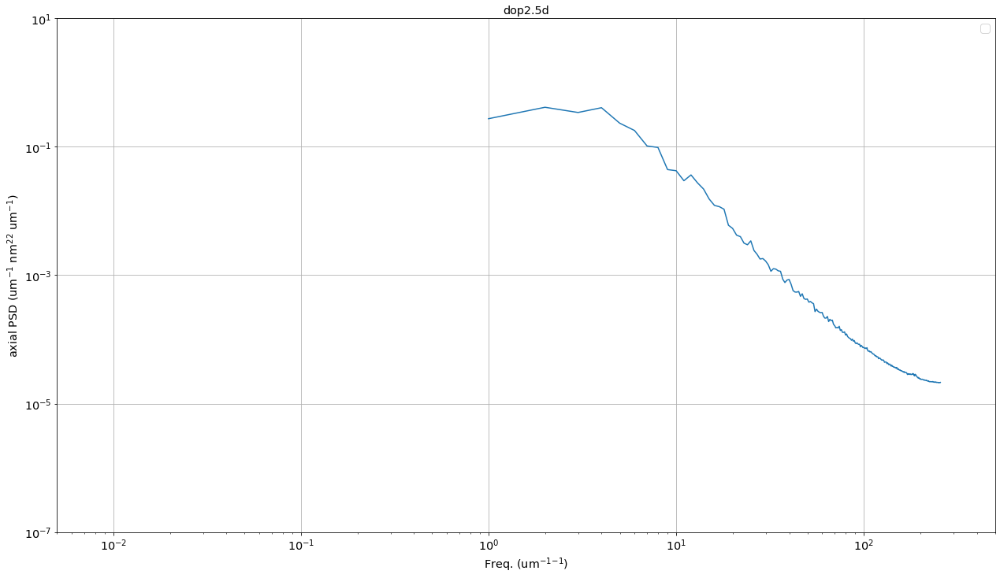

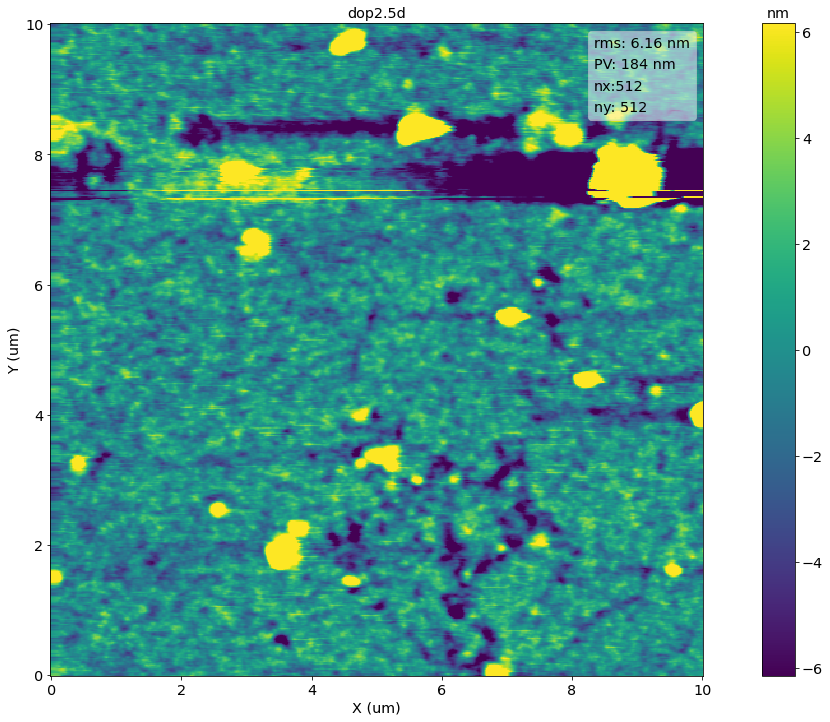

<Figure size 1536x864 with 0 Axes>

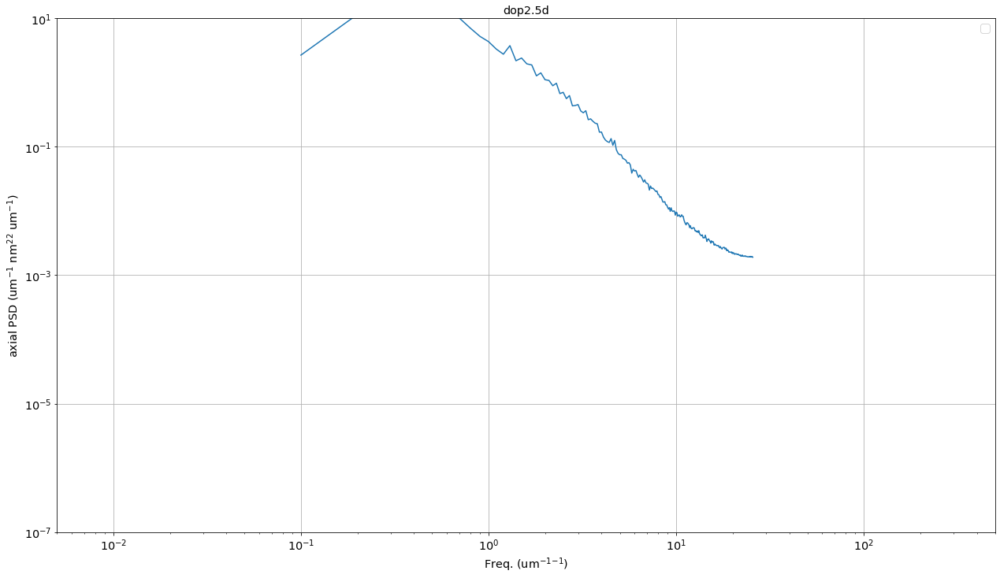

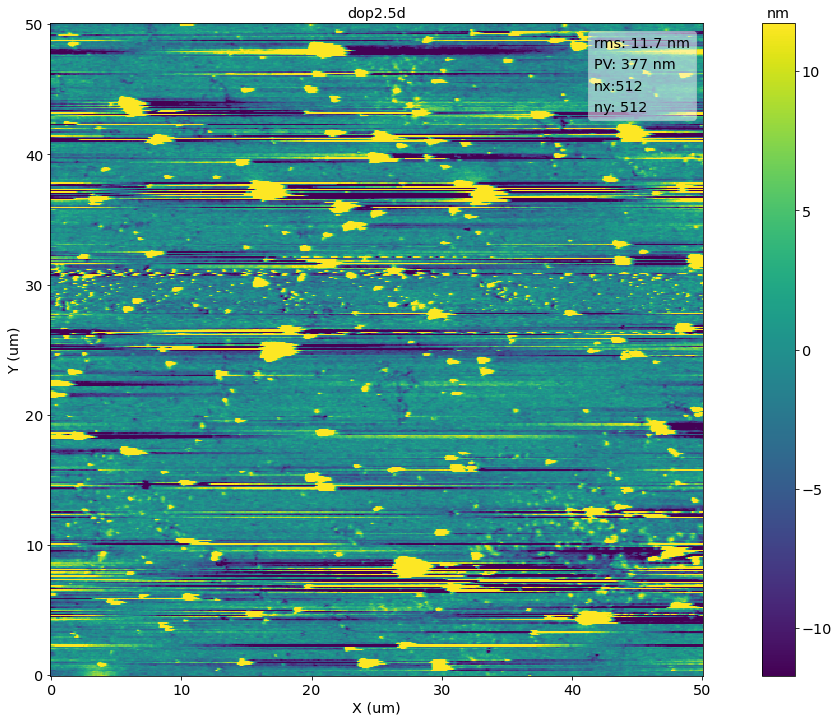

<Figure size 1536x864 with 0 Axes>

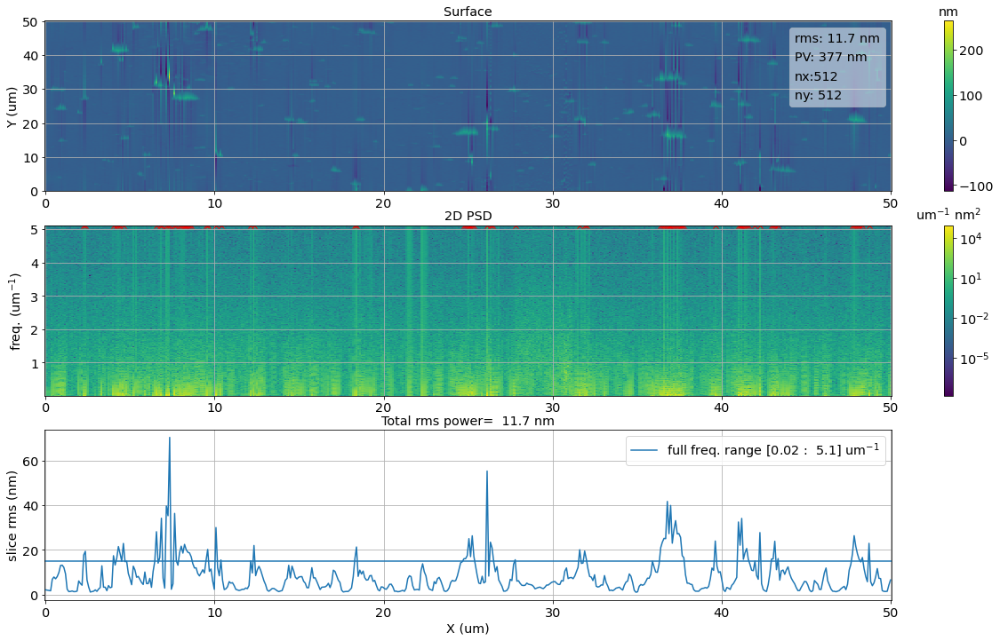

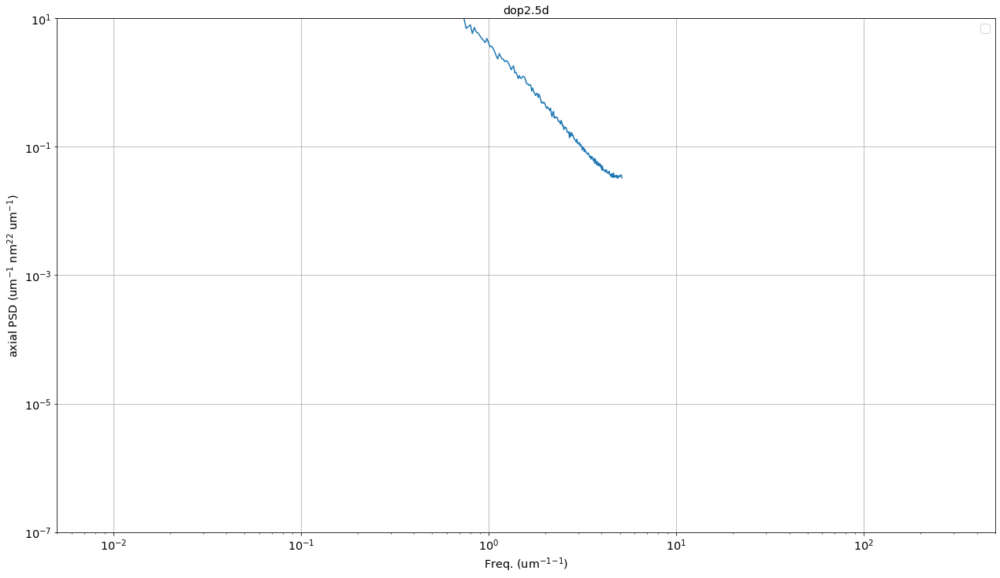

In [42]:
datafolder = r'G:\My Drive\progetti\c_overcoating\esperimenti\20210129_dopamine\20210224_dopamine_clean'
df=['09dop2.5d_001um.nid',    #1 
'10dop2.5d_001um.nid',    
'11dop2.5d_001um.nid', 
'12dop2.5d_001um.nid', 
'13dop2.5d_010um.nid', 
'14dop2.5d_050um.nid']   
files = [os.path.join(r'G:\My Drive\progetti\c_overcoating\esperimenti\20210129_dopamine\20210212_dopamine01_AFM',
                      f) for f in df]

outfolder = os.path.join(outdir,r'surface\dop2.5d')
name = 'dop2.5d'

dopsd(files,name,outfolder,rmsthr= 15,psdrange=[1e-7,10],frange=[5e-3,5e2])
labels =['AFM - 1 um','AFM - 1 um','AFM - 1 um','AFM - 1 um','AFM - 10 um','AFM - 50 um']
datadic[name] = [[os.path.join(outfolder,f) for f in df],labels]

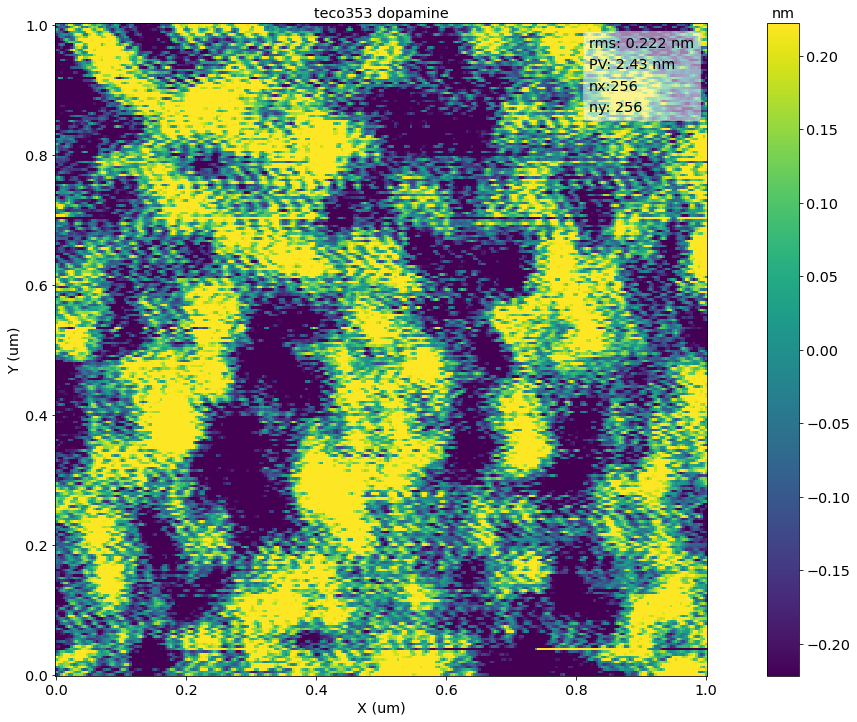

<Figure size 1536x864 with 0 Axes>

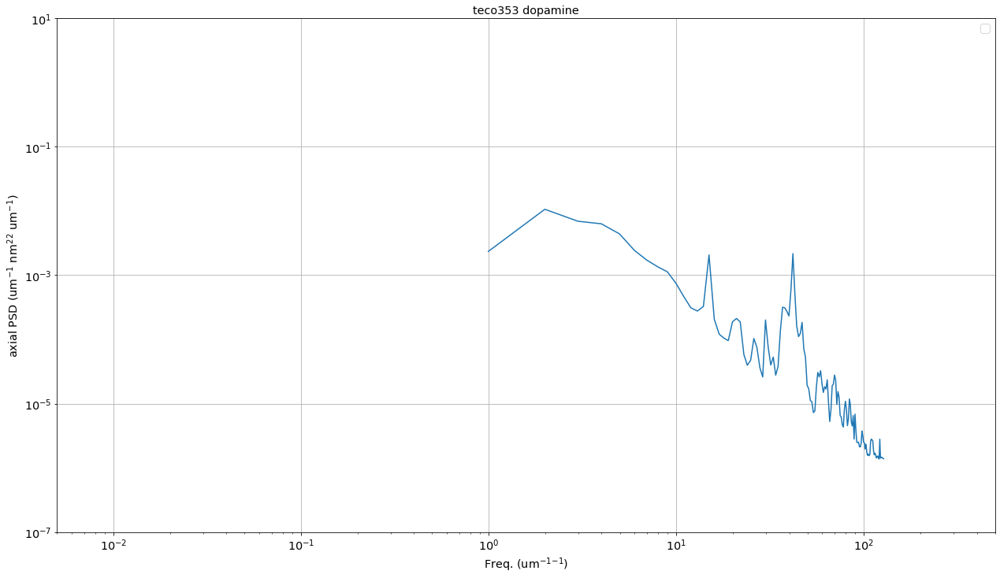

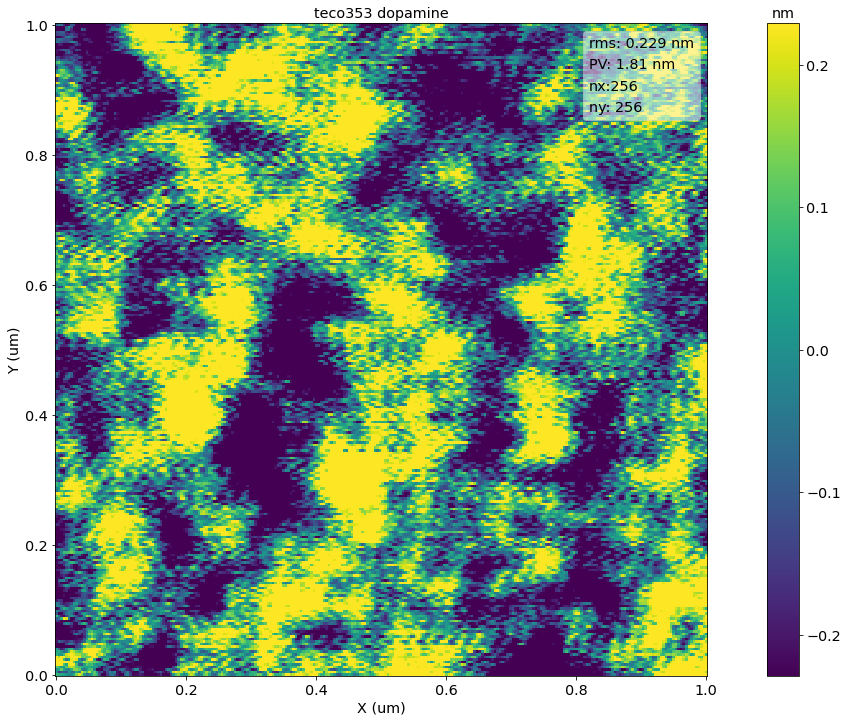

<Figure size 1536x864 with 0 Axes>

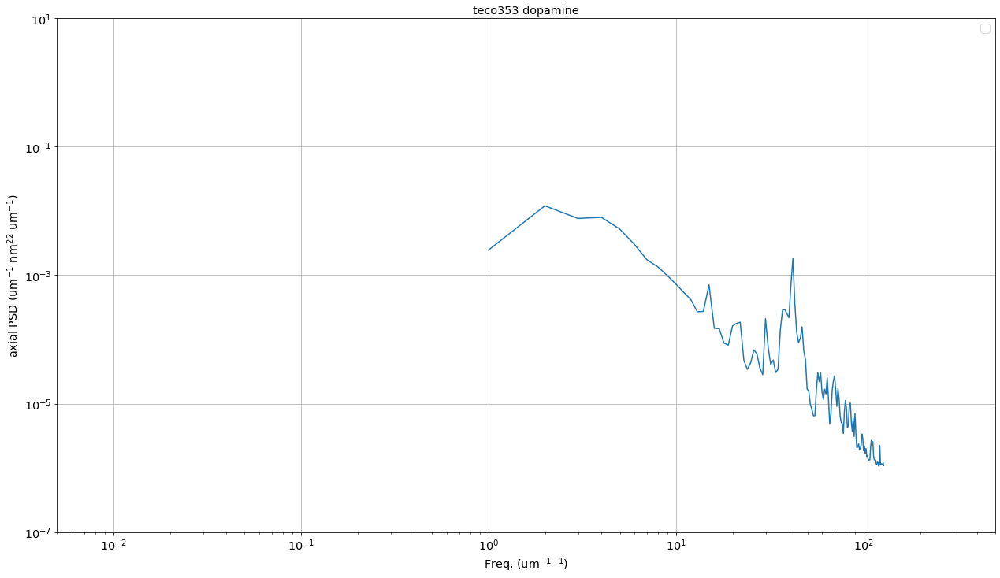

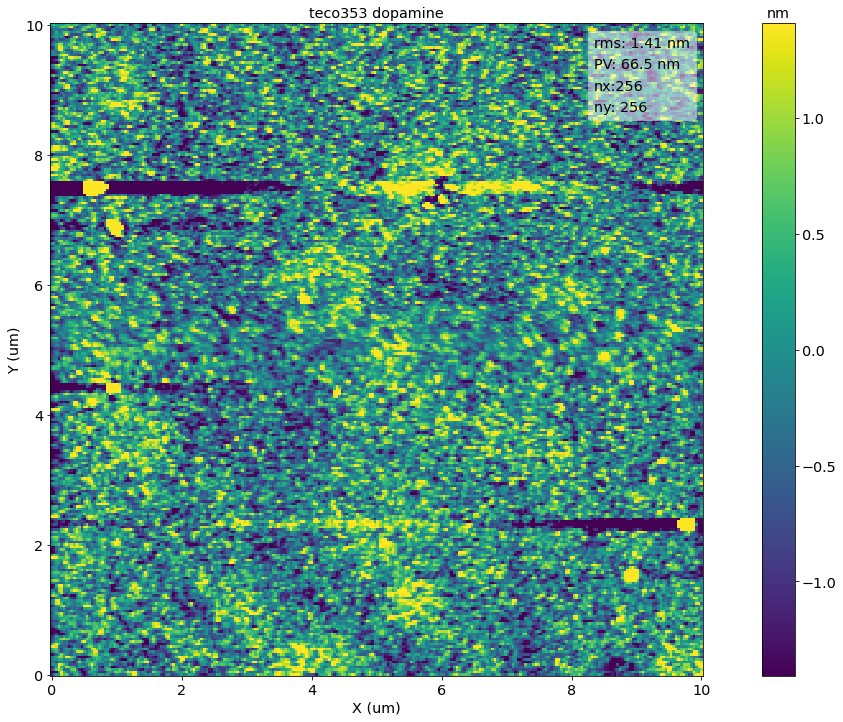

<Figure size 1536x864 with 0 Axes>

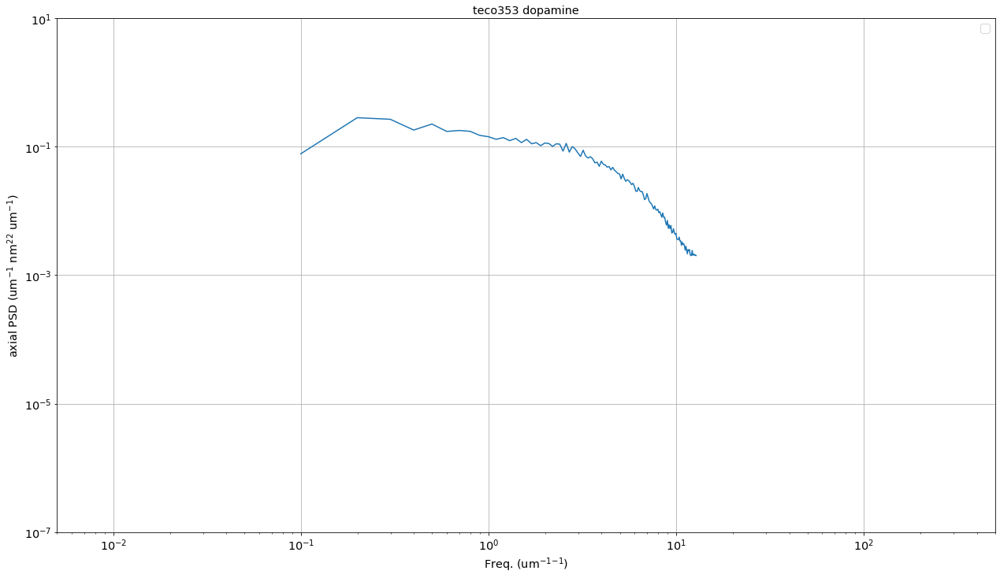

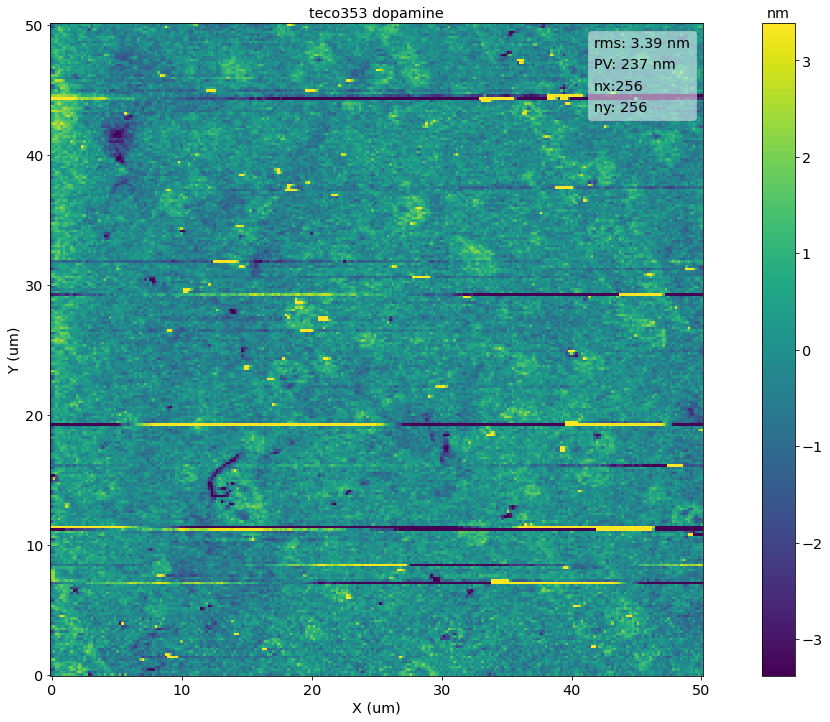

<Figure size 1536x864 with 0 Axes>

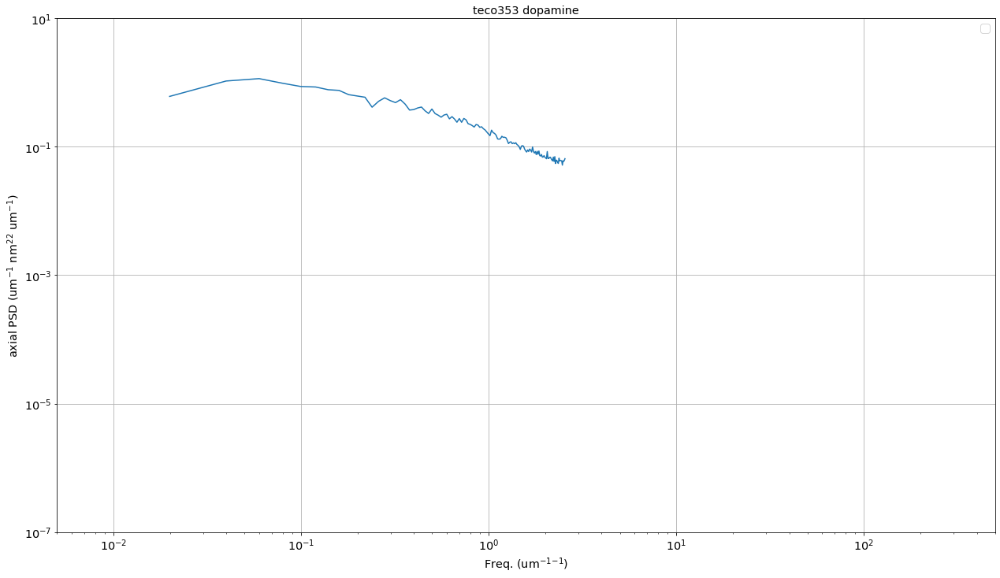

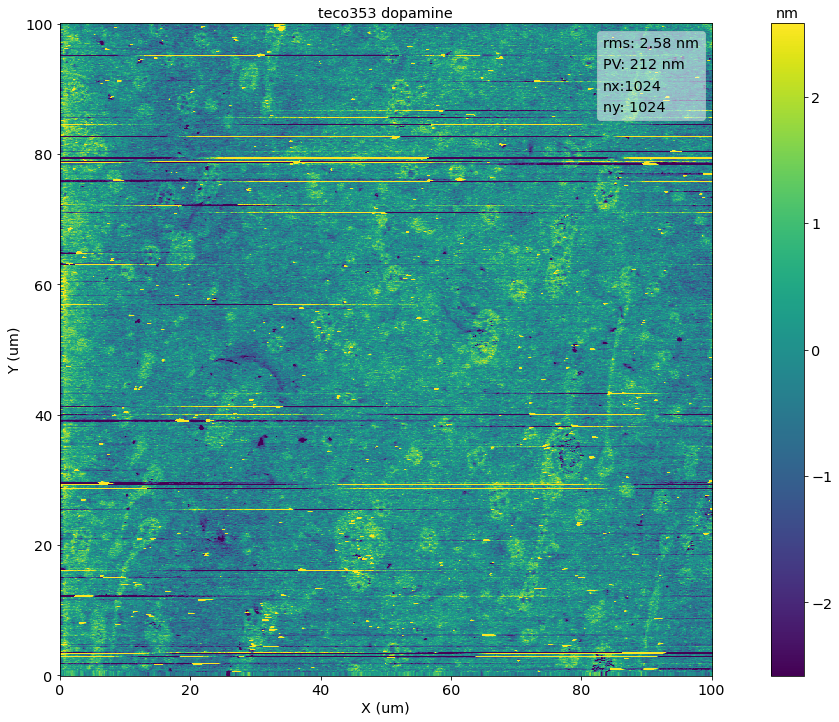

<Figure size 1536x864 with 0 Axes>

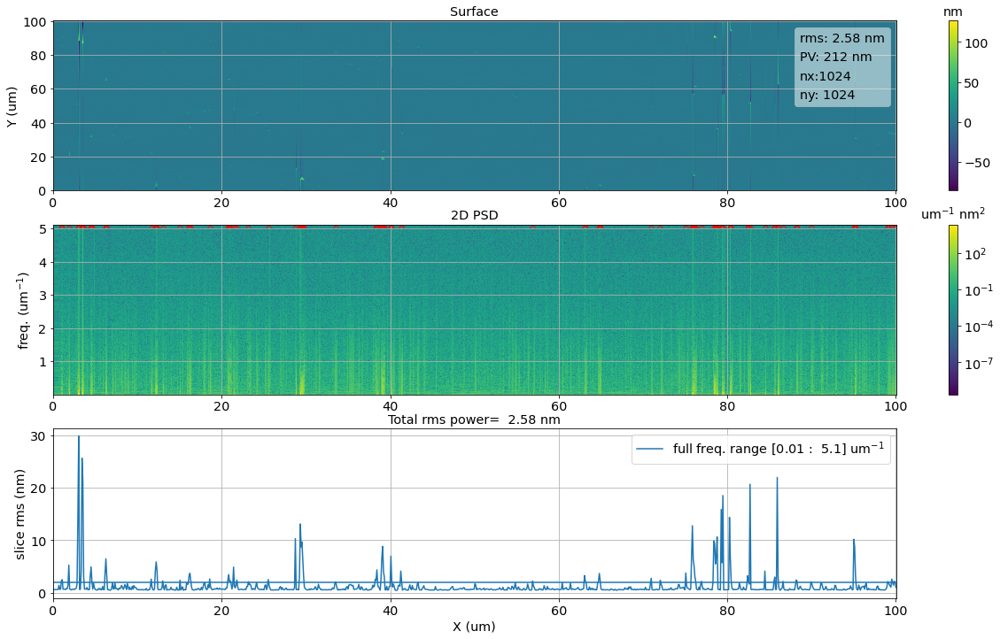

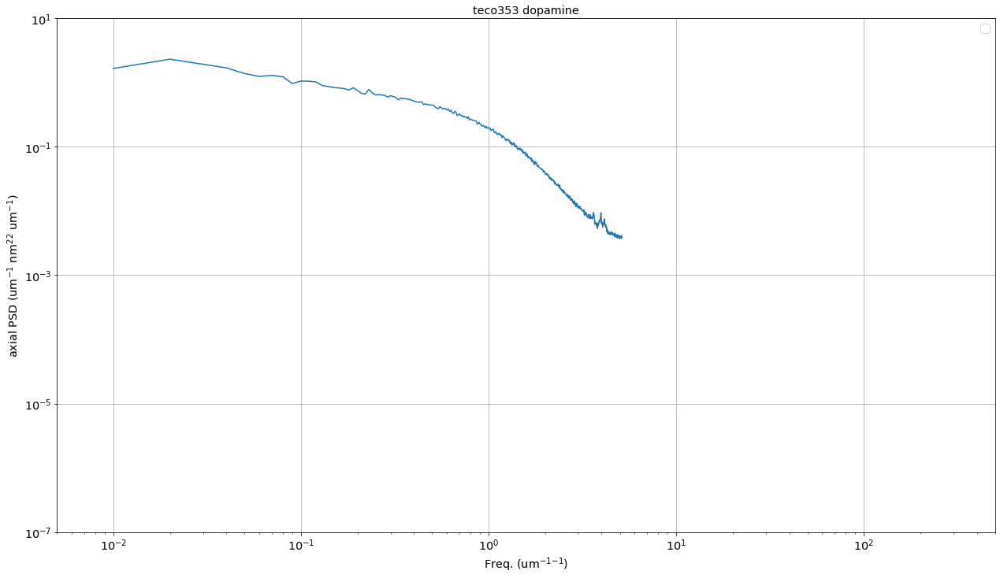

In [43]:
datafolder = r'G:\My Drive\progetti\c_overcoating\esperimenti\20210129_dopamine\20210224_dopamine_clean'
df=['Image00083.nid', #teco353 IrCrDop 1  IrCr SR
'Image00084.nid',    #teco353 IrCrDop 1
'Image00053.nid',    #teco353 IrCrDop 10
'Image00054.nid',    #teco353 IrCrDop 50
'Image00056.nid']    #teco353 IrCrDop 100

files = [os.path.join(datafolder,f) for f in df]
outfolder = os.path.join(outdir,r'surface\teco353')
name = 'teco353 dopamine'

dopsd(files,name,outfolder,rmsthr= 2,psdrange=[1e-7,10],frange=[5e-3,5e2])

labels =['AFM - 1 um','AFM - 1 um','AFM - 10 um','AFM - 50 um','AFM - 100 um']
datadic[name] = [[os.path.join(outfolder,f) for f in df],labels]

## MFT DATA

In [44]:
datadic.keys()

dict_keys(['Cr/Ir 038-03 SR', 'Ir 266-06 SR', 'Cr/Ir 038-10 TD', 'Cr/Ir/Cr 126-03 TD', 'Cr/Ir/Cr Dop 4h', 'Cr/Ir 038-10 TD first', 'bare Si plate', 'dop4h01', 'dop2.5d', 'teco353 dopamine'])

In [45]:
from MIRO_analysis_functions import mft_psd

In [ ]:
datafolder = r'G:\My Drive\progetti\c_overcoating\esperimenti\20200214_batch02_IrC\20200403_TD_b1_MFT'

df = ['01_13011_A.csv','02_13011_A.csv','03_13011_A.csv','04_13011_B.csv',
      '08_12602_A.csv','09_12602_B.csv','10_12602_C.csv']
files = [os.path.join(datafolder,f) for f in df]

outfolder = os.path.join(outdir,r'surface\126-03')
#outfolder = r'G:\My Drive\progetti\c_overcoating\esperimenti\20210129_dopamine\20210224_dopamine_clean\results\cos01_IrCr'
name = 'Cr/Ir/Cr 126-03 TD'

mft_psd(files,outfolder=outfolder)

labels =['MFT 10x 130-11','MFT 10x 130-11','MFT 10x 130-11','MFT 10x 130-11',
         'MFT 10x 126-02','MFT 10x 126-02','MFT 10x 126-02']
datadic[name][0].extend([[fn_add_subfix(f,'_MFT','.dat',strip=True,pre=outfolder+os.path.sep) for f in df],labels][0])
datadic[name][1].extend([[fn_add_subfix(f,'_MFT','.dat',strip=True,pre=outfolder+os.path.sep) for f in df],labels][1])

In [34]:
datadic.keys()

dict_keys(['Cr/Ir 038-03 SR'])

## Plot of Datadic

In [ ]:
outdir = r'G:\My Drive\progetti\c_overcoating\esperimenti\results\ICSO2020_analysis'

In [52]:
# uncomment following lines to save (it is also suggested to manually make a backup to avoid 
#  accidental overwriting).

# with open(os.path.join(outdir,'datadic.pkl'), 'wb') as f:
#     pickle.dump(datadic, f, pickle.HIGHEST_PROTOCOL)

In [ ]:
# this reads the last saved file (and overwrite `datadic` variable)
datadic={}
#with open(os.path.join(outdir,'datadic.pkl'), 'rb') as f:
#    datadic = pickle.load(f)

In [ ]:
%qtconsole

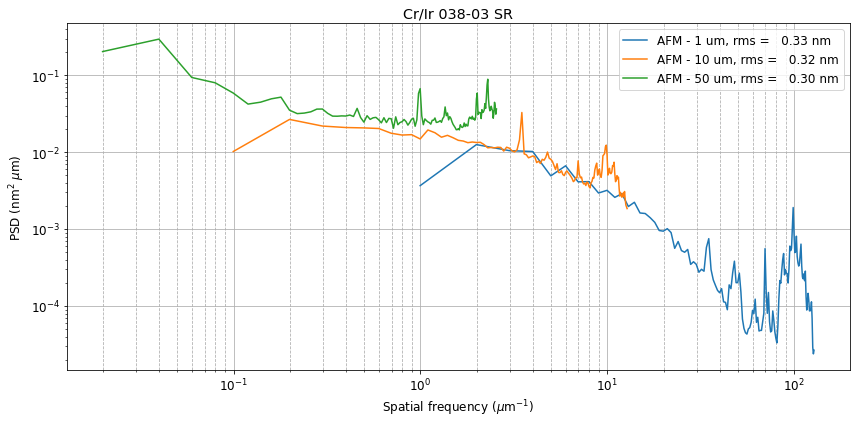

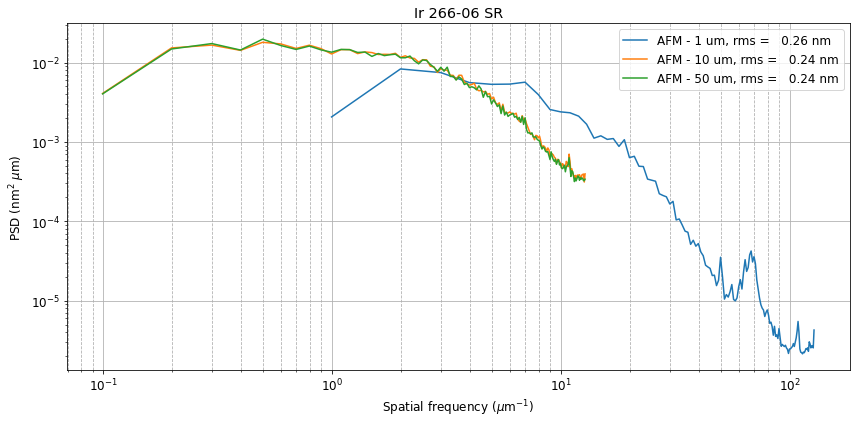

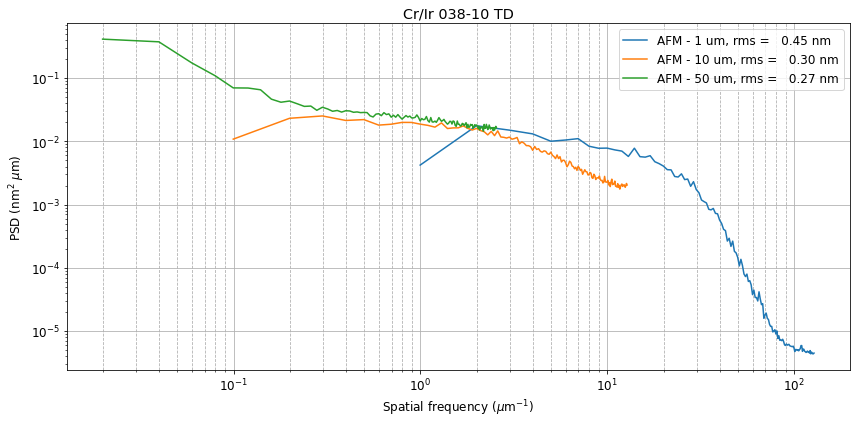

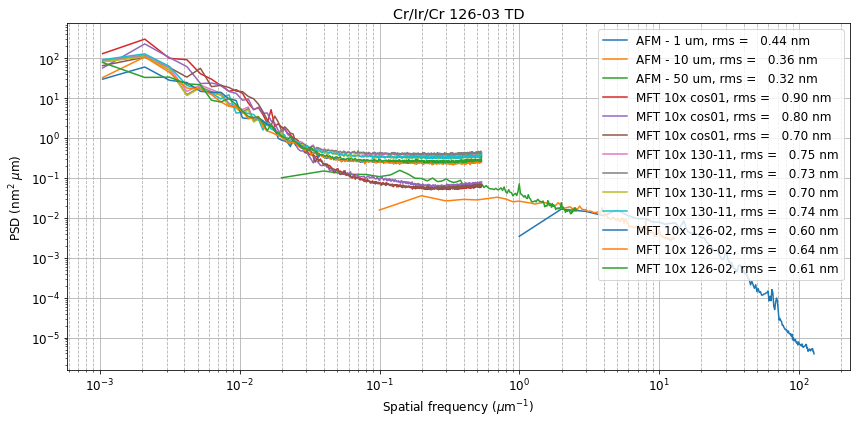

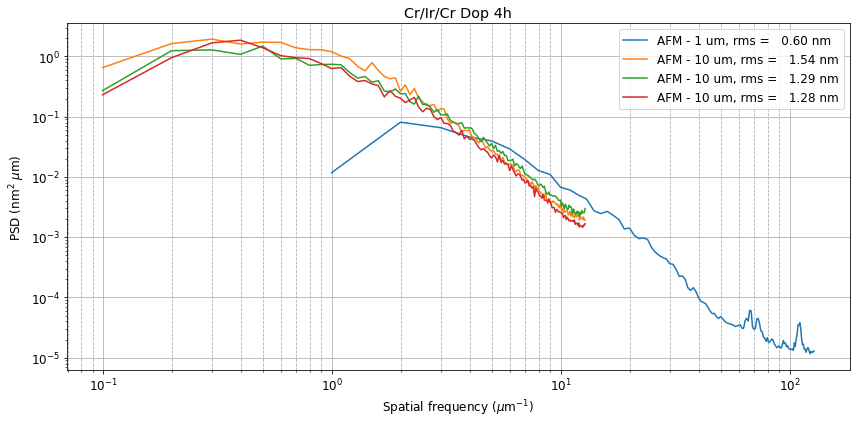

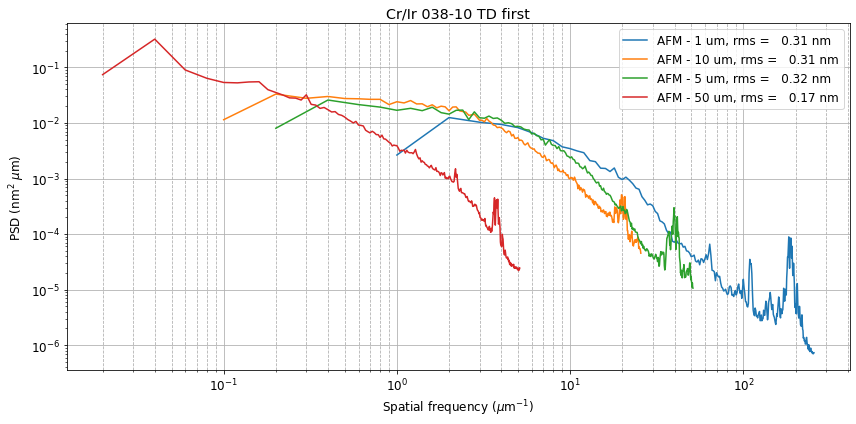

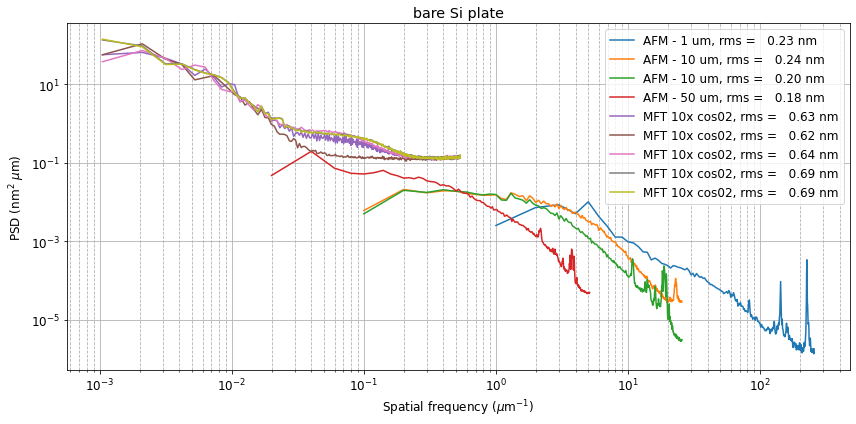

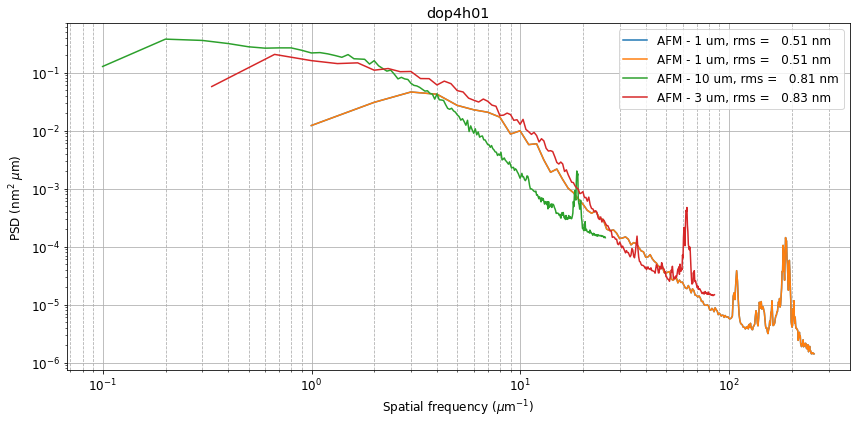

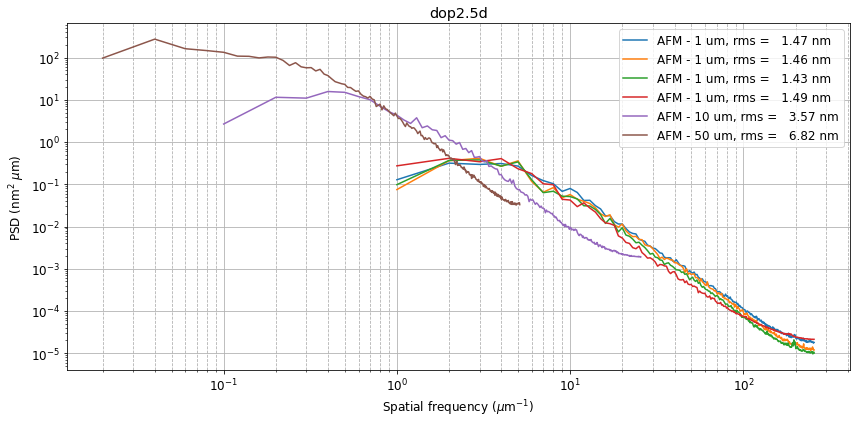

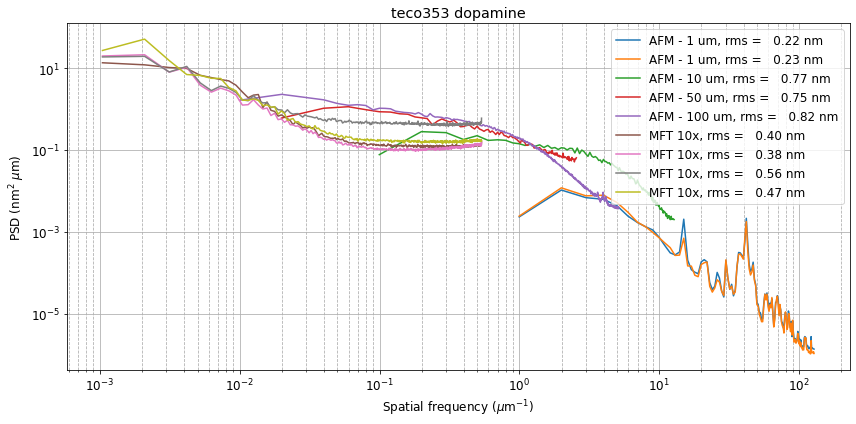

In [53]:
# PLOT ALL PSDS IN DATADIC
plt.close('all')
outfolder = os.path.join(outdir,r'psds','20210227_all_psds')
os.makedirs(outfolder)

plot_all_psds(datadic,outfolder)

In [54]:
a = [os.path.basename(os.path.dirname(d[-1]))
     for d in [datadic[name][0] for name in datadic.keys()]]
b = datadic.keys()
print('keys - name')
for aa,bb in zip(a,b):
    print(bb,' - ',aa)

keys - name
Cr/Ir 038-03 SR  -  038-03
Ir 266-06 SR  -  266-06
Cr/Ir 038-10 TD  -  038-10
Cr/Ir/Cr 126-03 TD  -  126-03
Cr/Ir/Cr Dop 4h  -  dop4h
Cr/Ir 038-10 TD first  -  038-10_first
bare Si plate  -  bareSi
dop4h01  -  dop4h01
dop2.5d  -  dop2.5d
teco353 dopamine  -  teco353


## Trim datadic

All PSDs referred to same samples are merged by binned average over selected interval. Each PSD, coresponding to a group of data from a value in `datadic` and to a related set of intervals, is stored in a dictionary `tdic = {label:(f,p)}`.

In [55]:
# outfolder = r'G:\My Drive\progetti\c_overcoating\esperimenti\results\20210227_trim_psds'
outfolder = os.path.join(outdir,r'psds','20210227_trim_psds')
os.makedirs(outfolder)
xrange = [5e-4,5e2]
yrange = [5e-7,1.5e3]
tdic={}
plt.close('all')

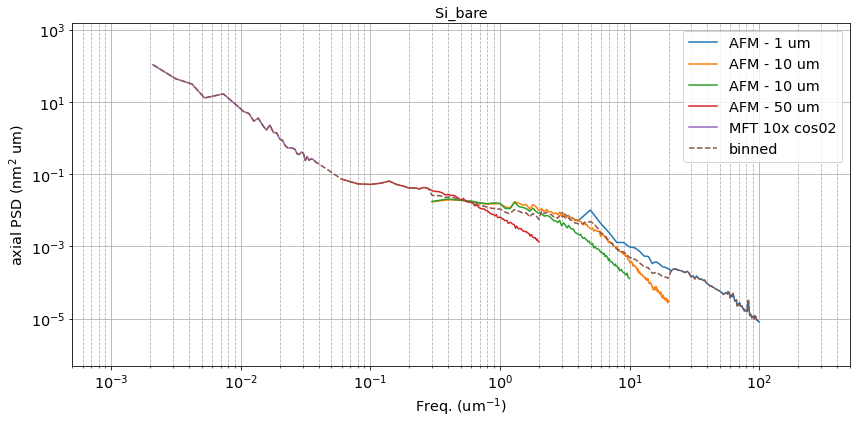

In [56]:
name = 'Si_bare'
ranges = [[2,100],[2e-1,20],[2e-1,10],[4e-2,2],None,[2e-3,4e-2],None,None,None]

tdic[name] = trim_psds_group(ranges,*datadic['bare Si plate'],xrange=xrange,yrange=yrange,
                    outname=os.path.join(outfolder,name))

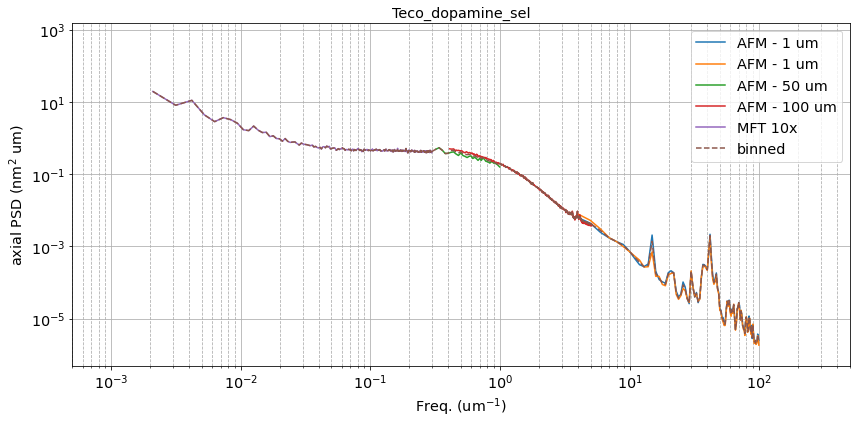

In [57]:
name = 'Teco_dopamine_sel'
ranges = [[3,100],[3,100],None,[0.3,1],[0.4,10],
          None,None,[2e-3,3e-1],None]
#ranges = [[3,100],[3,100],[2e-1,20],[4e-2,3],[1e-4,10],
#                             [2e-3,3e-1],[2e-3,3e-1],[2e-3,5e-1],[2e-3,3e-1]]
tdic[name] = trim_psds_group(ranges,*datadic['teco353 dopamine'],xrange=xrange,yrange=yrange,
                    outname=os.path.join(outfolder,name))

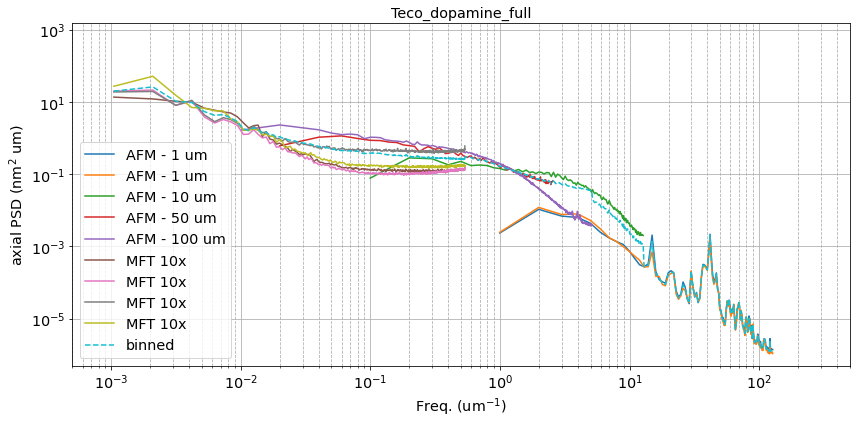

In [58]:
name = 'Teco_dopamine_full'
ranges = None

tdic[name] = trim_psds_group(ranges,*datadic['teco353 dopamine'],xrange=xrange,yrange=yrange,
                    outname=os.path.join(outfolder,name))

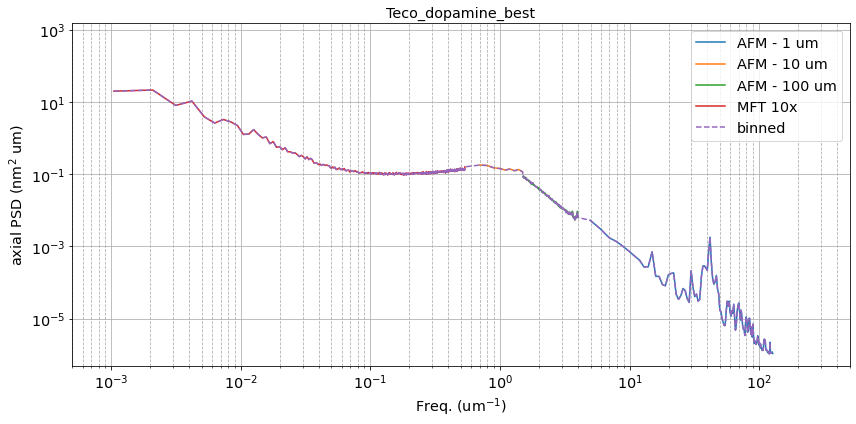

In [59]:
name = 'Teco_dopamine_best'
ranges = [None,[4,200],[6e-1,1.5],None,[1.5,4],None,[2e-4,6e-1],None,None]

tdic[name] = trim_psds_group(ranges,*datadic['teco353 dopamine'],xrange=xrange,yrange=yrange,
                    outname=os.path.join(outfolder,name))

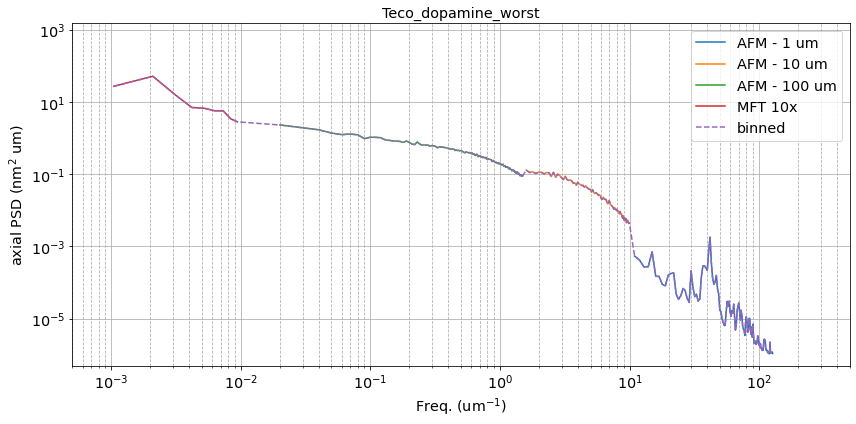

In [60]:
name = 'Teco_dopamine_worst'
ranges =[None,[10,200],[1.5,10],None,[1e-2,1.5],None,None,None,[1e-4,1e-2]]

tdic[name] = trim_psds_group(ranges,*datadic['teco353 dopamine'],xrange=xrange,yrange=yrange,
                    outname=os.path.join(outfolder,name))

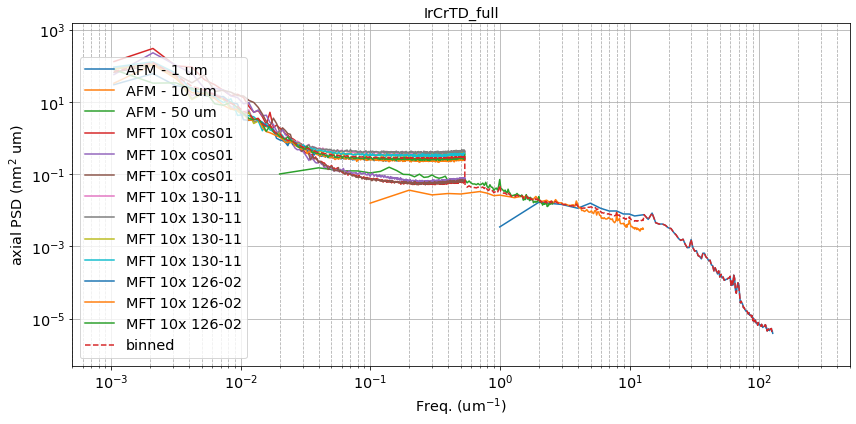

In [61]:
name = 'IrCrTD_full'
ranges =None

tdic[name] = trim_psds_group(ranges,*datadic['Cr/Ir/Cr 126-03 TD'],xrange=xrange,yrange=yrange,
                    outname=os.path.join(outfolder,name))

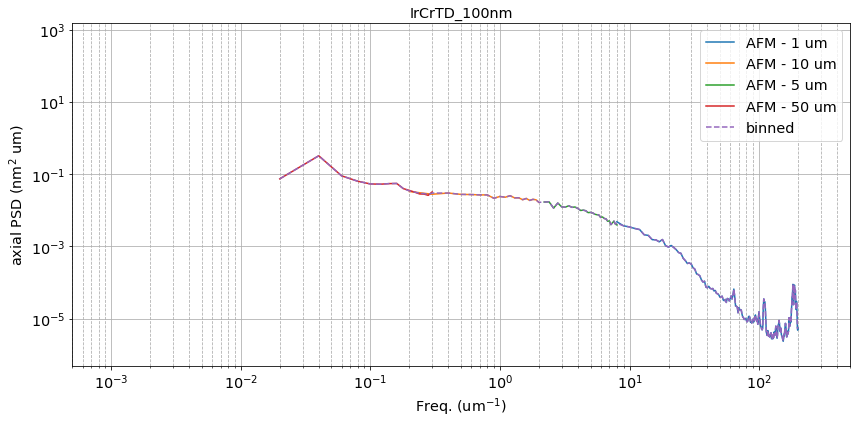

In [62]:
name = 'IrCrTD_100nm'
ranges =None
ranges =[[7,200],[0.1,2],[2,8],[1e-2,0.3]]
tdic[name] = trim_psds_group(ranges,*datadic[ 'Cr/Ir 038-10 TD first'],xrange=xrange,yrange=yrange,
                    outname=os.path.join(outfolder,name))

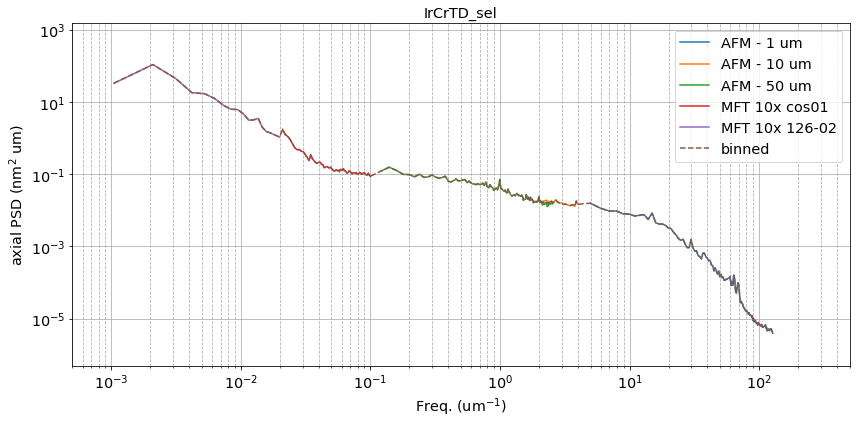

In [63]:
name = 'IrCrTD_sel'
ranges = [[4, 200], [2,4.], [0.1, 10], 
           None, [0.02,0.1],None, 
          None, None, None, 
          None, None,[5e-4,0.02], None]

tdic[name] = trim_psds_group(ranges,*datadic['Cr/Ir/Cr 126-03 TD'],xrange=xrange,yrange=yrange,
                    outname=os.path.join(outfolder,name))

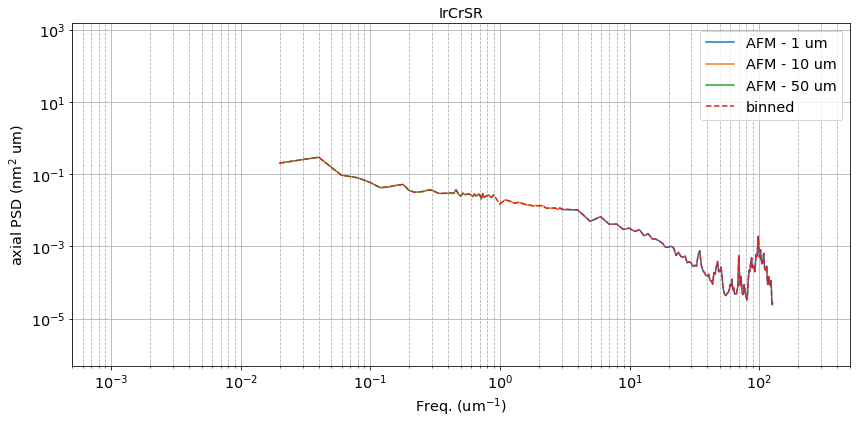

In [64]:
name = 'IrCrSR'
ranges = [[2, 200], [0.9,3.], [0.01, 0.9]]

tdic[name] = trim_psds_group(ranges,*datadic['Cr/Ir 038-03 SR'],xrange=xrange,yrange=yrange,
                    outname=os.path.join(outfolder,name))

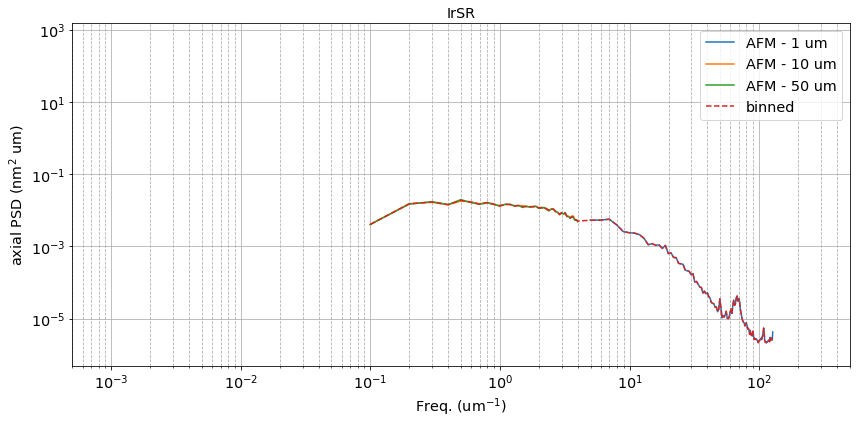

In [65]:
name = 'IrSR'
ranges = [[4, 200], [0.01,4.], [0.01, 4]]

tdic[name] = trim_psds_group(ranges,*datadic['Ir 266-06 SR'],xrange=xrange,yrange=yrange,
                    outname=os.path.join(outfolder,name))

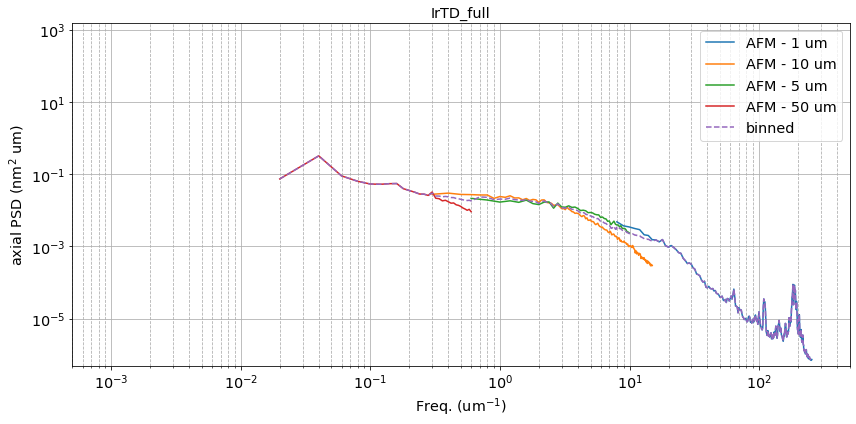

In [66]:
name = 'IrTD_full'
ranges = [[7, 300], [0.2,15.], [0.4, 10], 
          [0.01,0.6]]

tdic[name] = trim_psds_group(ranges,*datadic['Cr/Ir 038-10 TD first'],xrange=xrange,yrange=yrange,
                    outname=os.path.join(outfolder,name))

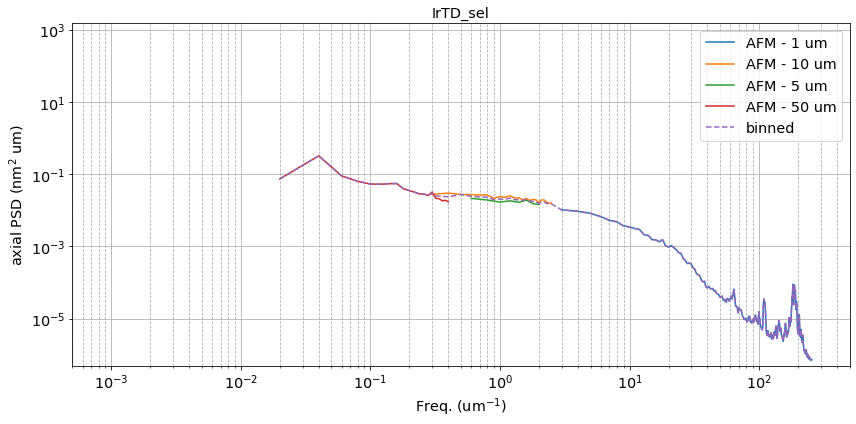

In [67]:
name = 'IrTD_sel'
ranges = [[2, 300], [0.2,2.5], [0.4, 2.],
         [0.01,0.4]]

tdic[name] = trim_psds_group(ranges,*datadic['Cr/Ir 038-10 TD first'],xrange=xrange,yrange=yrange,
                    outname=os.path.join(outfolder,name))

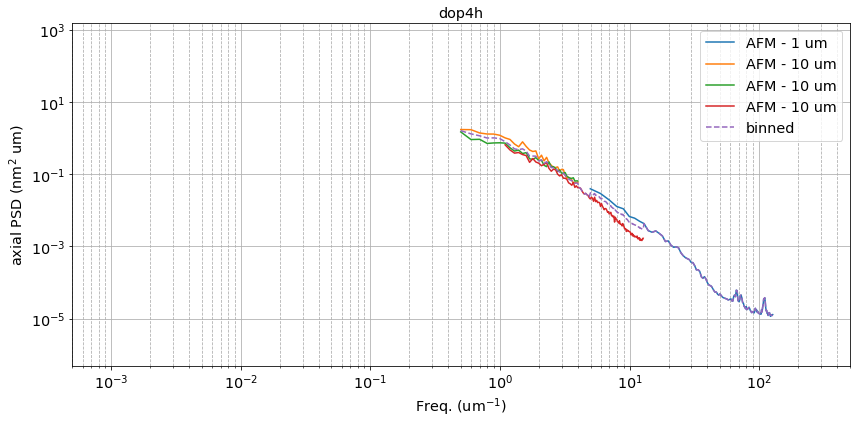

In [68]:
name = 'dop4h'
ranges = [[4, 300], [0.4,4], [0.4, 4.],
         [1,30]]

tdic[name] = trim_psds_group(ranges,*datadic['Cr/Ir/Cr Dop 4h'],xrange=xrange,yrange=yrange,
                    outname=os.path.join(outfolder,name))

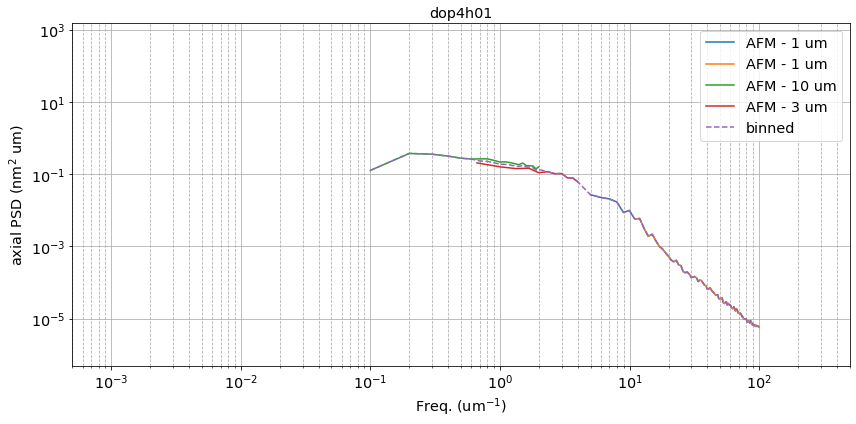

In [69]:
name = 'dop4h01'
ranges = [[4, 100], [10,100], [0.04, 2.],
         [0.4,4]]

tdic[name] = trim_psds_group(ranges,*datadic['dop4h01'],xrange=xrange,yrange=yrange,
                    outname=os.path.join(outfolder,name))

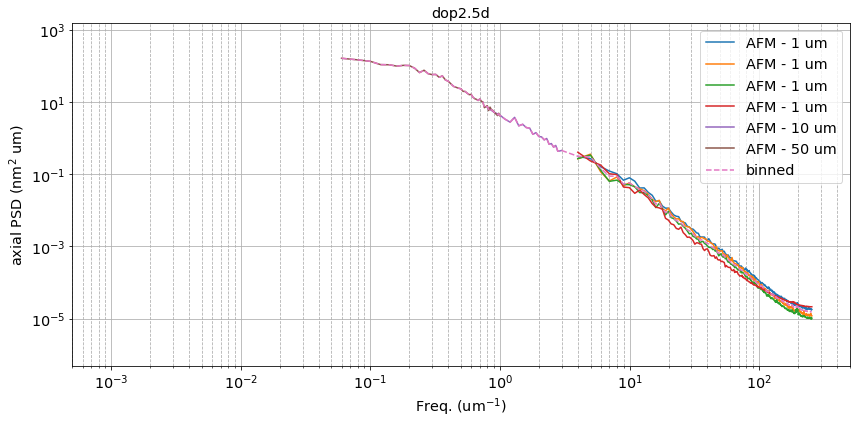

In [70]:
name = 'dop2.5d'
ranges = [[3, 300], [3,300], [3, 300],
         [3, 300], [0.7,3], [0.04, 1.]]

tdic[name] = trim_psds_group(ranges,*datadic[ 'dop2.5d'],xrange=xrange,yrange=yrange,
                    outname=os.path.join(outfolder,name))

In [71]:
outfolder


'G:\\My Drive\\progetti\\c_overcoating\\esperimenti\\results\\ICSO2020_analysis\\psds\\20210227_trim_psds'

IU scientists' math learning software gets boost from campus commercialization group_ Faculty & Staff Spotlights_ Spotlights & Profiles_ I

In [72]:
tdic.keys()

dict_keys(['Si_bare', 'Teco_dopamine_sel', 'Teco_dopamine_full', 'Teco_dopamine_best', 'Teco_dopamine_worst', 'IrCrTD_full', 'IrCrTD_100nm', 'IrCrTD_sel', 'IrCrSR', 'IrSR', 'IrTD_full', 'IrTD_sel', 'dop4h', 'dop4h01', 'dop2.5d'])

## RIEPILOGHI

Create the final PSD outputs comparing different PSDs for different keys of `tdic`.

In [ ]:
#outfolder = r'G:\My Drive\progetti\c_overcoating\esperimenti\results\20210227_all_psds'

In [73]:
# uncomment following lines to save (it is also suggested to manually make a backup to avoid 
#  accidental overwriting).

#with open(os.path.join(outdir,'tdic.pkl'), 'wb') as f:
#    pickle.dump(tdic, f, pickle.HIGHEST_PROTOCOL)

In [ ]:
datadic={}
#with open(os.path.join(outfolder,'tdic.pkl'), 'rb') as f:
#    tdic = pickle.load(f)

In [74]:
plt.close('all')

In [ ]:
plot_all_psds(datadic)  #without outfolder, doesn't save output

## Trim PSDs

 by building dictionaries in datadic format, where the data files are the ones calculated from PSD merging:

## PSDs Comparison

Plot comparison of trimmed PSD from different sources. All outputs in a single `outfolder`. Data are from a `psdfolder` containing the trimmed psd files.

In [75]:
# this is where to put comparison results
outfolder= os.path.join(outdir,r'psds\psd_comparisons')
os.makedirs(outfolder)
# this must be the outfolder where trimmed PSD were saved:
psdfolder = os.path.join(outdir,r'psds\20210227_trim_psds')


In [ ]:
xrange = [5e-4,5e2]
yrange = [5e-7,1.5e3]

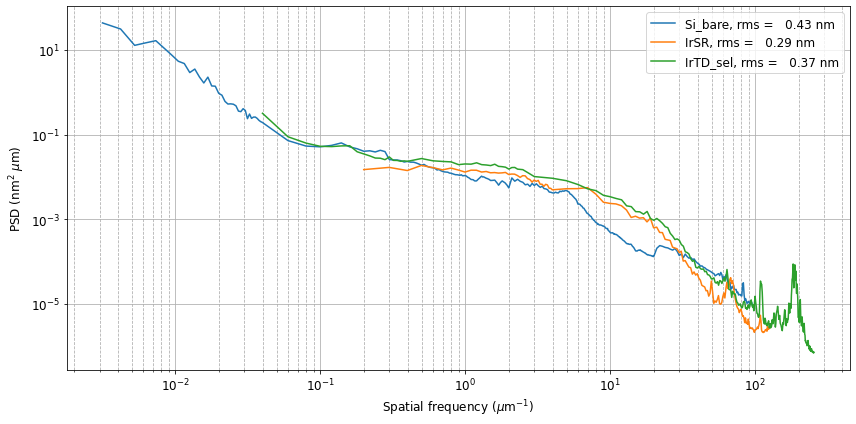

In [76]:
plotnames = [ 'Si_bare','IrSR','IrTD_sel']
psd_compare(plotnames,psdfolder)

plt.savefig(os.path.join(outfolder,'Ir.png')) 

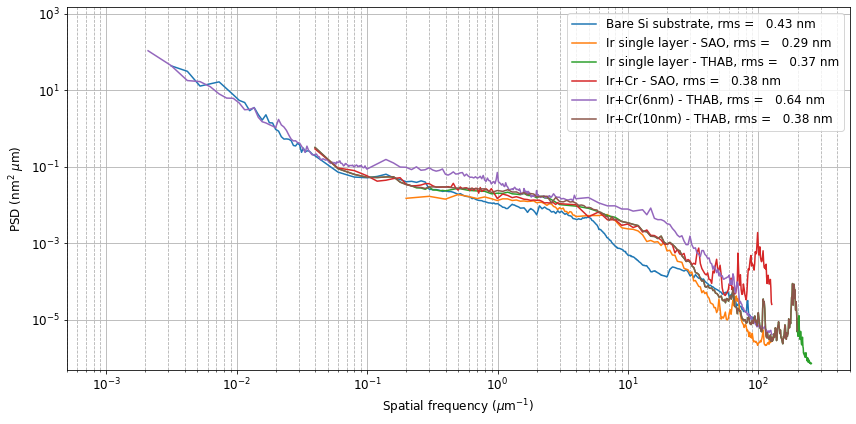

In [77]:

plotnames = [ 'Si_bare','IrSR',
             'IrTD_sel',
            'IrCrSR','IrCrTD_sel', 'IrCrTD_100nm']

labels = ['Bare Si substrate', 'Ir single layer - SAO',
          'Ir single layer - THAB', 'Ir+Cr - SAO', 
          'Ir+Cr(6nm) - THAB', 'Ir+Cr(10nm) - THAB']

psd_compare(plotnames,psdfolder, labels=labels,xrange=xrange,yrange=yrange)

plt.savefig(os.path.join(outfolder,'IrCr_all.png')) 

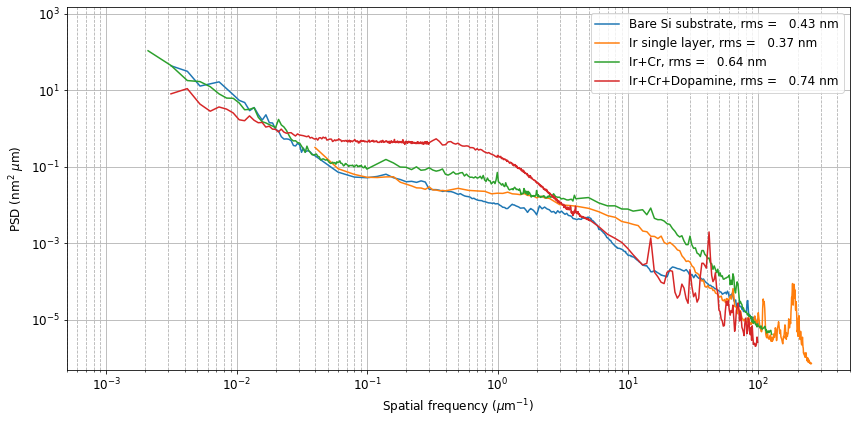

In [78]:
#ICSO2020
plotnames = [ 'Si_bare', 
            'IrTD_sel','IrCrTD_sel',
            'Teco_dopamine_sel']

labels = ['Bare Si substrate', 'Ir single layer', 'Ir+Cr', 'Ir+Cr+Dopamine']

psd_compare(plotnames,psdfolder,labels=labels,xrange=xrange,yrange=yrange)

plt.savefig(os.path.join(outfolder,'dopamine_evolve.png')) 

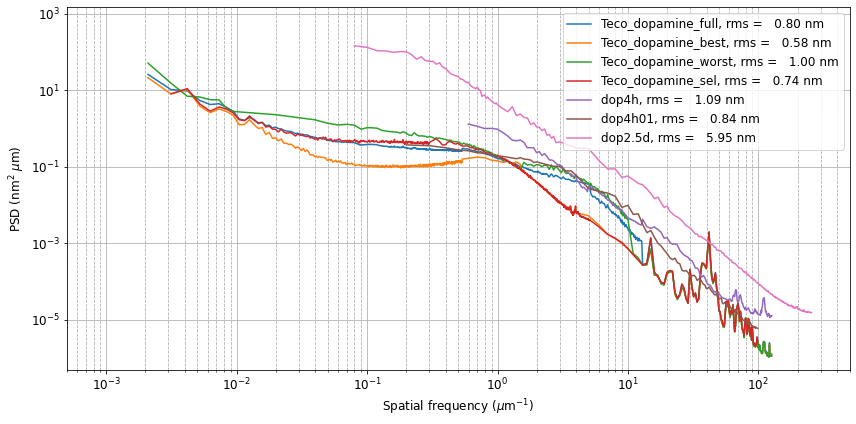

In [79]:
plotnames = [ 'Teco_dopamine_full','Teco_dopamine_best', 'Teco_dopamine_worst',
            'Teco_dopamine_sel','dop4h','dop4h01','dop2.5d']

psd_compare(plotnames,psdfolder,xrange=xrange,yrange=yrange)

plt.savefig(os.path.join(outfolder,'dopamine_all.png')) 

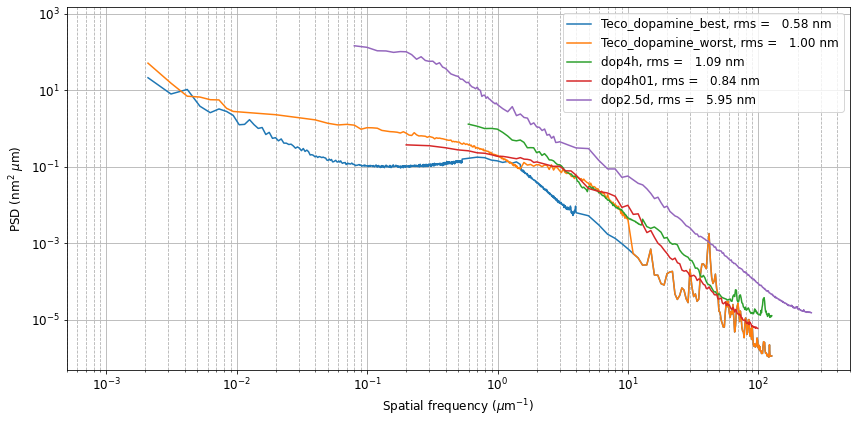

In [80]:
plotnames = [ 'Teco_dopamine_best', 'Teco_dopamine_worst',
            'dop4h','dop4h01','dop2.5d']

psd_compare(plotnames,psdfolder,xrange=xrange,yrange=yrange)

plt.savefig(os.path.join(outfolder,'dopamine_optim_all.png'))

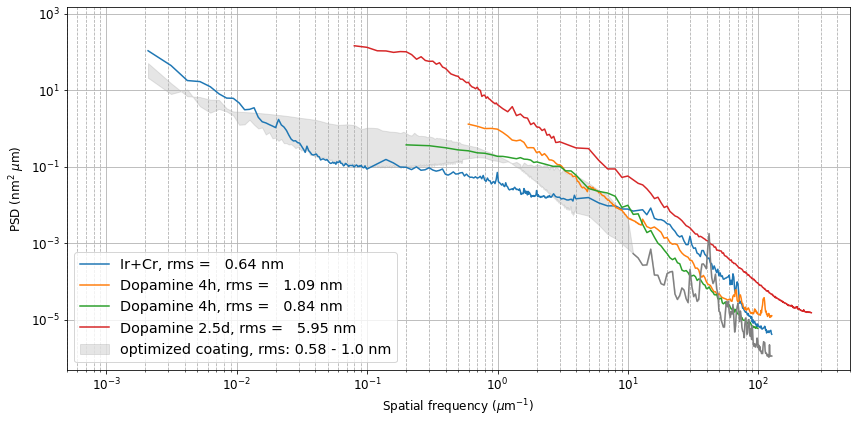

In [81]:
#ICSO2020

plotnames = ['IrCrTD_sel','dop4h','dop4h01','dop2.5d']

labels = ['Ir+Cr','Dopamine 4h','Dopamine 4h','Dopamine 2.5d']

psd_compare(plotnames,psdfolder,labels=labels,xrange=xrange,yrange=yrange)

f1,p1 =np.genfromtxt(fn_add_subfix('Teco_dopamine_best','_binpsd','.dat',pre=psdfolder+os.path.sep), unpack=True,skip_header=1)
f2,p2 =np.genfromtxt(fn_add_subfix('Teco_dopamine_worst','_binpsd','.dat',pre=psdfolder+os.path.sep), unpack=True,skip_header=1)

p2 = np.interp(f1,f2,p2)

plt.fill_between(f1,p1,p2,color='gray',alpha=0.2,label = 'optimized coating, rms: 0.58 - 1.0 nm')
plt.plot(*crop_profile(f1,p2,[10.9468,None]),color='gray')
plt.legend(loc=0)
plt.savefig(os.path.join(outfolder,'dopamine_optim.png'))

In [82]:
plt.close('all')